# Trabalho de Conclusão de Curso

Título: Classificação de Textos Escolares com Aprendizado de Máquina e Lógica Fuzzy: Análise Preditiva baseada em Processamento de Linguagem Natural e Inteligência Artificial

Curso: Especialização em Ciência de Dados

Instituição: Universidade Federal Tecnológica do Paraná - Campus Dois Vizinhos

Aluno: Nelson Jacob Dressler

Orientador: Prof. Dr. Rafael Gomes Mantovani

## [MMACD] Solução 1: Aprendizado de Máquina (AM)

### Pipelines de Machine Learning

<p align="center">
  <img src="Imagens/diagrama_solucao_ml.png" />
</p>

### Esquema de Holdout Externo com Validação Cruzada Interna

<p align="center">
  <img src="Imagens/diagrama_holdout_cv.png" />
</p>

### Estrutura da Busca Aleatória

<p align="center">
  <img src="Imagens/diagrama_randomized_search.png" />
</p>

### Importação das Bibliotecas

In [1]:
# Instalando as bibliotecas necessárias
!pip install unidecode
!pip install nltk
!pip install wordcloud
!pip install sklearn
!pip install scikit-fuzzy

In [2]:
# Baixando as listas de stopwords da biblioteca NLTK
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/nelsondressler/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [3]:
# Importando bibliotecas de uso geral
import os
import sys
import io
import random
import zipfile
import warnings
import re
from unidecode import unidecode

# Importando bibliotecas de manipulação e visualização de dados
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Importando bibliotecas de técnicas de selação de modelos (holdout e busca aleatória)
from sklearn.model_selection import train_test_split, KFold, cross_val_score, RandomizedSearchCV

# Importando bibliotecas de técnicas de pré-processamento, extração e seleção de características e redução de dimensionalidade
from sklearn.preprocessing import LabelEncoder, KBinsDiscretizer, FunctionTransformer
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, TfidfTransformer
from sklearn.feature_selection import SelectKBest, chi2, f_classif, mutual_info_classif

# Importando bibliotecas de classificação
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB, BernoulliNB
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier, export_graphviz, plot_tree, export_text
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier

# Importando biblioteca de estruturação de etapas de análise preditiva
from sklearn.pipeline import Pipeline

# Importando biblioteca de métricas de desempenho de técnicas de machine learning
from sklearn.metrics import confusion_matrix, classification_report, balanced_accuracy_score

# Importando bibliotecas de manipulação de processamento de linguagem natural
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.stem.snowball import PortugueseStemmer, PorterStemmer
from wordcloud import WordCloud

# Importando bibliotecas específicas ao Google Colab
try:
    from google.colab import files, drive
    import google.colab
    drive.mount('/content/drive')
    IN_COLAB = True
except:
    IN_COLAB = False

In [4]:
# Definindo as constantes utilizadas ao longo da análise

SEED = 42 # semente aleatória para os experimentos
FRAC_DATA = 1 # fração dos dados originais a ser obtida

### Abertura dos Dados

In [5]:
sh = """
FILE=/content/drive/MyDrive/'Area de Trabalho'/'ECD - UTFPR-DV'/TCC/corpus_readability_nlp_portuguese-master.zip
if test -f "$FILE"; then
    echo "$FILE exists."
    cp /content/drive/MyDrive/'Area de Trabalho'/'ECD - UTFPR-DV'/TCC/corpus_readability_nlp_portuguese-master.zip /content/
else
    echo "$FILE not exists."
fi
"""
with open('copy_zip_local.sh', 'w') as file:
  file.write(sh)

!bash copy_zip_local.sh

/content/drive/MyDrive/Area de Trabalho/ECD - UTFPR-DV/TCC/corpus_readability_nlp_portuguese-master.zip not exists.


In [6]:
# Submetendo os arquivos de texto do dataset no Google Colab
# Dados obtidos a partir de: https://github.com/gazzola/corpus_readability_nlp_portuguese
if not os.path.isfile('corpus_readability_nlp_portuguese-master.zip') and IN_COLAB:
    uploaded = files.upload()

In [7]:
# Obtendo o caminho dos dados
caminho_projeto = os.getcwd()
caminho_dados = os.path.join(caminho_projeto, 'corpus_readability_nlp_portuguese-master.zip')

# Abrindo o arquivo zipado e salvando os respectivos conteúdos e disciplinas
conteudos = []
graus = []
caminhos = []
with zipfile.ZipFile(caminho_dados) as arquivos_zip:
    universo_escolaridade = [os.path.basename(os.path.normpath(arquivo)) for arquivo in arquivos_zip.namelist() if arquivo.endswith('/') and re.search(r'\d+', arquivo)]

    nomes_arquivos = [
        (grau, caminho_arquivo)
        for grau in universo_escolaridade
        for caminho_arquivo in arquivos_zip.namelist()
        if grau in caminho_arquivo and '.txt' in caminho_arquivo and not '._' in caminho_arquivo
    ]
    for grau, caminho_arquivo in nomes_arquivos:
        arquivo_zip = arquivos_zip.open(caminho_arquivo)
        conteudos.append(arquivo_zip.read().decode('utf-8', errors='ignore'))
        graus.append(grau)
        caminhos.append(caminho_arquivo)

In [8]:
# Salvando os conteúdos e disciplinas num dicionário
dict_textos_escolares = {
    'caminho': caminhos,
    'conteudo_original': conteudos,
    'classe': graus
}

# Criando um dataframe a partir do dicionário
df_textos_escolares = pd.DataFrame(dict_textos_escolares)

In [9]:
# Retirando uma amostra dos dados para fins de teste
np.random.seed(SEED)
# df_textos_escolares = df_textos_escolares.groupby('classe', group_keys=False).apply(pd.DataFrame.sample, n=50)
df_textos_escolares = df_textos_escolares.groupby('classe', group_keys=False).apply(pd.DataFrame.sample, frac=FRAC_DATA)

df_textos_escolares

,caminho,conteudo_original,classe
167,corpus_readability_nlp_portuguese-master/1_Ens...,"Você pode começar pelos mais conhecidos, como...",1_Ensino_Fundamental_I
211,corpus_readability_nlp_portuguese-master/1_Ens...,"Por isso, nunca use pedaços de radiografias, ...",1_Ensino_Fundamental_I
63,corpus_readability_nlp_portuguese-master/1_Ens...,Isso resultou também em mudanças na sua estru...,1_Ensino_Fundamental_I
154,corpus_readability_nlp_portuguese-master/1_Ens...,﻿Você já viajou de avião? Já olhou pela janeli...,1_Ensino_Fundamental_I
5,corpus_readability_nlp_portuguese-master/1_Ens...,Essa bactéria fica grudadinha com muitas outr...,1_Ensino_Fundamental_I
...,...,...,...
1749,corpus_readability_nlp_portuguese-master/4_Ens...,Num armazém a tábuas de ligação transversal d...,4_Ensino_Superior
1302,corpus_readability_nlp_portuguese-master/4_Ens...,Mecânica dos fluidos/Exercícios resolvidos/C5\...,4_Ensino_Superior
1475,corpus_readability_nlp_portuguese-master/4_Ens...,Otimização/Índice remissivo\nNesta página estã...,4_Ensino_Superior
1983,corpus_readability_nlp_portuguese-master/4_Ens...,Esse recurso possibilita a implementação efic...,4_Ensino_Superior


### Análise Exploratória de Dados (EDA)

In [10]:
# Apresentando uma amostra dos dados
df_textos_escolares.head()

,caminho,conteudo_original,classe
167,corpus_readability_nlp_portuguese-master/1_Ens...,"Você pode começar pelos mais conhecidos, como...",1_Ensino_Fundamental_I
211,corpus_readability_nlp_portuguese-master/1_Ens...,"Por isso, nunca use pedaços de radiografias, ...",1_Ensino_Fundamental_I
63,corpus_readability_nlp_portuguese-master/1_Ens...,Isso resultou também em mudanças na sua estru...,1_Ensino_Fundamental_I
154,corpus_readability_nlp_portuguese-master/1_Ens...,﻿Você já viajou de avião? Já olhou pela janeli...,1_Ensino_Fundamental_I
5,corpus_readability_nlp_portuguese-master/1_Ens...,Essa bactéria fica grudadinha com muitas outr...,1_Ensino_Fundamental_I


In [11]:
# Apresentando as dimensões do dataset
df_textos_escolares.shape

(2076, 3)

In [12]:
# Apresentando as informações das colunas (nome, quantidade de valores não nulos, tipos)
df_textos_escolares.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2076 entries, 167 to 1505
Data columns (total 3 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   caminho            2076 non-null   object
 1   conteudo_original  2076 non-null   object
 2   classe             2076 non-null   object
dtypes: object(3)
memory usage: 64.9+ KB


In [13]:
# Apresentando as quantidades de registros por classe
df_textos_escolares['classe'].value_counts()

4_Ensino_Superior          826
3_Ensino_Medio             628
2_Ensino_Fundamental_II    325
1_Ensino_Fundamental_I     297
Name: classe, dtype: int64

In [14]:
# Apresentando as porcentagens de registros por classe
df_textos_escolares['classe'].value_counts(normalize=True)

4_Ensino_Superior          0.397881
3_Ensino_Medio             0.302505
2_Ensino_Fundamental_II    0.156551
1_Ensino_Fundamental_I     0.143064
Name: classe, dtype: float64

/var/folders/ry/5_t3tj853q77d7gln0s8m4040000gn/T/ipykernel_2165/265242236.py:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks().astype(int), size=20)


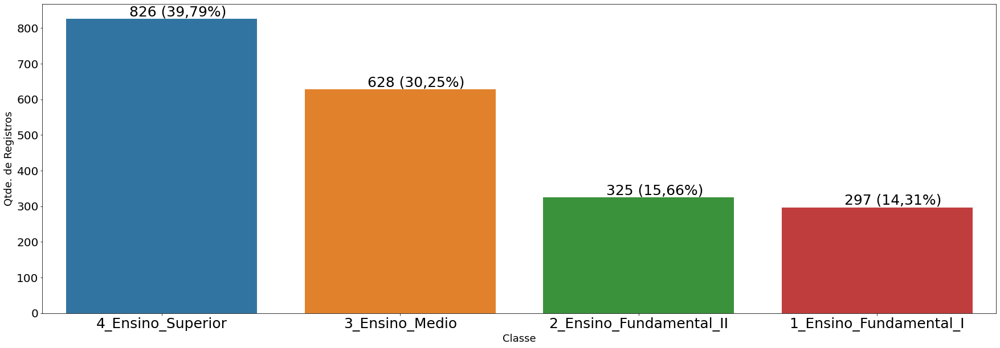

In [15]:
# Apresentando a proporção e balanceamento entre classes
plt.figure(figsize=(30, 10))

total = df_textos_escolares.shape[0]
labels = ['{:10d} ({:,.2%})'.format(x, x / total).replace('.', ',') for x in df_textos_escolares['classe'].value_counts()]
# labels = [x for x in df_textos_escolares['classe'].value_counts()]

ax = sns.countplot(x='classe', data=df_textos_escolares, order=df_textos_escolares['classe'].value_counts().index)
ax.bar_label(ax.containers[0], labels=labels, size=25)

# for p in ax.patches:
#     label = '{:1d} ({:.2f}%)'.format(p.get_height(), 100 * p.get_height() / total)
#     x = (p.get_x() + (p.get_width() / 2))
#     y = p.get_height() + 10
#     ax.annotate(label, (x, y), ha='center', size=15)    

ax.set_xticklabels(df_textos_escolares['classe'].value_counts().index, size=25)
ax.set_yticklabels(ax.get_yticks().astype(int), size=20)

plt.ylabel('Qtde. de Registros', size=18)
plt.xlabel('Classe', size=18)
plt.show()

In [16]:
re_quebras = r'\r|\t|\n|\d'
re_caracteres_especiais = r'[^A-Za-z\s]+'
re_palavra_pequena = r'\W*\b\w{1,3}\b'
re_multiplos_espacos = r'\s+'

# Removendo caracteres desnecessários (quebras de linha, tabs, caracteres especiais, pontuações, espaços, acentos, etc) e palavras abaixo de quatro letras
df_textos_escolares['data'] = df_textos_escolares['conteudo_original']\
    .apply(lambda x : unidecode(x).lower())\
    .replace(re_quebras, ' ', regex=True)\
    .replace(re_caracteres_especiais, ' ', regex=True)\
    .replace(re_palavra_pequena, ' ', regex=True)\
    .replace(re_multiplos_espacos, ' ', regex=True)\
    .str.strip()

In [17]:
df_textos_escolares['qtd_palavras'] = df_textos_escolares['data'].str.split().str.len()

In [18]:
df_textos_escolares['qtd_palavras'].describe()

count    2076.000000
mean      233.613198
std        57.300327
min       134.000000
25%       193.000000
50%       212.000000
75%       261.000000
max       632.000000
Name: qtd_palavras, dtype: float64

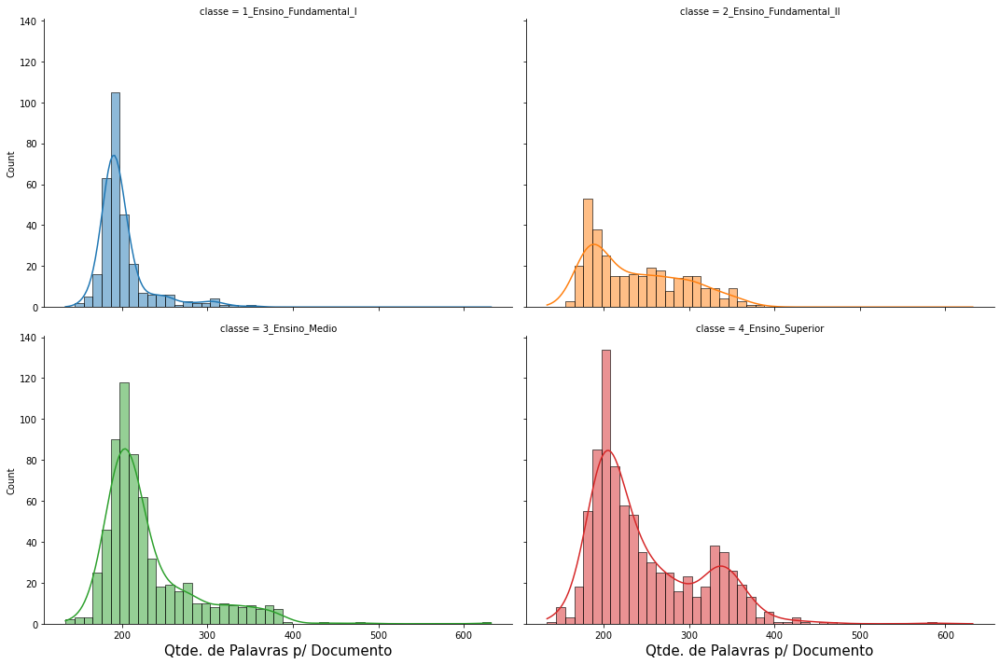

In [19]:
# Apresentando a distribuição de palavras por documento entre classes antes do descarte de palavras vazias
ax = sns.displot(data=df_textos_escolares, x='qtd_palavras', hue='classe', col='classe', col_wrap=2, multiple="stack", kde=True, legend=False)
ax.fig.set_figwidth(15)
ax.fig.set_figheight(10)
ax.set_xlabels('Qtde. de Palavras p/ Documento', size=15)
# ax.set_ylabels('Qtde. de Registros', size=15)
plt.tight_layout()
plt.show()

In [20]:
# Criando um conversor de dados categóricos para dados numéricos para as classes
encoder = LabelEncoder()

# Transformando os dados categóricos das classes em numéricos
df_textos_escolares['target'] = encoder.fit_transform(df_textos_escolares['classe'])

# Obtendo um dicionário de índices e classes
target_map = dict(enumerate(encoder.classes_))

target_map

{0: '1_Ensino_Fundamental_I',
 1: '2_Ensino_Fundamental_II',
 2: '3_Ensino_Medio',
 3: '4_Ensino_Superior'}

In [21]:
classes = list(target_map.values())

classes

['1_Ensino_Fundamental_I',
 '2_Ensino_Fundamental_II',
 '3_Ensino_Medio',
 '4_Ensino_Superior']

In [22]:
# Obtendo os conteúdo limpos de cada classe num array do numpy 
X_classes = []
for classe in classes:
    X_classe = df_textos_escolares[df_textos_escolares['classe'] == classe]['data'].values
    X_classes.append(X_classe)

In [23]:
X_classes_gen = (x for x in X_classes)

X_classes_gen

<generator object <genexpr> at 0x7fee318eec10>

In [24]:
# Apresentando um exemplo de texto no grau 1_Ensino_Fundamental_I
pd.DataFrame(next(X_classes_gen)).sample(random_state=SEED).iloc[0, 0]

'isso ajudar fazer escolhas tirar conclusoes desenvolver novas ideias concentrar mais encontrar solucoes momentos importantes vida carteiros pediram mais seguranca para entregar cartas eles reclamam muitas pessoas deixam caes soltos proximos caixa correspondencia correndo risco atacarem bracos deles alem disso algumas casas carteiros dizem portoes ficam abertos permitindo cachorros ataquem maioria vezes brabo brinca criancas casa trata desconhecidos isso ajude seus pais trancar mascote para proteger nossos amigos carteiros protesto deles ocorreu porque dias carteiro atacado pitbulls ficando machucado pernas bracos barriga lideres paises reunidos bali indonesia tentam diminuir emissao gases poluentes liberados pelas industrias pela circulacao veiculos principalmente para melhorar condicoes clima terra esses gases provocam aumento temperatura todo planeta problemas mais graves devera ocorrer segundo estudos geleiras artico poderao derreter para esse outros desequilibrios como aumento niv

In [25]:
# Apresentando um exemplo de texto no grau 2_Ensino_Fundamental_II
pd.DataFrame(next(X_classes_gen)).sample(random_state=SEED).iloc[0, 0]

'sociologia processo estudo sociedade sociologia preocupa serie aspectos influenciam existencia agrupamentos sujeitos sociais esses aspectos melhor dizendo mecanismos caracteristicas especificas grupo social servem como ponto apoio para coesao seus diferentes integrantes entre diferentes mecanismos sustentacao grupo social destacaremos alguns pelo grau influencia exercem sobre grupo seus integrantes precisamos levar consideracao antes tudo sujeitos integram grupo social estao amarrados fatalmente condenados submeterem esses mecanismos possuem individualidade capacidade ainda fortes ameacas sancoes negativas como veremos escolher criar meio convivencia acordo suas necessidades desejos lideranca possivelmente maiores catalizadores mobilizacoes sociais podemos observar debaixo lideranca grupos sociais organizam diante ideal comum nome resolucao varios problemas qualquer outro tipo acao autor alemao weber dedicou estudar formas dominacao sociedade democratica consequentemente formas como l

In [26]:
# Apresentando um exemplo de texto no grau 3_Ensino_Medio
pd.DataFrame(next(X_classes_gen)).sample(random_state=SEED).iloc[0, 0]

'prolongamentos direcao interior celula prendem membrana plasmatica placa desmossoma prolongamentos para meio extracelular ligam fibras desmossoma celula vizinha moleculas caderinas desmocolina desmogleina celula ligam caderinas celula vizinha atraves ligacao homofilica seja ligam moleculas mesmo tipo vindas celula adjacente exemplo desmocolina desmocolina desmogleina desmogleina ligacao dessas moleculas depende concentracao ions meio extracelular caso esteja baixa concentracao caderinas mudam conformacao causando ruptura ligacao consequentemente separacao celulas pelo fato garantir adesao forte celula celula desmossomas deixam camada celular mais rigida resistente estavel sendo isso encontrados grande quantidade tecidos epiteliais submetidos constante tracao atrito como exemplo pele mucosa revestimento lingua estomago tambem encontrados celulas musculo cardiaco membranas meninges revestem cerebro medula espinhal celulas sofrem transformacao maligna celulas cancerosas desmossomas apare

In [27]:
# Apresentando um exemplo de texto no grau 4_Ensino_Superior
pd.DataFrame(next(X_classes_gen)).sample(random_state=SEED).iloc[0, 0]

'logistica gestao armazens picking organizacao actividade picking actividade separacao preparacao pedidos grande intensidade termos movimentacao materiais dependendo tipo armazem cerca custo total desse armazem esta directamente associado essa mesma actividade situacao verifica pois tempo associado essa actividade numero trabalhadores maiores outras actividades armazenagem atraves estudos sistemas separacao pedidos mais usuais onde temos grande utilizacao operacoes deslocamento recolha produtos documentos papel obtemos informacoes como tempo operador nessa actividade gasto medeiros objectivo fundamental para produtividade sistema separacao pedidos minimizacao tempos deslocamento movimentacao observamos utilizacao tempo parte operador actividade picking verifica grande parte tempo gasto pelos operadores encontra movimentacao para recolha colocacao produtos linha picking maneira como organizamos estrategia picking esta directamente associada tempo deslocamento estrategia picking entendem

In [28]:
# Criando uma função de plotagem de nuvem de palavras
def plot_cloud(wordcloud):
    # Set figure size
    plt.figure(figsize=(40, 30))
    # Display image
    plt.imshow(wordcloud) 
    # No axis details
    plt.axis("off")

In [29]:
# Obtendo a lista stopwords do idioma português 
# stopwords_pt_br = stopwords.words('portuguese')
stopwords_pt_br = [unidecode(x) for x in stopwords.words('portuguese')]
# Definindo a função de stemização
portuguese_stemmer = PortugueseStemmer()
porter_stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()
# Criando uma função no analisador do vetorizador do scikit-learn
analyzer = CountVectorizer().build_analyzer()

# Criando a função de stemização a ser utilizada
def stemed_words(doc):
    return (lemmatizer.lemmatize(w, pos="v") for w in analyzer(doc))

In [30]:
X_classes_gen = (x for x in X_classes)

X_classes_gen

<generator object <genexpr> at 0x7fee40d67430>

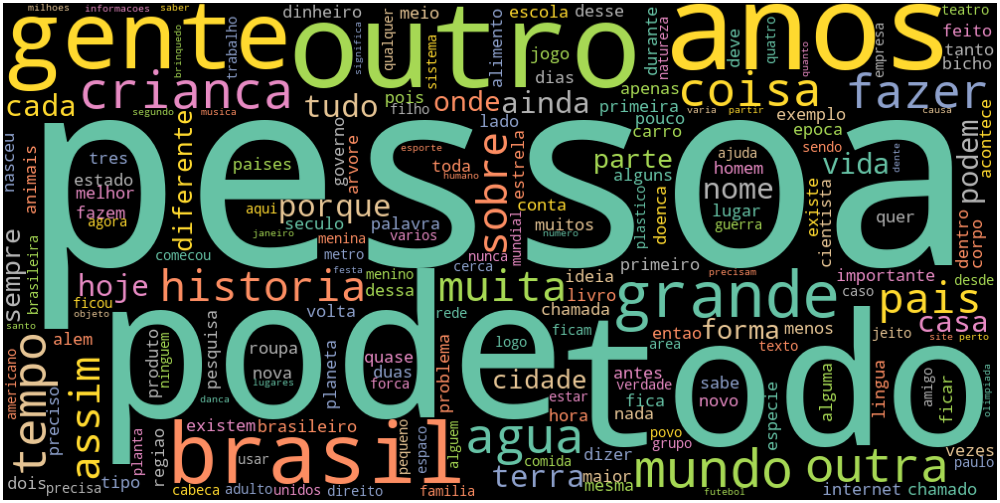

In [31]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 1_Ensino_Fundamental_I
wordcloud_fundamental1 = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    stopwords=stopwords_pt_br
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_fundamental1)

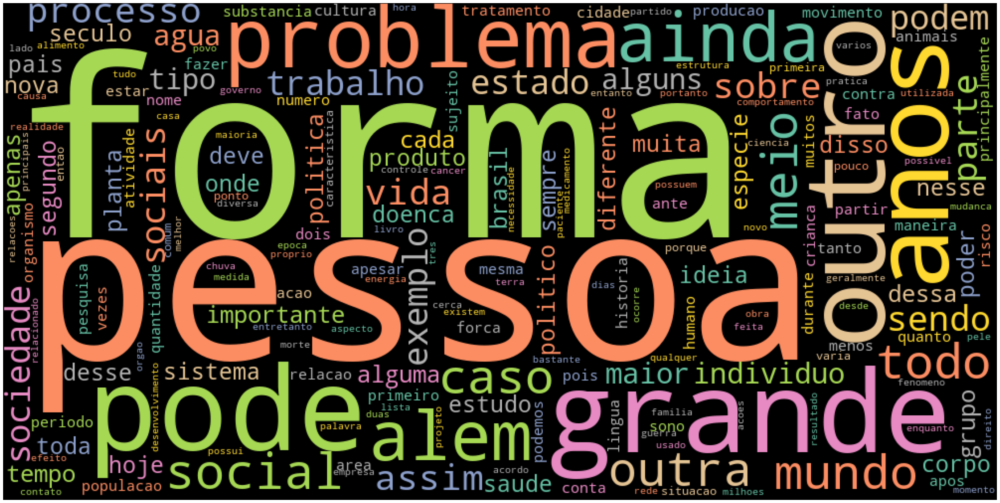

In [32]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 2_Ensino_Fundamental_II
wordcloud_fundamental2 = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    stopwords=stopwords_pt_br
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_fundamental2)

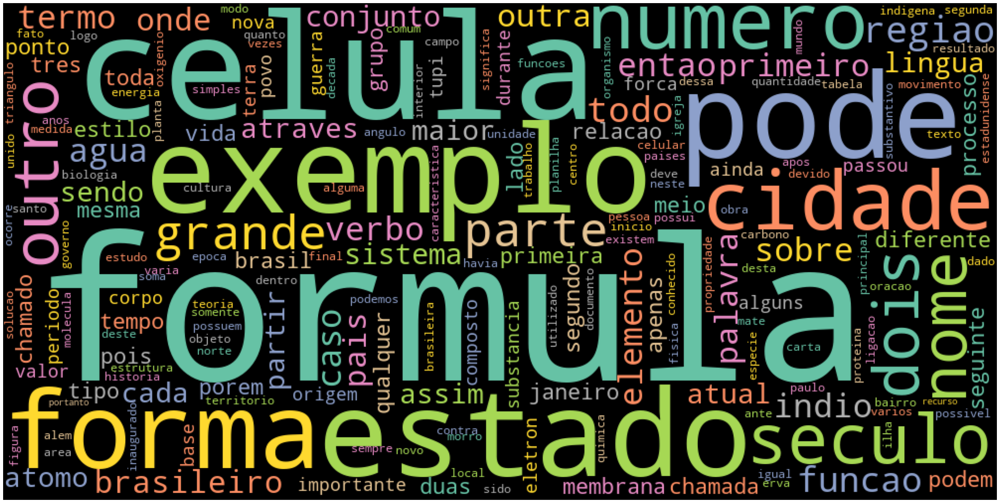

In [33]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 3_Ensino_Medio
wordcloud_medio = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    stopwords=stopwords_pt_br
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_medio)

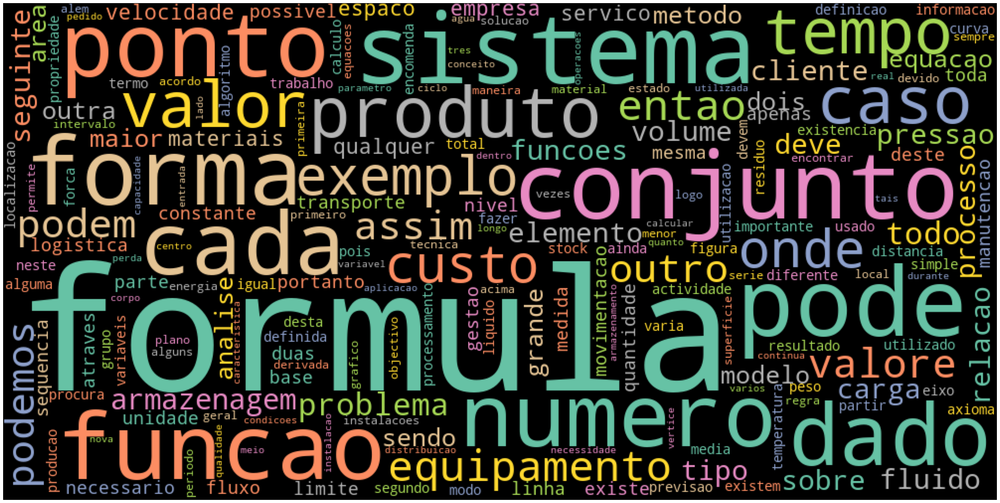

In [34]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 4_Ensino_Superior
wordcloud_superior = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    stopwords=stopwords_pt_br
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_superior)

In [35]:
termos_irrelevantes = [
    'abaixo',
    'acima',
    'acordo',
    'ainda',
    'alem',
    'alguem',
    'algum',
    'alguma',
    'algumas',
    'alguns',
    'anterior',
    'antes',
    'apenas',
    'aquela',
    'aquelas',
    'aquele',
    'aqueles',
    'aqui',
    'aquilo',
    'assim',
    'atraves',
    'atual',
    'atualmente',
    'baixa',
    'baixo',
    'bem',
    'cada',
    'caso',
    'cima',
    'cinco',
    'coisa',
    'coisas',
    'conta',
    'dado',
    'define',
    'definem',
    'definicao',
    'definida',
    'definidas',
    'definido',
    'definidos'
    'definir',
    'depois',
    'desde',
    'deste',
    'destes',
    'desta',
    'destas',
    'desse',
    'desses',
    'dessa',
    'dessas',
    'deve',
    'devem',
    'dez',
    'diagrama',
    'disso',
    'dois',
    'duas',
    'durante',
    'ela',
    'elas',
    'ele',
    'eles',
    'enquanto',
    'entao',
    'entretanto',
    'este',
    'estes',
    'esta',
    'estas',
    'estao',
    'esse',
    'esses',
    'essa',
    'essas',
    'eu',
    'esta',
    'estando',
    'estao',
    'estar',
    'estava',
    'estavam',
    'exemplo',
    'explicacao',
    'fato',
    'faz',
    'fazem',
    'fazer',
    'feito',
    'fica',
    'ficam',
    'ficado',
    'ficando',
    'ficar',
    'figura',
    'forma',
    'gente',
    'geral',
    'geralmente',
    'grande',
    'grandes',
    'hoje',
    'imagem',
    'isto',
    'isso',
    'lado',
    'logo',
    'mal',
    'meio',
    'mesma',
    'mesmas',
    'mesmo',
    'mesmos',
    'muita',
    'muitas',
    'muito',
    'muitos',
    'mundo',
    'nada',
    'nao',
    'necessaria',
    'necessariamente',
    'necessarias',
    'necessario',
    'necessarios',
    'nessa',
    'nessas',
    'nesse',
    'nesses',
    'nesta',
    'nestas',
    'neste',
    'nestes',
    'nos',
    'nove',
    'nunca',
    'oito',
    'outra',
    'outras',
    'onde',
    'outro',
    'outros',
    'parte',
    'partir',
    'pequena',
    'pequenas',
    'pequeno',
    'pequenos',
    'permite',
    'permitem',
    'permitindo',
    'permitir',
    'pessoa',
    'pessoas',
    'pode',
    'podem',
    'podemos',
    'podendo',
    'pois',
    'por',
    'porem',
    'porque',
    'pouca',
    'poucas',
    'pouco',
    'poucos',
    'primeira',
    'primeiras',
    'primeiro',
    'primeiros',
    'qualquer',
    'quase',
    'quando',
    'quanto',
    'quatro',
    'que',
    'sao',
    'seguinte',
    'segundo',
    'seis',
    'sempre',
    'sendo',
    'ser',
    'sera',
    'serao',
    'serem',
    'serie',
    'sete',
    'sido',
    'sim',
    'somente',
    'sobre',
    'tabela',
    'tais',
    'talvez',
    'tambem',
    'tanto',
    'tal',
    'ter',
    'tem',
    'tendo',
    'tido',
    'toda',
    'todas',
    'todo',
    'todos',
    'tudo',
    'tres',
    'tu',
    'um',
    'uma',
    'umas',
    'uns',
    'usa',
    'usam',
    'usando',
    'usar',
    'utiliza',
    'utilizam',
    'utilizando',
    'utilizar',
    'vai',
    'varias',
    'varios',
    'vez',
    'vezes',
    'voce',
    'voces',
    'vos',
    'vossa',
    'vossas',
    'vou'
 ]

In [36]:
df_textos_escolares['qtd_palavras_processadas'] = df_textos_escolares['data'].str.split().apply(lambda lista: set(lista) - set(stopwords_pt_br + termos_irrelevantes)).str.len()

In [37]:
df_textos_escolares['qtd_palavras_processadas'].describe()

count    2076.000000
mean      128.587187
std        35.136616
min        38.000000
25%       105.000000
50%       124.000000
75%       146.000000
max       331.000000
Name: qtd_palavras_processadas, dtype: float64

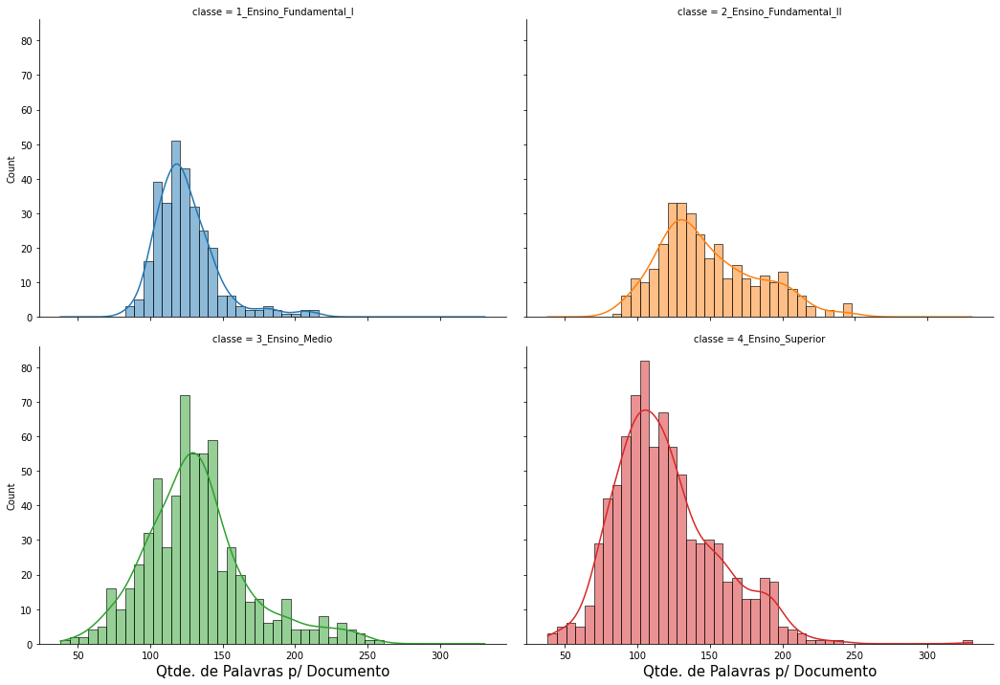

In [38]:
# Apresentando a distribuição de palavras por documento entre classes após do descarte de palavras vazias
ax = sns.displot(data=df_textos_escolares, x='qtd_palavras_processadas', hue='classe', col='classe', col_wrap=2, multiple="stack", kde=True, legend=False)
ax.fig.set_figwidth(15)
ax.fig.set_figheight(10)

ax.set_xlabels('Qtde. de Palavras p/ Documento', size=15)
# ax.set_ylabels('Qtde. de Registros', size=15)
plt.show()

In [39]:
X_classes_gen = (x for x in X_classes)

X_classes_gen

<generator object <genexpr> at 0x7fee41856040>

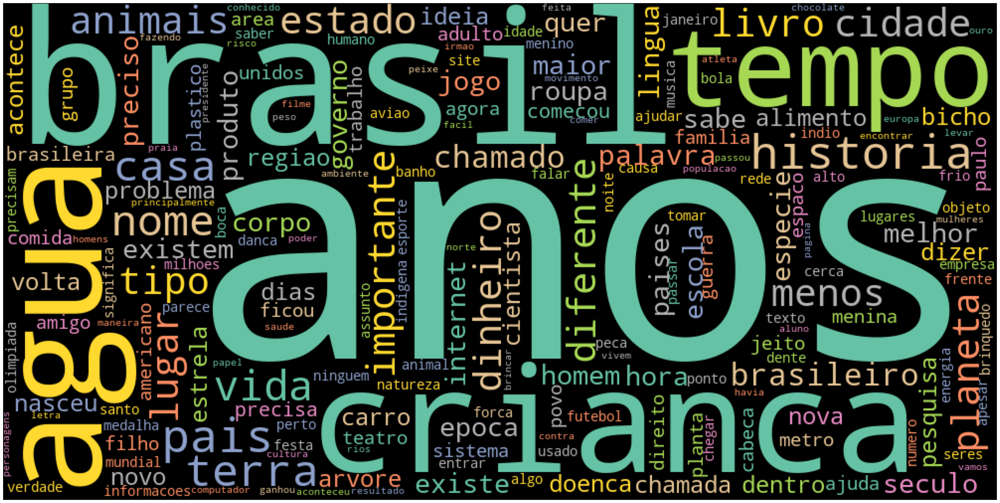

In [40]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 1_Ensino_Fundamental_I
wordcloud_fundamental1 = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    stopwords=stopwords_pt_br + termos_irrelevantes
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_fundamental1)

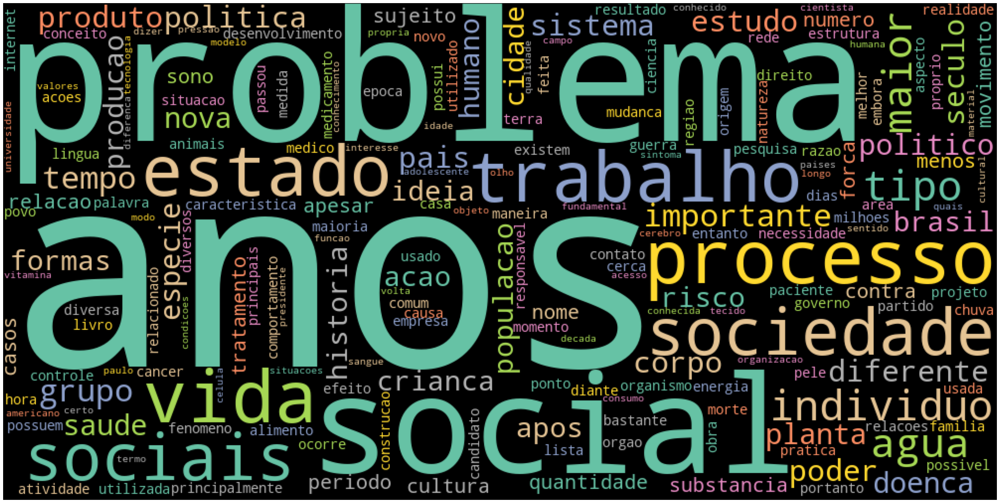

In [41]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 2_Ensino_Fundamental_II
wordcloud_fundamental2 = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    stopwords=stopwords_pt_br + termos_irrelevantes
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_fundamental2)

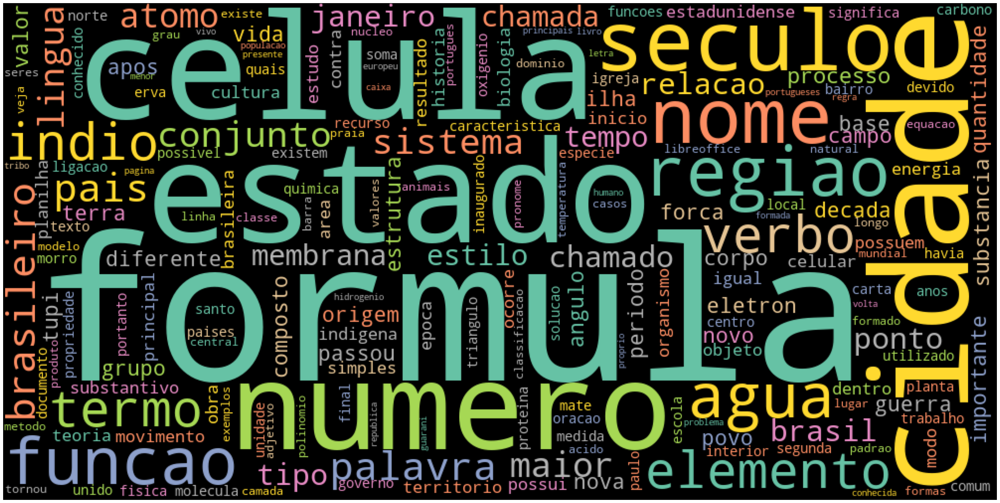

In [42]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 3_Ensino_Medio
wordcloud_medio = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    stopwords=stopwords_pt_br + termos_irrelevantes
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_medio)

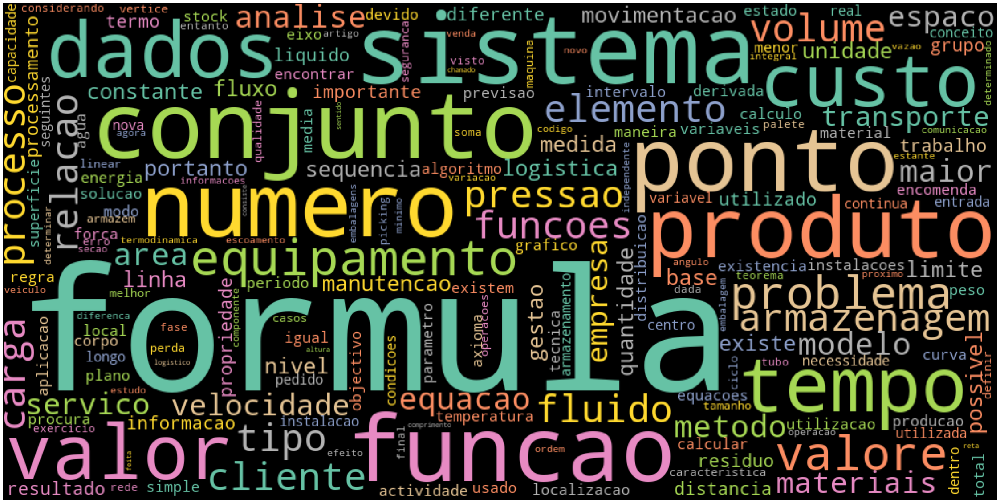

In [43]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 4_Ensino_Superior
wordcloud_superior = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    stopwords=stopwords_pt_br + termos_irrelevantes
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_superior)

### Amostragens

- Cenário: Holdout Simples (externo) > Validação Cruzada (interno)

In [44]:
# Obtendo as variáveis preditoras e resposta do dataset
X, y = df_textos_escolares['data'].values, df_textos_escolares['target'].values

In [45]:
# Definindo os valor dos parâmetros de amostragem
params_holdout_cv = {
    'test_size': 0.2,
    'folds_size': 10,
    'hyper_combinations_cv': 100
}

In [46]:
# Separando os dados em conjunto de treinamento e teste (80-20) com estratificação por classes
X_train_hcv, X_test_hcv, y_train_hcv, y_test_hcv = train_test_split(
    X,
    y,
    test_size=params_holdout_cv['test_size'],
    stratify=y,
    shuffle=True,
    random_state=SEED
)

In [47]:
# Construindo o objeto de validação cruzada com divisão em 5 diferentes grupos
kfold = KFold(
    n_splits=params_holdout_cv['folds_size'],
    shuffle=True,
    random_state=SEED
)

### Pré-Processamento

In [48]:
# Definindo o pipeline de pré-processamento para a validação dos melhores classificadores
pre_proc = Pipeline([
    # ('stopper', FunctionTransformer(lambda x: [' '.join([word for word in doc.split() if word not in stopwords_pt_br + termos_irrelevantes]) for doc in x])),
    # ('stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split()]) for doc in x])),
    ('stopper_stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split() if word not in (set(stopwords_pt_br) | set(termos_irrelevantes))]) for doc in x])),
    ('vectorizer', CountVectorizer()), # função vetorizadora de termos e frequências
    ('tfidf', TfidfTransformer(use_idf=True)), # função de obtenção dos pesos a partir da técnica de TF-IDF
    ('to_dense', FunctionTransformer(lambda x: x.todense(), accept_sparse=True)) # função de conversão de uma matriz esparsa pra uma densa
])

In [49]:
X_train_transf_hcv = pre_proc.fit_transform(X_train_hcv)

In [50]:
# Criando um dataframe com os array de dados transformados obtido
df_train_transf_hcv = pd.DataFrame(X_train_transf_hcv)

In [51]:
df_train_transf_hcv

,0,1,2,3,4,5,6,7,8,9,...,19025,19026,19027,19028,19029,19030,19031,19032,19033,19034
0,0.0,0.0,0.0,0.0,0.0,0.060181,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1655,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1656,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1657,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1658,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [52]:
X_test_transf_hcv = pre_proc.transform(X_test_hcv)

In [53]:
# Criando um dataframe com os array de dados transformados obtido
df_test_transf_hcv = pd.DataFrame(X_test_transf_hcv)

In [54]:
df_test_transf_hcv

,0,1,2,3,4,5,6,7,8,9,...,19025,19026,19027,19028,19029,19030,19031,19032,19033,19034
0,0.0,0.0,0.0,0.0,0.097382,0.0799,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
411,0.0,0.0,0.0,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
412,0.0,0.0,0.0,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
413,0.0,0.0,0.0,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
414,0.0,0.0,0.0,0.0,0.000000,0.0000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Seleção de Modelos

In [55]:
# Construindo os modelos de classificação
models = [
    ('K-NN', KNeighborsClassifier()),
    ('Reg. Log.', LogisticRegression(random_state=SEED)),
    ('SGD', SGDClassifier(random_state=SEED)),
    ('NB. Bern.', BernoulliNB()),
    ('NB. Multi.', MultinomialNB()),
    ('SVM', SVC(random_state=SEED)),
    ('DT', DecisionTreeClassifier(random_state=SEED)),
    ('RF', RandomForestClassifier(random_state=SEED)),
    ('MLP', MLPClassifier(random_state=SEED))
]

In [56]:
X_train_transf_hcv.shape

(1660, 19035)

In [57]:
X_test_transf_hcv.shape

(416, 19035)

In [58]:
# Obtendo os valores de média de acurácia balanceada por classes, obtida nos 10 grupos para cada modelo
bal_accs_train_hcv = []
bal_accs_test_hcv = []
classifiers_ml_desc_hcv = []

for desc, model in models:
    results = cross_val_score(model, X_train_transf_hcv, y_train_hcv, cv=kfold, scoring="balanced_accuracy", n_jobs=-1)
    
    model.fit(X_train_transf_hcv, y_train_hcv)
    y_preds = model.predict(X_test_transf_hcv)
    acc = balanced_accuracy_score(y_test_hcv, y_preds)
    
    bal_accs_train_hcv.append(results)
    bal_accs_test_hcv.append(acc)
    classifiers_ml_desc_hcv.append(desc)

In [59]:
# Criando um dataframe com os valores das métricas obtidos 
df_classifiers_ml_hcv = pd.DataFrame(bal_accs_train_hcv, index=classifiers_ml_desc_hcv)

df_classifiers_ml_hcv

,0,1,2,3,4,5,6,7,8,9
K-NN,0.835961,0.803055,0.831177,0.767229,0.863188,0.884293,0.864250,0.800883,0.784324,0.786813
Reg. Log.,0.877628,0.884395,0.847470,0.824406,0.856744,0.889973,0.921322,0.864151,0.822329,0.872813
SGD,0.878776,0.862922,0.898339,0.876699,0.917957,0.922956,0.959677,0.891945,0.897077,0.899941
NB. Bern.,0.768393,0.784431,0.693673,0.823110,0.804646,0.795708,0.828958,0.813916,0.786228,0.769078
NB. Multi.,0.647381,0.665072,0.593294,0.612081,0.700250,0.597289,0.609416,0.638345,0.552516,0.636979
SVM,0.877262,0.864259,0.878811,0.839112,0.866359,0.908233,0.927677,0.877424,0.861733,0.874608
DT,0.675352,0.669814,0.710522,0.701089,0.637267,0.704116,0.762915,0.655890,0.666735,0.708155
RF,0.747271,0.834812,0.765348,0.750911,0.790485,0.756906,0.802540,0.776690,0.769940,0.759989
MLP,0.866140,0.880723,0.906404,0.852189,0.914436,0.957853,0.955547,0.913282,0.906041,0.881585


In [60]:
# Apresentando as melhores médias das métricas obtidas por classificador
classifiers_train_mean_ranking = df_classifiers_ml_hcv.mean(axis=1).sort_values(ascending=False)

classifiers_train_mean_ranking

MLP           0.903420
SGD           0.900629
SVM           0.877548
Reg. Log.     0.866123
K-NN          0.822117
NB. Bern.     0.786814
RF            0.775489
DT            0.689185
NB. Multi.    0.625262
dtype: float64

In [61]:
classifiers_test_ranking = pd.Series(bal_accs_test_hcv, index=classifiers_ml_desc_hcv).sort_values(ascending=False)

classifiers_test_ranking

SGD           0.887667
MLP           0.880401
SVM           0.862302
Reg. Log.     0.839103
K-NN          0.803952
RF            0.786580
NB. Bern.     0.756524
DT            0.650372
NB. Multi.    0.632125
dtype: float64

In [62]:
df_classifiers_ranking = pd.concat([classifiers_train_mean_ranking, classifiers_test_ranking], axis=1)

df_classifiers_ranking.columns = ['train', 'test']

df_classifiers_ranking

,train,test
MLP,0.903420,0.880401
SGD,0.900629,0.887667
SVM,0.877548,0.862302
Reg. Log.,0.866123,0.839103
K-NN,0.822117,0.803952
NB. Bern.,0.786814,0.756524
RF,0.775489,0.786580
DT,0.689185,0.650372
NB. Multi.,0.625262,0.632125


In [63]:
df_classifiers_ml_best_hcv = df_classifiers_ml_hcv.reindex(df_classifiers_ml_hcv.mean(axis=1).sort_values(ascending=False).index)

df_classifiers_ml_best_hcv

,0,1,2,3,4,5,6,7,8,9
MLP,0.866140,0.880723,0.906404,0.852189,0.914436,0.957853,0.955547,0.913282,0.906041,0.881585
SGD,0.878776,0.862922,0.898339,0.876699,0.917957,0.922956,0.959677,0.891945,0.897077,0.899941
SVM,0.877262,0.864259,0.878811,0.839112,0.866359,0.908233,0.927677,0.877424,0.861733,0.874608
Reg. Log.,0.877628,0.884395,0.847470,0.824406,0.856744,0.889973,0.921322,0.864151,0.822329,0.872813
K-NN,0.835961,0.803055,0.831177,0.767229,0.863188,0.884293,0.864250,0.800883,0.784324,0.786813
NB. Bern.,0.768393,0.784431,0.693673,0.823110,0.804646,0.795708,0.828958,0.813916,0.786228,0.769078
RF,0.747271,0.834812,0.765348,0.750911,0.790485,0.756906,0.802540,0.776690,0.769940,0.759989
DT,0.675352,0.669814,0.710522,0.701089,0.637267,0.704116,0.762915,0.655890,0.666735,0.708155
NB. Multi.,0.647381,0.665072,0.593294,0.612081,0.700250,0.597289,0.609416,0.638345,0.552516,0.636979


In [64]:
# Filtrando os 5 melhores classificadores
top5_classifiers_ml_hcv = df_classifiers_ml_best_hcv.mean(axis=1).sort_values(ascending=False).head().index
df_classifiers_ml_top5_hcv = df_classifiers_ml_best_hcv.filter(items=top5_classifiers_ml_hcv, axis=0)

df_classifiers_ml_top5_hcv

,0,1,2,3,4,5,6,7,8,9
MLP,0.866140,0.880723,0.906404,0.852189,0.914436,0.957853,0.955547,0.913282,0.906041,0.881585
SGD,0.878776,0.862922,0.898339,0.876699,0.917957,0.922956,0.959677,0.891945,0.897077,0.899941
SVM,0.877262,0.864259,0.878811,0.839112,0.866359,0.908233,0.927677,0.877424,0.861733,0.874608
Reg. Log.,0.877628,0.884395,0.847470,0.824406,0.856744,0.889973,0.921322,0.864151,0.822329,0.872813
K-NN,0.835961,0.803055,0.831177,0.767229,0.863188,0.884293,0.864250,0.800883,0.784324,0.786813


/Users/nelsondressler/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/Users/nelsondressler/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/Users/nelsondressler/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displ

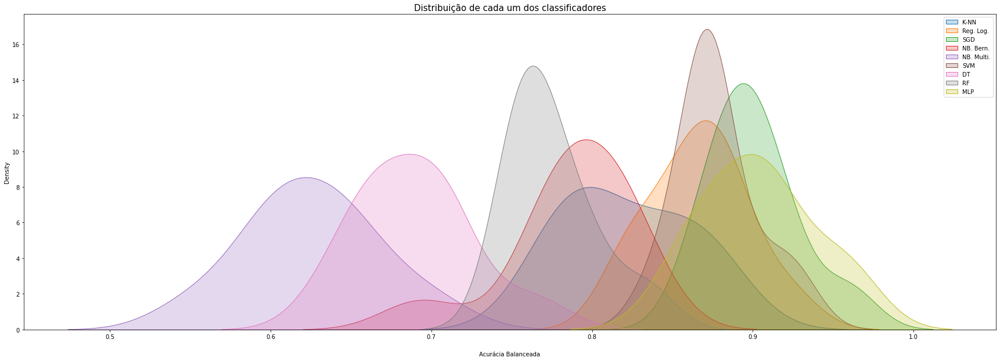

In [65]:
# Apresentando o resultado da acurácia balanceada dos modelos conforme as médias obtidas em gaussianas
plt.figure(figsize=(30, 10))

# for mean in df_classifiers_ml_top5_hcv.values:
for mean in df_classifiers_ml_hcv.values:
    sns.distplot(mean, hist=False, kde_kws={"shade": True})

plt.title("Distribuição de cada um dos classificadores", fontsize=15)
# plt.legend(df_classifiers_ml_top5_hcv.index)
plt.legend(df_classifiers_ml_hcv.index)
plt.xlabel("Acurácia Balanceada", labelpad=20)

plt.show()

In [66]:
# Estruturando os classificadores em colunas de técnicas e desempenhos
df_classifiers_ml_despivot_hcv = df_classifiers_ml_hcv.T.melt(var_name=['Algoritmo'], value_name='Acurácia Balanceada')

df_classifiers_ml_despivot_hcv.head()

,Algoritmo,Acurácia Balanceada
0,K-NN,0.835961
1,K-NN,0.803055
2,K-NN,0.831177
3,K-NN,0.767229
4,K-NN,0.863188


In [67]:
# Estruturando os classificadores em colunas de técnicas e desempenhos
df_classifiers_ml_top5_despivot_hcv = df_classifiers_ml_top5_hcv.T.melt(var_name=['Algoritmo'], value_name='Acurácia Balanceada')

df_classifiers_ml_top5_despivot_hcv.head()

,Algoritmo,Acurácia Balanceada
0,MLP,0.866140
1,MLP,0.880723
2,MLP,0.906404
3,MLP,0.852189
4,MLP,0.914436


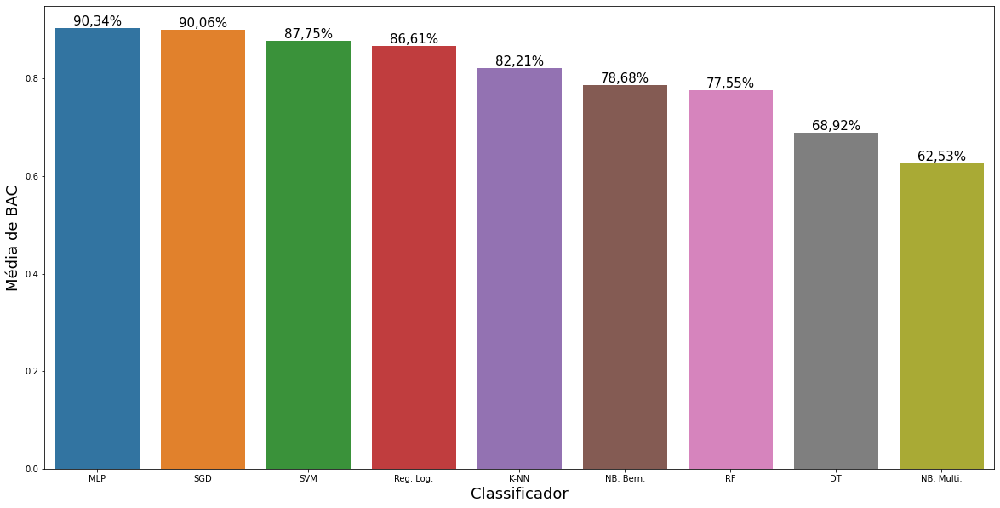

In [68]:
# Apresentando o resultado da acurácia balanceada dos modelos conforme as médias obtidas em boxplots
plt.figure(figsize=(20, 10))

labels = ['{:,.2%}'.format(x).replace('.', ',') for x in classifiers_train_mean_ranking]

ax = sns.barplot(x="Algoritmo", y="Acurácia Balanceada", data=df_classifiers_ml_despivot_hcv, order=classifiers_train_mean_ranking.index, estimator=np.mean, ci=0)
# ax.bar_label(ax.containers[0], size=15)
ax.bar_label(ax.containers[0], labels=labels, size=15)

plt.ylabel('Média de BAC', size=18)
plt.xlabel('Classificador', size=18)
plt.show()

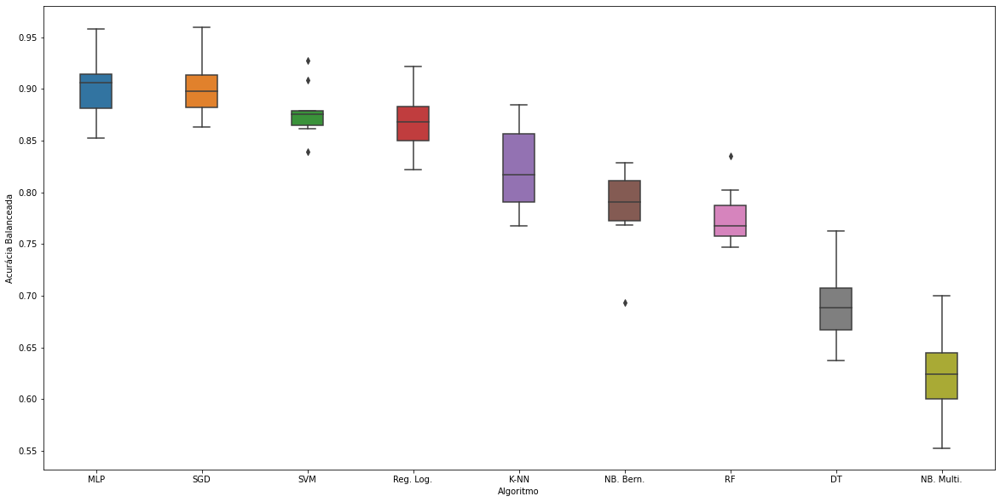

In [69]:
# Apresentando o resultado da acurácia balanceada dos modelos conforme as médias obtidas em boxplots
plt.figure(figsize=(20, 10))

# sns.boxplot(x="Algoritmo", y="Acurácia Balanceada", data=df_classifiers_ml_top5_despivot_hcv, width=0.3)   
sns.boxplot(x="Algoritmo", y="Acurácia Balanceada", data=df_classifiers_ml_despivot_hcv, width=0.3, order=classifiers_train_mean_ranking.index)   
plt.show()

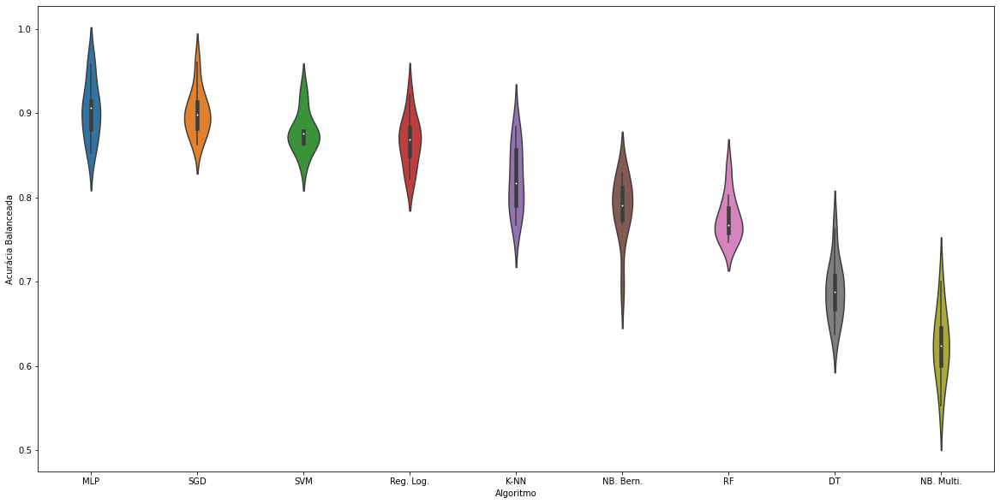

In [70]:
# Apresentando o resultado da acurácia balanceada dos modelos conforme as médias obtidas em gráficos de violino
plt.figure(figsize=(20, 10))

# sns.violinplot(x="Algoritmo", y="Acurácia Balanceada", data=df_classifiers_ml_top5_despivot_hcv, width=0.3)
sns.violinplot(x="Algoritmo", y="Acurácia Balanceada", data=df_classifiers_ml_despivot_hcv, width=0.3, order=classifiers_train_mean_ranking.index)
plt.show()

### Criação do Pipeiline

#### MLP

In [71]:
# Construindo o pipeline de machine learning
text_clf_mlp = Pipeline([
    # ('stopper', FunctionTransformer(lambda x: [' '.join([word for word in doc.split() if word not in stopwords_pt_br + termos_irrelevantes]) for doc in x])),
    # ('stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split()]) for doc in x])),
    ('stopper_stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split() if word not in (set(stopwords_pt_br) | set(termos_irrelevantes))]) for doc in x])),
    ('vectorizer', CountVectorizer()), # função vetorizadora de termos e frequências
    ('scorer', SelectKBest()), # função de seleção das melhores K características (termos) presentes no dataset 
    ('tfidf', TfidfTransformer()), # função de obtenção dos pesos a partir da técnica de TF-IDF
    ('to_dense', FunctionTransformer(lambda x: x.todense(), accept_sparse=True)), # função de conversão de uma matriz esparsa pra uma densa
    ('classify', MLPClassifier(random_state=SEED)) # função do melhor classificador obtido (MLP)
])

In [72]:
# Definindo o espaço de parâmetros para a busca do refinamento de hiperparâmetros
param_search_mlp = {
    'vectorizer__ngram_range': [(1, 1), (1, 2)], # quantidade mínima e máxima de combinação de palavras (n-gramas)
    'vectorizer__min_df': list(range(10)), # frequência mínima de palavras
    'vectorizer__max_features': list(range(100)), # quantidade de maiores frequências
    'tfidf__use_idf': [True, False], # utilização da frequência inversa
    'scorer__k': list(range(50)), # quantidade dos melhores termos do dataset, conforme a separação entre classes
    'scorer__score_func': [chi2, f_classif, mutual_info_classif], # tipo de teste estatístico utilizado
    'classify__hidden_layer_sizes': list(zip(list(range(0, 100, 5)))), # quantidade de neurônios por camada oculta (camada_ocula_1, camada_oculta_2, ...)
    'classify__activation': ['identity', 'logistic', 'tanh', 'relu'], # função de ativação utilizada para a(s) camada(s) oculta(s)
    'classify__solver': ['lbfgs', 'sgd', 'adam'], # algoritmo para otimização dos pesos da MLP
    'classify__learning_rate_init': list(np.arange(0.0001, 0.5, 0.0001)), # valor inicial da taxa de aprendizado
    'classify__max_iter': list(range(100)), # número máximo de épocas
    'classify__tol': list(np.arange(0.0001, 0.1, 0.001)), # tolerância utilizada pela função de custo
    'classify__batch_size': list(range(101)) # quantidade de amostras analisadas em conjunto para ajuste dos pesos
}

In [73]:
# Suprimindo as mensagens de alerta da execução da busca aleatória
warnings.filterwarnings("ignore")

# Construindo a estrutura de busca aleatória
search_mlp_hcv = RandomizedSearchCV(
    text_clf_mlp,
    cv=kfold,
    n_jobs=1,
    n_iter=params_holdout_cv['hyper_combinations_cv'],
    param_distributions=param_search_mlp,
    random_state=SEED,
    scoring='balanced_accuracy'
)

In [74]:
# Avaliando com validação cruzada o pipeline com os parâmetros passados
search_mlp_hcv.fit(X_train_hcv, y_train_hcv)

RandomizedSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                   estimator=Pipeline(steps=[('stopper_stemmer',
                                              FunctionTransformer(func=<function <lambda> at 0x7fee42e814c0>)),
                                             ('vectorizer', CountVectorizer()),
                                             ('scorer', SelectKBest()),
                                             ('tfidf', TfidfTransformer()),
                                             ('to_dense',
                                              FunctionTransformer(accept_sparse=True,
                                                                  func=<function <lambda> at 0x7fee42e81...
                                                               <function f_classif at 0x7fee10653670>,
                                                               <function mutual_info_classif at 0x7fee526401f0>],
                                        'tfidf__use_i

In [75]:
# Apresentando os resultados obtidos
df_search_mlp_hcv = pd.DataFrame(search_mlp_hcv.cv_results_)

df_search_mlp_hcv

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_vectorizer__ngram_range,param_vectorizer__min_df,param_vectorizer__max_features,param_tfidf__use_idf,param_scorer__score_func,param_scorer__k,...,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
0,7.920041,0.638007,0.973336,0.018329,"(1, 1)",5,53,True,<function chi2 at 0x7fee10653790>,29,...,0.466673,0.578199,0.550284,0.545998,0.527962,0.532304,0.496915,0.526738,0.034179,24
1,8.016597,0.026276,0.000000,0.000000,"(1, 1)",0,33,True,<function chi2 at 0x7fee10653790>,40,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,78
2,8.490107,0.051287,0.000000,0.000000,"(1, 2)",0,18,False,<function f_classif at 0x7fee10653670>,41,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,77
3,8.034189,0.032868,0.976724,0.018528,"(1, 1)",5,47,True,<function f_classif at 0x7fee10653670>,22,...,0.397059,0.368182,0.345374,0.378049,0.390625,0.333333,0.267544,0.347467,0.043690,58
4,8.551926,0.029769,0.978447,0.019296,"(1, 2)",5,87,False,<function mutual_info_classif at 0x7fee526401f0>,8,...,0.521102,0.506348,0.484628,0.484306,0.484183,0.444250,0.487427,0.484430,0.028839,34
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,9.044204,0.026701,1.032422,0.022042,"(1, 2)",9,75,True,<function mutual_info_classif at 0x7fee526401f0>,13,...,0.346184,0.340909,0.312993,0.304878,0.334077,0.338889,0.304071,0.326452,0.015189,60
96,8.542979,0.023885,1.012795,0.020065,"(1, 1)",4,72,True,<function chi2 at 0x7fee10653790>,19,...,0.507272,0.391865,0.457215,0.462607,0.504896,0.452224,0.521961,0.477158,0.040091,38
97,8.403903,0.029146,1.015402,0.020278,"(1, 1)",5,68,True,<function chi2 at 0x7fee10653790>,17,...,0.477506,0.429321,0.454945,0.539703,0.494960,0.484936,0.518319,0.479430,0.044285,37
98,8.965608,0.033240,0.000000,0.000000,"(1, 2)",9,2,True,<function mutual_info_classif at 0x7fee526401f0>,48,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85


In [76]:
# Apresentando a métrica do melhor resultado obtido
search_mlp_hcv.best_score_

0.6624014048539784

In [77]:
# Apresentando os parâmetros do melhor resultado obtido
search_mlp_hcv.best_params_

{'vectorizer__ngram_range': (1, 1),
 'vectorizer__min_df': 7,
 'vectorizer__max_features': 88,
 'tfidf__use_idf': False,
 'scorer__score_func': <function sklearn.feature_selection._univariate_selection.f_classif(X, y)>,
 'scorer__k': 42,
 'classify__tol': 0.0751,
 'classify__solver': 'sgd',
 'classify__max_iter': 68,
 'classify__learning_rate_init': 0.083,
 'classify__hidden_layer_sizes': (85,),
 'classify__batch_size': 59,
 'classify__activation': 'relu'}

#### K-NN

In [78]:
# Construindo o pipeline de machine learning
text_clf_knn = Pipeline([
    # ('stopper', FunctionTransformer(lambda x: [' '.join([word for word in doc.split() if word not in stopwords_pt_br + termos_irrelevantes]) for doc in x])),
    # ('stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split()]) for doc in x])),
    ('stopper_stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split() if word not in (set(stopwords_pt_br) | set(termos_irrelevantes))]) for doc in x])),
    ('vectorizer', CountVectorizer()), # função vetorizadora de termos e frequências
    ('scorer', SelectKBest()), # função de seleção das melhores K características (termos) presentes no dataset 
    ('tfidf', TfidfTransformer()), # função de obtenção dos pesos a partir da técnica de TF-IDF
    ('to_dense', FunctionTransformer(lambda x: x.todense(), accept_sparse=True)), # função de conversão de uma matriz esparsa pra uma densa
    ('classify', KNeighborsClassifier()) # função do terceiro melhor classificador obtido (K-NN)
])

In [79]:
# Definindo o espaço de parâmetros para a busca do refinamento de hiperparâmetros
param_search_knn = {
    'vectorizer__ngram_range': [(1, 1), (1, 2)], # quantidade mínima e máxima de combinação de palavras (n-gramas)
    'vectorizer__min_df': list(range(10)), # frequência mínima de palavras
    'vectorizer__max_features': list(range(100)), # quantidade de maiores frequências
    'tfidf__use_idf': [True, False], # quantidade de maiores frequências
    'scorer__k': list(range(50)), # quantidade dos melhores termos do dataset, conforme a separação entre classes
    'scorer__score_func': [chi2, f_classif, mutual_info_classif], # tipo de teste estatístico utilizado
    'classify__n_neighbors': list(range(1, 100, 2)), # quantidade de vizinhos mais próximos
}

In [80]:
# Suprimindo as mensagens de alerta da execução da busca aleatória
warnings.filterwarnings("ignore")

# Construindo a estrutura de busca aleatória
search_knn_hcv = RandomizedSearchCV(
    text_clf_knn,
    cv=kfold,
    n_jobs=1,
    n_iter=params_holdout_cv['hyper_combinations_cv'],
    param_distributions=param_search_knn,
    random_state=SEED,
    scoring='balanced_accuracy'
)

In [81]:
# Avaliando com validação cruzada o pipeline com os parâmetros passados
search_knn_hcv.fit(X_train_hcv, y_train_hcv)

RandomizedSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                   estimator=Pipeline(steps=[('stopper_stemmer',
                                              FunctionTransformer(func=<function <lambda> at 0x7fee5270fca0>)),
                                             ('vectorizer', CountVectorizer()),
                                             ('scorer', SelectKBest()),
                                             ('tfidf', TfidfTransformer()),
                                             ('to_dense',
                                              FunctionTransformer(accept_sparse=True,
                                                                  func=<function <lambda> at 0x7fee5270f...
                                                               <function f_classif at 0x7fee10653670>,
                                                               <function mutual_info_classif at 0x7fee526401f0>],
                                        'tfidf__use_i

In [82]:
# Apresentando os resultados obtidos
df_search_knn_hcv = pd.DataFrame(search_knn_hcv.cv_results_)

df_search_knn_hcv

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_vectorizer__ngram_range,param_vectorizer__min_df,param_vectorizer__max_features,param_tfidf__use_idf,param_scorer__score_func,param_scorer__k,...,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
0,8.430714,0.064793,0.000000,0.000000,"(1, 1)",2,30,True,<function f_classif at 0x7fee10653670>,33,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100
1,8.434823,0.036300,0.000000,0.000000,"(1, 1)",9,23,False,<function chi2 at 0x7fee10653790>,41,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,79
2,8.474989,0.030311,1.026423,0.020981,"(1, 1)",5,92,False,<function mutual_info_classif at 0x7fee526401f0>,43,...,0.568473,0.527099,0.511581,0.549084,0.559716,0.539375,0.527888,0.535429,0.019200,13
3,9.008210,0.080145,0.000000,0.000000,"(1, 2)",3,28,False,<function chi2 at 0x7fee10653790>,38,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85
4,8.465120,0.025568,1.020507,0.017721,"(1, 1)",4,89,True,<function mutual_info_classif at 0x7fee526401f0>,6,...,0.497188,0.433296,0.509958,0.492219,0.482575,0.448339,0.479149,0.495343,0.038988,40
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,8.034837,0.047474,0.000000,0.000000,"(1, 1)",1,11,False,<function chi2 at 0x7fee10653790>,29,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,80
96,8.456930,0.021372,0.986799,0.020863,"(1, 2)",9,81,True,<function f_classif at 0x7fee10653670>,14,...,0.471713,0.508145,0.475172,0.509542,0.532426,0.502331,0.534482,0.507928,0.031613,30
97,8.506170,0.117121,0.000000,0.000000,"(1, 2)",2,34,True,<function chi2 at 0x7fee10653790>,47,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,78
98,8.043442,0.035330,0.981491,0.020465,"(1, 1)",5,59,False,<function mutual_info_classif at 0x7fee526401f0>,39,...,0.568491,0.534644,0.535433,0.555092,0.595838,0.601719,0.609459,0.575533,0.029797,1


In [83]:
# Apresentando a métrica do melhor resultado obtido
search_knn_hcv.best_score_

0.575532726564813

In [84]:
# Apresentando os parâmetros do melhor resultado obtido
search_knn_hcv.best_params_

{'vectorizer__ngram_range': (1, 1),
 'vectorizer__min_df': 5,
 'vectorizer__max_features': 59,
 'tfidf__use_idf': False,
 'scorer__score_func': <function sklearn.feature_selection._mutual_info.mutual_info_classif(X, y, *, discrete_features='auto', n_neighbors=3, copy=True, random_state=None)>,
 'scorer__k': 39,
 'classify__n_neighbors': 9}

#### SGD

In [85]:
# Construindo o pipeline de machine learning
text_clf_sgd = Pipeline([
    # ('stopper', FunctionTransformer(lambda x: [' '.join([word for word in doc.split() if word not in stopwords_pt_br + termos_irrelevantes]) for doc in x])),
    # ('stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split()]) for doc in x])),
    ('stopper_stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split() if word not in (set(stopwords_pt_br) | set(termos_irrelevantes))]) for doc in x])),
    ('vectorizer', CountVectorizer()), # função vetorizadora de termos e frequências
    ('scorer', SelectKBest()), # função de seleção das melhores K características (termos) presentes no dataset 
    ('tfidf', TfidfTransformer()), # função de obtenção dos pesos a partir da técnica de TF-IDF
    ('to_dense', FunctionTransformer(lambda x: x.todense(), accept_sparse=True)), # função de conversão de uma matriz esparsa pra uma densa
    ('classify', SGDClassifier(random_state=SEED)) # função do segundo melhor classificador obtido (SGD)
])

In [86]:
# Definindo o espaço de parâmetros para a busca do refinamento de hiperparâmetros
param_search_sgd = {
    'vectorizer__ngram_range': [(1, 1), (1, 2)], # quantidade mínima e máxima de combinação de palavras (n-gramas)
    'vectorizer__min_df': list(range(10)), # frequência mínima de palavras
    'vectorizer__max_features': list(range(100)), # quantidade de maiores frequências
    'tfidf__use_idf': [True, False], # quantidade de maiores frequências
    'scorer__k': list(range(50)), # quantidade dos melhores termos do dataset, conforme a separação entre classes
    'scorer__score_func': [chi2, f_classif, mutual_info_classif], # tipo de teste estatístico utilizado
    'classify__loss': ['hinge', 'log', 'modified_huber', 'squared_hinge', 'perceptron', ], # tipo de função de perda
    'classify__penalty': ['l1', 'l2', 'elasticnet'], # tipo de penalização
    'classify__fit_intercept': [True, False], # execução de cálculo do intercepto ou não
    'classify__max_iter': list(range(1, 100)), # número máximo de épocas
    'classify__shuffle': [True, False], # embaralhamento dos dados
    'classify__tol': list(np.arange(0.0001, 0.1, 0.001)), # tolerância utilizada pela função de custo
    # 'classify__learning_rate': ['constant', 'optimal', 'invscaling', 'adaptive'] # tipo de função de aprendizado
}

In [87]:
# Suprimindo as mensagens de alerta da execução da busca aleatória
warnings.filterwarnings("ignore")

# Construindo a estrutura de busca aleatória
search_sgd_hcv = RandomizedSearchCV(
    text_clf_sgd,
    cv=kfold,
    n_jobs=1,
    n_iter=params_holdout_cv['hyper_combinations_cv'],
    param_distributions=param_search_sgd,
    random_state=SEED,
    scoring='balanced_accuracy'
)

In [88]:
# Avaliando com validação cruzada o pipeline com os parâmetros passados
search_sgd_hcv.fit(X_train_hcv, y_train_hcv)

RandomizedSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                   estimator=Pipeline(steps=[('stopper_stemmer',
                                              FunctionTransformer(func=<function <lambda> at 0x7fee42e791f0>)),
                                             ('vectorizer', CountVectorizer()),
                                             ('scorer', SelectKBest()),
                                             ('tfidf', TfidfTransformer()),
                                             ('to_dense',
                                              FunctionTransformer(accept_sparse=True,
                                                                  func=<function <lambda> at 0x7fee42e79...
                                                               <function f_classif at 0x7fee10653670>,
                                                               <function mutual_info_classif at 0x7fee526401f0>],
                                        'tfidf__use_i

In [89]:
# Apresentando os resultados obtidos
df_search_sgd_hcv = pd.DataFrame(search_sgd_hcv.cv_results_)

df_search_sgd_hcv

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_vectorizer__ngram_range,param_vectorizer__min_df,param_vectorizer__max_features,param_tfidf__use_idf,param_scorer__score_func,param_scorer__k,...,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
0,8.026255,0.042835,0.969152,0.018669,"(1, 1)",2,84,True,<function f_classif at 0x7fee10653670>,7,...,0.501128,0.460145,0.469276,0.449913,0.431164,0.455973,0.435087,0.466562,0.033159,56
1,8.002020,0.022568,0.965614,0.017663,"(1, 1)",3,64,False,<function f_classif at 0x7fee10653670>,25,...,0.489852,0.507572,0.504044,0.544214,0.497216,0.484780,0.520689,0.522082,0.028983,26
2,8.013862,0.024281,0.966808,0.017668,"(1, 1)",9,42,False,<function chi2 at 0x7fee10653790>,3,...,0.401866,0.452305,0.521264,0.414593,0.434140,0.432110,0.384222,0.423787,0.039353,66
3,8.045617,0.042774,0.000000,0.000000,"(1, 1)",7,25,True,<function mutual_info_classif at 0x7fee526401f0>,32,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,77
4,8.053225,0.055768,0.969270,0.018027,"(1, 1)",6,54,False,<function chi2 at 0x7fee10653790>,33,...,0.551843,0.471260,0.551148,0.607967,0.646217,0.506430,0.563719,0.558148,0.045401,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,8.753991,0.221172,1.012072,0.042877,"(1, 2)",2,50,False,<function mutual_info_classif at 0x7fee526401f0>,34,...,0.538241,0.501327,0.532497,0.526950,0.574021,0.543609,0.465098,0.537072,0.039248,22
96,8.284924,0.072752,0.985670,0.025030,"(1, 1)",6,98,True,<function mutual_info_classif at 0x7fee526401f0>,42,...,0.602334,0.571381,0.619891,0.701320,0.619528,0.536733,0.557073,0.605360,0.044687,5
97,8.626156,0.159567,1.001726,0.046658,"(1, 2)",4,88,False,<function chi2 at 0x7fee10653790>,17,...,0.478947,0.583920,0.419779,0.519610,0.494624,0.438675,0.543707,0.493452,0.052507,41
98,8.493650,0.021147,0.980862,0.017359,"(1, 2)",4,95,False,<function chi2 at 0x7fee10653790>,20,...,0.447573,0.478925,0.532445,0.501809,0.382680,0.435062,0.490859,0.460269,0.042661,57


In [90]:
# Apresentando a métrica do melhor resultado obtido
search_sgd_hcv.best_score_

0.6251257667915576

In [91]:
# Apresentando os parâmetros do melhor resultado obtido
search_sgd_hcv.best_params_

{'vectorizer__ngram_range': (1, 1),
 'vectorizer__min_df': 3,
 'vectorizer__max_features': 67,
 'tfidf__use_idf': True,
 'scorer__score_func': <function sklearn.feature_selection._univariate_selection.chi2(X, y)>,
 'scorer__k': 47,
 'classify__tol': 0.07010000000000001,
 'classify__shuffle': True,
 'classify__penalty': 'l1',
 'classify__max_iter': 76,
 'classify__loss': 'modified_huber',
 'classify__fit_intercept': False}

### Predição

#### MLP

In [92]:
# Obtendo o classificador com o melhor desempenho resultante
clf_mlp_hcv = search_mlp_hcv.best_estimator_

In [93]:
# Habilitando a saída das funções de custo do classificador por época
clf_mlp_hcv.named_steps['classify'].verbose = True

In [94]:
# Criando o modelo com base nos dados de treino
clf_mlp_hcv.fit(X_train_hcv, y_train_hcv)

Iteration 1, loss = 1.15536903
Iteration 2, loss = 0.82912438
Iteration 3, loss = 0.71959924
Iteration 4, loss = 0.68056578
Iteration 5, loss = 0.66276937
Iteration 6, loss = 0.65847161
Iteration 7, loss = 0.64816285
Iteration 8, loss = 0.63974681
Iteration 9, loss = 0.63394238
Iteration 10, loss = 0.63026282
Iteration 11, loss = 0.62257336
Iteration 12, loss = 0.61140352
Iteration 13, loss = 0.60727644
Iteration 14, loss = 0.61472397
Training loss did not improve more than tol=0.075100 for 10 consecutive epochs. Stopping.


Pipeline(steps=[('stopper_stemmer',
                 FunctionTransformer(func=<function <lambda> at 0x7fee42e814c0>)),
                ('vectorizer', CountVectorizer(max_features=88, min_df=7)),
                ('scorer', SelectKBest(k=42)),
                ('tfidf', TfidfTransformer(use_idf=False)),
                ('to_dense',
                 FunctionTransformer(accept_sparse=True,
                                     func=<function <lambda> at 0x7fee42e81430>)),
                ('classify',
                 MLPClassifier(batch_size=59, hidden_layer_sizes=(85,),
                               learning_rate_init=0.083, max_iter=68,
                               random_state=42, solver='sgd', tol=0.0751,
                               verbose=True))])

In [95]:
# Prevendo os dados de treino com o classificador obtido
y_pred_mlp_train_hcv = clf_mlp_hcv.predict(X_train_hcv)

In [96]:
# Prevendo os dados de teste com o classificador obtido
y_pred_mlp_test_hcv = clf_mlp_hcv.predict(X_test_hcv)

#### K-NN

In [97]:
# Obtendo o classificador com o melhor desempenho resultante
clf_knn_hcv = search_knn_hcv.best_estimator_

In [98]:
# Criando o modelo com base nos dados de treino
clf_knn_hcv.fit(X_train_hcv, y_train_hcv)

Pipeline(steps=[('stopper_stemmer',
                 FunctionTransformer(func=<function <lambda> at 0x7fee5270fca0>)),
                ('vectorizer', CountVectorizer(max_features=59, min_df=5)),
                ('scorer',
                 SelectKBest(k=39,
                             score_func=<function mutual_info_classif at 0x7fee526401f0>)),
                ('tfidf', TfidfTransformer(use_idf=False)),
                ('to_dense',
                 FunctionTransformer(accept_sparse=True,
                                     func=<function <lambda> at 0x7fee5270fc10>)),
                ('classify', KNeighborsClassifier(n_neighbors=9))])

In [99]:
# Prevendo os dados de teste com o classificador obtido
y_pred_knn_train_hcv = clf_knn_hcv.predict(X_train_hcv)

In [100]:
# Prevendo os dados de teste com o classificador obtido
y_pred_knn_test_hcv = clf_knn_hcv.predict(X_test_hcv)

#### SGD

In [101]:
# Obtendo o classificador com o melhor desempenho resultante
clf_sgd_hcv = search_sgd_hcv.best_estimator_

In [102]:
# Criando o modelo com base nos dados de treino
clf_sgd_hcv.fit(X_train_hcv, y_train_hcv)

Pipeline(steps=[('stopper_stemmer',
                 FunctionTransformer(func=<function <lambda> at 0x7fee42e791f0>)),
                ('vectorizer', CountVectorizer(max_features=67, min_df=3)),
                ('scorer',
                 SelectKBest(k=47,
                             score_func=<function chi2 at 0x7fee10653790>)),
                ('tfidf', TfidfTransformer()),
                ('to_dense',
                 FunctionTransformer(accept_sparse=True,
                                     func=<function <lambda> at 0x7fee42e79160>)),
                ('classify',
                 SGDClassifier(fit_intercept=False, loss='modified_huber',
                               max_iter=76, penalty='l1', random_state=42,
                               tol=0.07010000000000001))])

In [103]:
# Prevendo os dados de teste com o classificador obtido
y_pred_sgd_train_hcv = clf_sgd_hcv.predict(X_train_hcv)

In [104]:
# Prevendo os dados de teste com o classificador obtido
y_pred_sgd_test_hcv = clf_sgd_hcv.predict(X_test_hcv)

### Resultados

#### MLP

In [105]:
# Apresentando a acurácia balanceada por classes para os dados de treinamento
print(f'[Conjunto de Treinamento] Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_train_hcv, y_pred_mlp_train_hcv)}')

[Conjunto de Treinamento] Acurácia Balanceada entre Classes: 0.7115464851139799


In [106]:
# Apresentando a acurácia balanceada por classes para os dados de teste
print(f'[Conjunto de Teste] Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_test_hcv, y_pred_mlp_test_hcv)}')

[Conjunto de Teste] Acurácia Balanceada entre Classes: 0.7285431538035173


In [107]:
# Obtendo a matriz de confusão
cf_matrix_clf_mlp_hcv = confusion_matrix(y_test_hcv, y_pred_mlp_test_hcv)

# Criando um dataframe com a matriz de confusão
df_cf_matrix_clf_mlp_hcv = pd.DataFrame(cf_matrix_clf_mlp_hcv)

# Renomeando os índices e colunas do dataframe com o nome dos rótulos
df_cf_matrix_clf_mlp_hcv = df_cf_matrix_clf_mlp_hcv.rename(target_map).T.rename(target_map).T

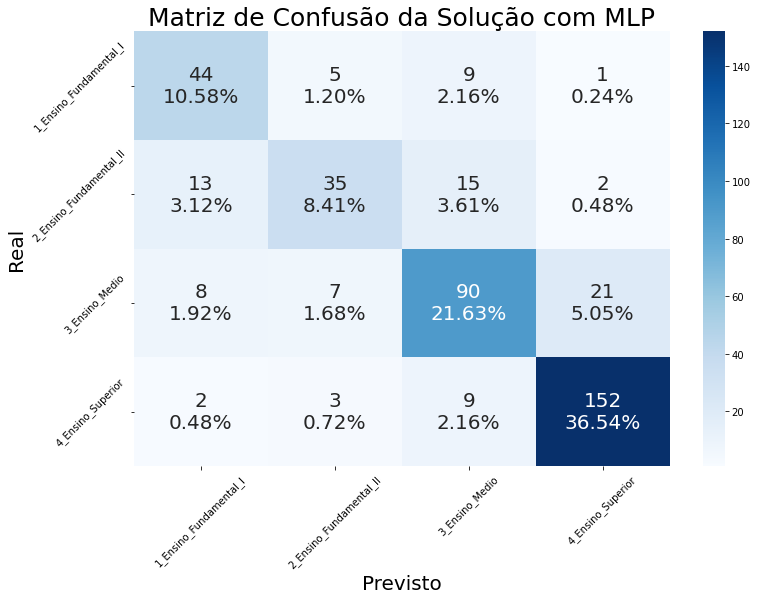

In [108]:
# Apresentando a matriz de confusão
num_classes = len(encoder.classes_)
group_counts = ['{0:0.0f}'.format(value) for value in cf_matrix_clf_mlp_hcv.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix_clf_mlp_hcv.flatten() / np.sum(cf_matrix_clf_mlp_hcv)]
labels = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts, group_percentages)]
labels = np.asarray(labels).reshape(num_classes, num_classes)

plt.figure(figsize=(12,8))
ax = sns.heatmap(df_cf_matrix_clf_mlp_hcv, annot=labels, fmt='', cmap='Blues', annot_kws={"size": 20})
ax.set_title("Matriz de Confusão da Solução com MLP", fontsize=25)
ax.set_xlabel('Previsto', fontsize=20)
ax.set_ylabel('Real', fontsize=20)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_yticklabels(ax.get_yticklabels(), rotation=45)

plt.plot()
plt.savefig('matriz_confusao_mlp.png')

In [109]:
# Apresentando um relatório completo da classificação executada
print(classification_report(y_test_hcv, y_pred_mlp_test_hcv))

              precision    recall  f1-score   support

           0       0.66      0.75      0.70        59
           1       0.70      0.54      0.61        65
           2       0.73      0.71      0.72       126
           3       0.86      0.92      0.89       166

    accuracy                           0.77       416
   macro avg       0.74      0.73      0.73       416
weighted avg       0.77      0.77      0.77       416



In [110]:
# Obtendo o classificador usado
clf_mlp_conf_hcv = clf_mlp_hcv.named_steps['classify']

clf_mlp_conf_hcv

MLPClassifier(batch_size=59, hidden_layer_sizes=(85,), learning_rate_init=0.083,
              max_iter=68, random_state=42, solver='sgd', tol=0.0751,
              verbose=True)

In [111]:
# Apresentando os dados relevantes dos hiperparâmetros do modelo
print(f'Quantidade de variáveis na camada de entrada: {clf_mlp_conf_hcv.coefs_[0].shape[0]}')
print(f'Quantidade de neurônios na camada oculta: {clf_mlp_conf_hcv.hidden_layer_sizes[0]}')
print(f'Quantidade de neurônios na camada de saída: {clf_mlp_conf_hcv.n_outputs_}')
print(f'Quantidade de épocas executadas: {clf_mlp_conf_hcv.n_iter_}')
print(f'Quantidade de pesos na camada oculta: {clf_mlp_conf_hcv.coefs_[0].shape[1]}')
print(f'Quantidade de pesos na camada de saída: {clf_mlp_conf_hcv.coefs_[1].shape[1]}')
print(f'Quantidade de bias na camada oculta: {clf_mlp_conf_hcv.intercepts_[0].shape[0]}')
print(f'Quantidade de bias na camada de saída: {clf_mlp_conf_hcv.intercepts_[1].shape[0]}')
print(f'Função de ativação na camada oculta: {clf_mlp_conf_hcv.activation}')
print(f'Função de ativação na camada de saída: {clf_mlp_conf_hcv.out_activation_}')

Quantidade de variáveis na camada de entrada: 42
Quantidade de neurônios na camada oculta: 85
Quantidade de neurônios na camada de saída: 4
Quantidade de épocas executadas: 14
Quantidade de pesos na camada oculta: 85
Quantidade de pesos na camada de saída: 4
Quantidade de bias na camada oculta: 85
Quantidade de bias na camada de saída: 4
Função de ativação na camada oculta: relu
Função de ativação na camada de saída: softmax


In [112]:
# Apresentando os pesos sinápticos da camada oculta (Wh)
clf_mlp_conf_hcv.coefs_[0]

array([[-0.03142617,  0.18609811,  0.43571891, ...,  0.05270716,
        -0.19120273, -0.08183448],
       [-0.11044914,  0.29118078, -0.35125365, ..., -0.00837096,
        -0.19991458,  0.03767957],
       [ 0.11912005, -0.23172993,  0.3112703 , ..., -0.02429712,
        -0.08226727, -0.14357884],
       ...,
       [ 0.13502938, -0.01481655, -0.33729946, ...,  0.17279668,
        -0.11667579,  0.03242712],
       [-0.25745588, -0.07213954, -0.08532968, ..., -0.21428066,
         0.17953066,  0.03635376],
       [ 0.0536025 , -0.13047801,  0.09920246, ..., -0.12178952,
         0.10588245,  0.16142364]])

In [113]:
# Apresentando os pesos sinápticos da camada de saída (Wo)
clf_mlp_conf_hcv.coefs_[1]

array([[-3.04539981e-01, -1.01193522e-01, -1.14903901e-01,
         3.49683244e-01],
       [ 2.24859058e-01,  3.16989771e-01, -8.90147468e-02,
        -4.67375592e-01],
       [-6.07365654e-01, -6.35989837e-01, -2.84858107e-01,
         1.45734237e+00],
       [-5.35931718e-01, -5.18356063e-01,  2.74843506e-01,
         1.94168580e-01],
       [-9.71326768e-01,  1.55756969e-01, -3.45717187e-01,
         8.98768811e-01],
       [-9.96804218e-02, -1.69162408e-01, -5.34585035e-02,
         1.33274228e-01],
       [ 1.16489708e-01,  1.03144987e-01, -3.54271022e-01,
         1.55975588e-01],
       [-9.49699720e-01,  2.56782749e-01,  4.40236996e-02,
         8.61270465e-01],
       [-5.76025418e-01, -4.04520271e-01, -2.77635859e-01,
         8.94665700e-01],
       [ 2.32347161e-01,  3.49680628e-01, -5.36810622e-01,
        -1.07755006e-01],
       [-6.99390559e-01,  2.62840944e-01,  2.76829786e-01,
         4.67278977e-01],
       [-1.96829474e-01,  1.32966991e-01, -2.22158564e-02,
      

In [114]:
# Apresentando os bias da camada oculta
clf_mlp_conf_hcv.intercepts_[0]

array([-0.02557888,  0.0226453 , -0.08997508,  0.04887198,  0.32459839,
       -0.17316174, -0.07183935,  0.27197175,  0.16990783,  0.13155369,
        0.19691684,  0.13006103, -0.10109331,  0.19527006, -0.00776924,
       -0.04331414,  0.23599997,  0.39880016, -0.20207767,  0.22590939,
        0.1720423 , -0.09602423, -0.06240441,  0.23594228,  0.1539567 ,
        0.08442924, -0.0882852 , -0.05373911, -0.1113881 ,  0.15791026,
       -0.21430833,  0.34237757, -0.0490688 , -0.02002517, -0.12501808,
       -0.14090034,  0.14157851, -0.04351815,  0.05060499,  0.3561686 ,
        0.23191605, -0.02768635,  0.17999115,  0.05626936,  0.03004795,
       -0.00885624,  0.14902863,  0.30028748,  0.237743  , -0.22467968,
        0.14705971, -0.00852996, -0.15783248,  0.27285288, -0.20559999,
       -0.17206987, -0.21251379,  0.2093962 ,  0.10900665,  0.02162357,
        0.26004891, -0.09401183,  0.11388178, -0.14654013,  0.2894224 ,
       -0.02157531,  0.22701888, -0.21111468, -0.01879026, -0.03

In [115]:
# Apresentando os bias da camada de saída
clf_mlp_conf_hcv.intercepts_[1]

array([ 0.06097845,  0.16150115, -0.09409713, -0.28363945])

In [116]:
# Estruturando a função de custo para apresentá-lo graficamente
if clf_mlp_conf_hcv.solver != 'lbfgs': # quanto o solver assume o valor lbfgs, não é gerada a curva de funções de custo/perda
    dict_loss_mlp_hcv = {
        'iteration': list(range(1, len(clf_mlp_conf_hcv.loss_curve_) + 1)),
        'loss': clf_mlp_conf_hcv.loss_curve_,
        'style': 'o'
    }

    df_loss_mlp_hcv = pd.DataFrame(dict_loss_mlp_hcv)
else:
    df_loss_mlp_hcv = pd.DataFrame([], columns=['iteration', 'loss', 'style'])
    
df_loss_mlp_hcv.head()

,iteration,loss,style
0,1,1.155369,o
1,2,0.829124,o
2,3,0.719599,o
3,4,0.680566,o
4,5,0.662769,o


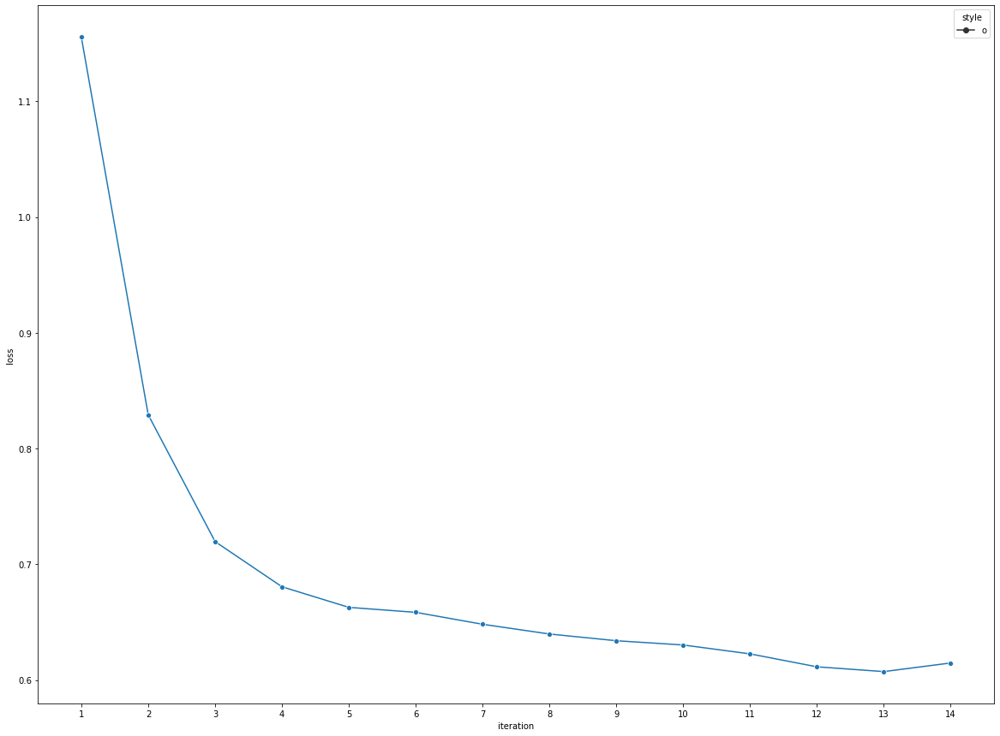

In [117]:
# Apresentando um gráfico com o decaimento da função de perda
if clf_mlp_conf_hcv.solver != 'lbfgs': # quanto o solver assume o valor lbfgs, não é gerada a curva de funções de custo/perda
    plt.figure(figsize=(20,15))
    plt.xticks(df_loss_mlp_hcv['iteration'])
    sns.lineplot(data=df_loss_mlp_hcv, x='iteration', y='loss', style='style', markers=True, palette='tab10')

#### K-NN

In [118]:
# Apresentando a acurácia balanceada por classes para os dados de treinamento
print(f'[Conjunto de Treinamento] Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_train_hcv, y_pred_knn_train_hcv)}')

[Conjunto de Treinamento] Acurácia Balanceada entre Classes: 0.657816868702737


In [119]:
# Apresentando a acurácia balanceada por classes para os dados de teste
print(f'[Conjunto de Teste] Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_test_hcv, y_pred_knn_test_hcv)}')

[Conjunto de Teste] Acurácia Balanceada entre Classes: 0.6218937524481736


In [120]:
# Obtendo a matriz de confusão
cf_matrix_clf_knn_hcv = confusion_matrix(y_test_hcv, y_pred_knn_test_hcv)

# Criando um dataframe com a matriz de confusão
df_cf_matrix_clf_knn_hcv = pd.DataFrame(cf_matrix_clf_knn_hcv)

# Renomeando os índices e colunas do dataframe com o nome dos rótulos
df_cf_matrix_clf_knn_hcv = df_cf_matrix_clf_knn_hcv.rename(target_map).T.rename(target_map).T

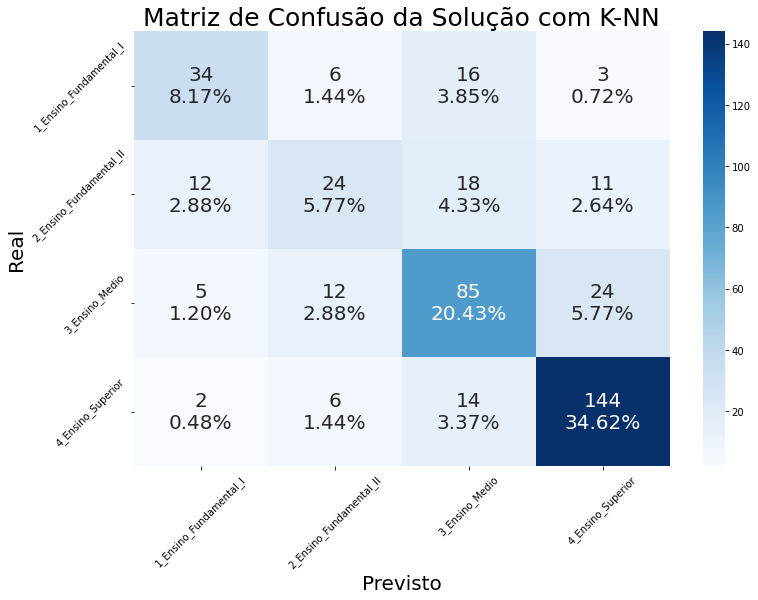

In [121]:
# Apresentando a matriz de confusão
num_classes = len(encoder.classes_)
group_counts = ['{0:0.0f}'.format(value) for value in cf_matrix_clf_knn_hcv.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix_clf_knn_hcv.flatten() / np.sum(cf_matrix_clf_knn_hcv)]
labels = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts, group_percentages)]
labels = np.asarray(labels).reshape(num_classes, num_classes)

plt.figure(figsize=(12,8))
ax = sns.heatmap(df_cf_matrix_clf_knn_hcv, annot=labels, fmt='', cmap='Blues', annot_kws={"size": 20})
ax.set_title("Matriz de Confusão da Solução com K-NN", fontsize=25)
ax.set_xlabel('Previsto', fontsize=20)
ax.set_ylabel('Real', fontsize=20)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_yticklabels(ax.get_yticklabels(), rotation=45)

plt.plot()
plt.savefig('matriz_confusao_knn.png')

In [122]:
# Apresentando um relatório completo da classificação executada
print(classification_report(y_test_hcv, y_pred_knn_test_hcv))

              precision    recall  f1-score   support

           0       0.64      0.58      0.61        59
           1       0.50      0.37      0.42        65
           2       0.64      0.67      0.66       126
           3       0.79      0.87      0.83       166

    accuracy                           0.69       416
   macro avg       0.64      0.62      0.63       416
weighted avg       0.68      0.69      0.68       416



#### SGD

In [123]:
# Apresentando a acurácia balanceada por classes para os dados de treinamento
print(f'[Conjunto de Treinamento] Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_train_hcv, y_pred_sgd_train_hcv)}')

[Conjunto de Treinamento] Acurácia Balanceada entre Classes: 0.6971566760323498


In [124]:
# Apresentando a acurácia balanceada por classes para os dados de teste
print(f'[Conjunto de Teste] Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_test_hcv, y_pred_sgd_test_hcv)}')

[Conjunto de Teste] Acurácia Balanceada entre Classes: 0.6617509648702216


In [125]:
# Obtendo a matriz de confusão
cf_matrix_clf_sgd_hcv = confusion_matrix(y_test_hcv, y_pred_sgd_test_hcv)

# Criando um dataframe com a matriz de confusão
df_cf_matrix_clf_sgd_hcv = pd.DataFrame(cf_matrix_clf_sgd_hcv)

# Renomeando os índices e colunas do dataframe com o nome dos rótulos
df_cf_matrix_clf_sgd_hcv = df_cf_matrix_clf_sgd_hcv.rename(target_map).T.rename(target_map).T

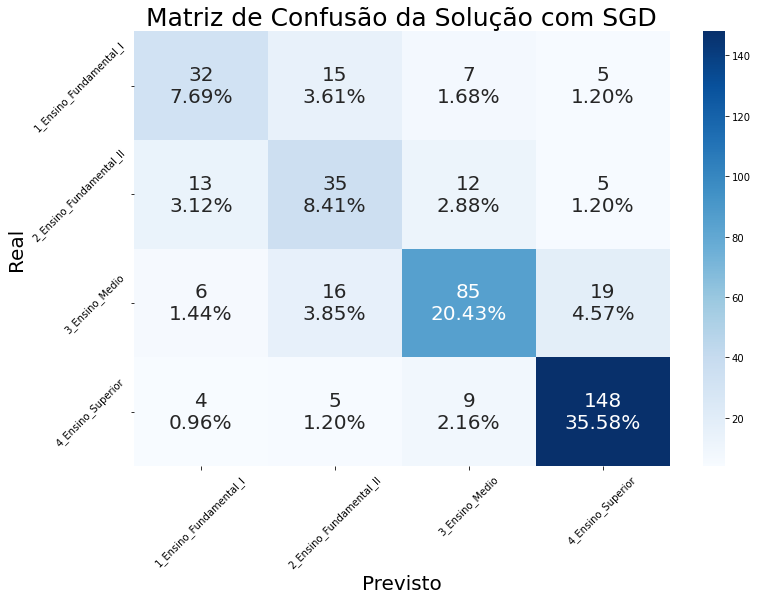

In [126]:
# Apresentando a matriz de confusão
num_classes = len(encoder.classes_)
group_counts = ['{0:0.0f}'.format(value) for value in cf_matrix_clf_sgd_hcv.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix_clf_sgd_hcv.flatten() / np.sum(cf_matrix_clf_sgd_hcv)]
labels = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts, group_percentages)]
labels = np.asarray(labels).reshape(num_classes, num_classes)

plt.figure(figsize=(12,8))
ax = sns.heatmap(df_cf_matrix_clf_sgd_hcv, annot=labels, fmt='', cmap='Blues', annot_kws={"size": 20})
ax.set_title("Matriz de Confusão da Solução com SGD", fontsize=25)
ax.set_xlabel('Previsto', fontsize=20)
ax.set_ylabel('Real', fontsize=20)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_yticklabels(ax.get_yticklabels(), rotation=45)

plt.plot()
plt.savefig('matriz_confusao_sgd.png')

In [127]:
# Apresentando um relatório completo da classificação executada
print(classification_report(y_test_hcv, y_pred_sgd_test_hcv))

              precision    recall  f1-score   support

           0       0.58      0.54      0.56        59
           1       0.49      0.54      0.51        65
           2       0.75      0.67      0.71       126
           3       0.84      0.89      0.86       166

    accuracy                           0.72       416
   macro avg       0.67      0.66      0.66       416
weighted avg       0.72      0.72      0.72       416



In [128]:
main_classifiers = ['MLP', 'SGD', 'K-NN']

main_classifiers

['MLP', 'SGD', 'K-NN']

In [129]:
y_preds_train = [
    y_pred_mlp_train_hcv,
    y_pred_sgd_train_hcv,
    y_pred_knn_train_hcv
]

y_preds_test = [
    y_pred_mlp_test_hcv,
    y_pred_sgd_test_hcv,
    y_pred_knn_test_hcv
]

bac_pre_tunning = []
bac_pos_tunning = []
for index, model in enumerate(main_classifiers):
    print(model)
    print('BAC Pré-Tunning:', 'treino', classifiers_train_mean_ranking.loc[model], 'teste', classifiers_test_ranking.loc[model])
    print('BAC Pós-Tunning:', 'treino', balanced_accuracy_score(y_train_hcv, y_preds_train[index]), 'teste', balanced_accuracy_score(y_test_hcv, y_preds_test[index]))
    print()

MLP
BAC Pré-Tunning: treino 0.903420008783357 teste 0.8804012099805442
BAC Pós-Tunning: treino 0.7115464851139799 teste 0.7285431538035173

SGD
BAC Pré-Tunning: treino 0.9006288850303138 teste 0.8876672518596145
BAC Pós-Tunning: treino 0.6971566760323498 teste 0.6617509648702216

K-NN
BAC Pré-Tunning: treino 0.8221172639006701 teste 0.8039524647294711
BAC Pós-Tunning: treino 0.657816868702737 teste 0.6218937524481736



## [TECD] Solução 2: Sistemas Nebulosos (Fuzzy)

### Pipelines de Sistemas Fuzzy

<p align="center">
  <img src="Imagens/diagrama_solucao_fuzzy.png" />
</p>

### Importação das Bibliotecas

In [130]:
# Instalando as bibliotecas necessárias
!pip install unidecode
!pip install nltk
!pip install wordcloud
!pip install sklearn
!pip install scikit-fuzzy
!pip install graphviz

In [131]:
# Baixando as listas de stopwords da biblioteca NLTK
import nltk
nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/nelsondressler/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/nelsondressler/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [132]:
# Importando bibliotecas de uso geral
import os
import sys
import random
import zipfile
import warnings
import re
from unidecode import unidecode

# Importando bibliotecas de manipulação e visualização de dados
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import graphviz

# Importando bibliotecas de técnicas de selação de modelos (holdout e busca aleatória)
from sklearn.model_selection import train_test_split, KFold

# Importando bibliotecas de técnicas de pré-processamento, extração e seleção de características e redução de dimensionalidade
from sklearn.preprocessing import LabelEncoder, KBinsDiscretizer, FunctionTransformer
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer, ENGLISH_STOP_WORDS
from sklearn.feature_selection import SelectKBest, chi2, f_classif, mutual_info_classif

# Importando bibliotecas de classificação
from sklearn.tree import DecisionTreeClassifier, export_graphviz, plot_tree, export_text, _tree
from sklearn.ensemble import RandomForestClassifier

# Importando biblioteca de estruturação de etapas de análise preditiva
from sklearn.pipeline import Pipeline

# Importando biblioteca de métricas de desempenho de técnicas de machine learning
from sklearn.metrics import confusion_matrix, classification_report, balanced_accuracy_score

# Importando bibliotecas de manipulação de processamento de linguagem natural
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.stem.snowball import PortugueseStemmer, PorterStemmer
from wordcloud import WordCloud

# Importando biblioteca de criação de sistema de informação com lógica nebulosa
import skfuzzy as fuzz
from skfuzzy import control as ctrl

# Importando bibliotecas específicas ao Google Colab
try:
    from google.colab import files, drive
    import google.colab
    drive.mount('/content/drive')
    IN_COLAB = True
except:
    IN_COLAB = False

In [133]:
# Definindo as constantes utilizadas ao longo da análise

SEED = 42 # semente aleatória para os experimentos
FRAC_DATA = 1 # fração dos dados originais a ser obtida

### Abertura dos Dados

In [134]:
sh = """
FILE=/content/drive/MyDrive/'Area de Trabalho'/'ECD - UTFPR-DV'/TCC/corpus_readability_nlp_portuguese-master.zip
if test -f "$FILE"; then
    echo "$FILE exists."
    cp /content/drive/MyDrive/'Area de Trabalho'/'ECD - UTFPR-DV'/TCC/corpus_readability_nlp_portuguese-master.zip /content/
else
    echo "$FILE not exists."
fi
"""
with open('copy_zip_local.sh', 'w') as file:
  file.write(sh)

!bash copy_zip_local.sh

/content/drive/MyDrive/Area de Trabalho/ECD - UTFPR-DV/TCC/corpus_readability_nlp_portuguese-master.zip not exists.


In [135]:
# Submetendo os arquivos de texto do dataset no Google Colab
# Dados obtidos a partir de: https://github.com/gazzola/corpus_readability_nlp_portuguese
if not os.path.isfile('corpus_readability_nlp_portuguese-master.zip') and IN_COLAB:
    uploaded = files.upload()

In [136]:
# Obtendo o caminho dos dados
caminho_projeto = os.getcwd()
caminho_dados = os.path.join(caminho_projeto, 'corpus_readability_nlp_portuguese-master.zip')

# Abrindo o arquivo zipado e salvando os respectivos conteúdos e disciplinas
conteudos = []
graus = []
caminhos = []
with zipfile.ZipFile(caminho_dados) as arquivos_zip:
    universo_escolaridade = [os.path.basename(os.path.normpath(arquivo)) for arquivo in arquivos_zip.namelist() if arquivo.endswith('/') and re.search(r'\d+', arquivo)]

    nomes_arquivos = [
        (grau, caminho_arquivo)
        for grau in universo_escolaridade
        for caminho_arquivo in arquivos_zip.namelist()
        if grau in caminho_arquivo and '.txt' in caminho_arquivo and not '._' in caminho_arquivo
    ]
    for grau, caminho_arquivo in nomes_arquivos:
        arquivo_zip = arquivos_zip.open(caminho_arquivo)
        conteudos.append(arquivo_zip.read().decode('utf-8', errors='ignore'))
        graus.append(grau)
        caminhos.append(caminho_arquivo)

In [137]:
# Salvando os conteúdos e disciplinas num dicionário
dict_textos_escolares = {
    'caminho': caminhos,
    'conteudo_original': conteudos,
    'classe': graus
}

# Criando um dataframe a partir do dicionário
df_textos_escolares = pd.DataFrame(dict_textos_escolares)

In [138]:
# Retirando uma amostra dos dados para fins de teste
np.random.seed(SEED)
# df_textos_escolares = df_textos_escolares.groupby('classe', group_keys=False).apply(pd.DataFrame.sample, n=50)
df_textos_escolares = df_textos_escolares.groupby('classe', group_keys=False).apply(pd.DataFrame.sample, frac=FRAC_DATA)

df_textos_escolares

,caminho,conteudo_original,classe
167,corpus_readability_nlp_portuguese-master/1_Ens...,"Você pode começar pelos mais conhecidos, como...",1_Ensino_Fundamental_I
211,corpus_readability_nlp_portuguese-master/1_Ens...,"Por isso, nunca use pedaços de radiografias, ...",1_Ensino_Fundamental_I
63,corpus_readability_nlp_portuguese-master/1_Ens...,Isso resultou também em mudanças na sua estru...,1_Ensino_Fundamental_I
154,corpus_readability_nlp_portuguese-master/1_Ens...,﻿Você já viajou de avião? Já olhou pela janeli...,1_Ensino_Fundamental_I
5,corpus_readability_nlp_portuguese-master/1_Ens...,Essa bactéria fica grudadinha com muitas outr...,1_Ensino_Fundamental_I
...,...,...,...
1749,corpus_readability_nlp_portuguese-master/4_Ens...,Num armazém a tábuas de ligação transversal d...,4_Ensino_Superior
1302,corpus_readability_nlp_portuguese-master/4_Ens...,Mecânica dos fluidos/Exercícios resolvidos/C5\...,4_Ensino_Superior
1475,corpus_readability_nlp_portuguese-master/4_Ens...,Otimização/Índice remissivo\nNesta página estã...,4_Ensino_Superior
1983,corpus_readability_nlp_portuguese-master/4_Ens...,Esse recurso possibilita a implementação efic...,4_Ensino_Superior


### Análise Exploratória de Dados (EDA)

In [139]:
# Apresentando uma amostra dos dados
df_textos_escolares.head()

,caminho,conteudo_original,classe
167,corpus_readability_nlp_portuguese-master/1_Ens...,"Você pode começar pelos mais conhecidos, como...",1_Ensino_Fundamental_I
211,corpus_readability_nlp_portuguese-master/1_Ens...,"Por isso, nunca use pedaços de radiografias, ...",1_Ensino_Fundamental_I
63,corpus_readability_nlp_portuguese-master/1_Ens...,Isso resultou também em mudanças na sua estru...,1_Ensino_Fundamental_I
154,corpus_readability_nlp_portuguese-master/1_Ens...,﻿Você já viajou de avião? Já olhou pela janeli...,1_Ensino_Fundamental_I
5,corpus_readability_nlp_portuguese-master/1_Ens...,Essa bactéria fica grudadinha com muitas outr...,1_Ensino_Fundamental_I


In [140]:
# Apresentando as dimensões do dataset
df_textos_escolares.shape

(2076, 3)

In [141]:
# Apresentando as informações das colunas (nome, quantidade de valores não nulos, tipos)
df_textos_escolares.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2076 entries, 167 to 1505
Data columns (total 3 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   caminho            2076 non-null   object
 1   conteudo_original  2076 non-null   object
 2   classe             2076 non-null   object
dtypes: object(3)
memory usage: 64.9+ KB


In [142]:
# Apresentando as quantidades de registros por classe
df_textos_escolares['classe'].value_counts()

4_Ensino_Superior          826
3_Ensino_Medio             628
2_Ensino_Fundamental_II    325
1_Ensino_Fundamental_I     297
Name: classe, dtype: int64

In [143]:
# Apresentando as porcentagens de registros por classe
df_textos_escolares['classe'].value_counts(normalize=True)

4_Ensino_Superior          0.397881
3_Ensino_Medio             0.302505
2_Ensino_Fundamental_II    0.156551
1_Ensino_Fundamental_I     0.143064
Name: classe, dtype: float64

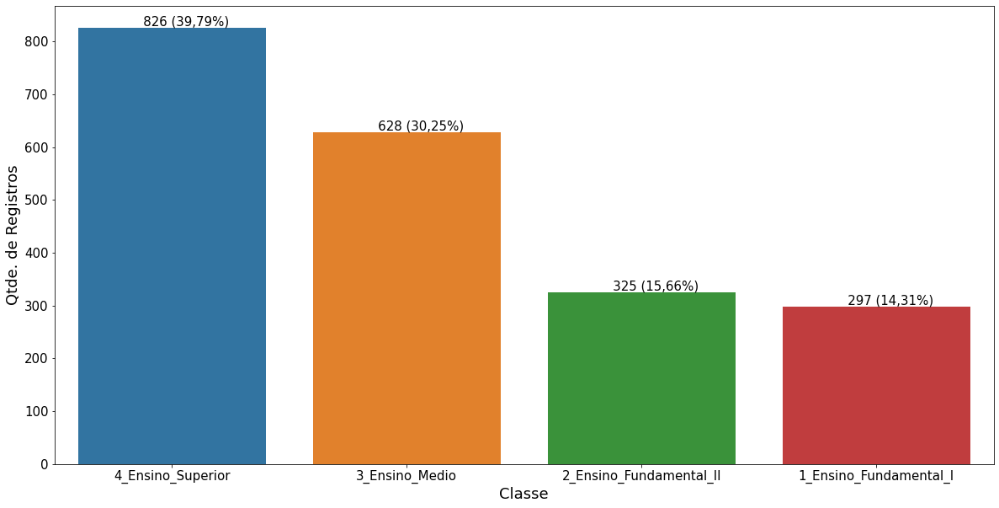

In [144]:
# Apresentando a proporção e balanceamento entre classes
plt.figure(figsize=(20, 10))

total = df_textos_escolares.shape[0]
labels = ['{:10d} ({:,.2%})'.format(x, x / total).replace('.', ',') for x in df_textos_escolares['classe'].value_counts()]
# labels = [x for x in df_textos_escolares['classe'].value_counts()]

ax = sns.countplot(x='classe', data=df_textos_escolares, order=df_textos_escolares['classe'].value_counts().index)
ax.bar_label(ax.containers[0], labels=labels, size=15)

# for p in ax.patches:
#     label = '{:1d} ({:.2f}%)'.format(p.get_height(), 100 * p.get_height() / total)
#     x = (p.get_x() + (p.get_width() / 2))
#     y = p.get_height() + 10
#     ax.annotate(label, (x, y), ha='center', size=15)    

ax.set_xticklabels(df_textos_escolares['classe'].value_counts().index, size=15)
ax.set_yticklabels(ax.get_yticks().astype(int), size=15)

plt.ylabel('Qtde. de Registros', size=18)
plt.xlabel('Classe', size=18)
plt.show()

In [145]:
re_quebras = r'\r|\t|\n|\d'
re_caracteres_especiais = r'[^A-Za-z\s]+'
re_palavra_pequena = r'\W*\b\w{1,3}\b'
re_multiplos_espacos = r'\s+'

# Removendo caracteres desnecessários (quebras de linha, tabs, caracteres especiais, pontuações, espaços, acentos, etc) e palavras abaixo de quatro letras
df_textos_escolares['data'] = df_textos_escolares['conteudo_original']\
    .apply(lambda x : unidecode(x).lower())\
    .replace(re_quebras, ' ', regex=True)\
    .replace(re_caracteres_especiais, ' ', regex=True)\
    .replace(re_palavra_pequena, ' ', regex=True)\
    .replace(re_multiplos_espacos, ' ', regex=True)\
    .str.strip()

In [146]:
df_textos_escolares['qtd_palavras'] = df_textos_escolares['data'].str.split().str.len()

In [147]:
df_textos_escolares['qtd_palavras'].describe()

count    2076.000000
mean      233.613198
std        57.300327
min       134.000000
25%       193.000000
50%       212.000000
75%       261.000000
max       632.000000
Name: qtd_palavras, dtype: float64

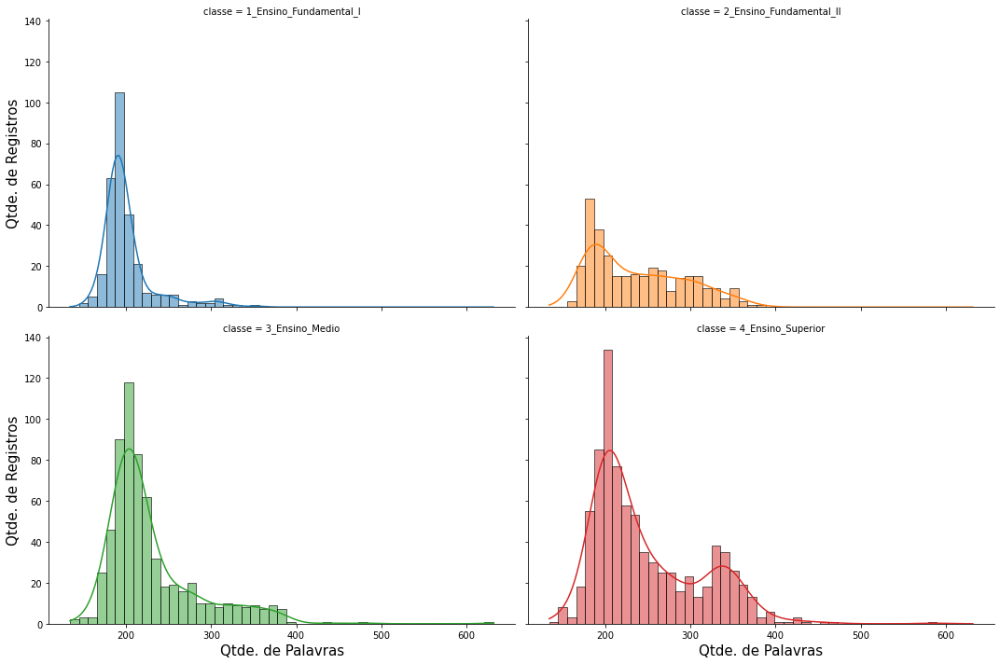

In [148]:
# Apresentando a distribuição de palavras por documento entre classes antes do descarte de palavras vazias
ax = sns.displot(data=df_textos_escolares, x='qtd_palavras', hue='classe', col='classe', col_wrap=2, multiple="stack", kde=True, legend=False)
ax.fig.set_figwidth(15)
ax.fig.set_figheight(10)
ax.set_xlabels('Qtde. de Palavras', size=15)
ax.set_ylabels('Qtde. de Registros', size=15)
plt.tight_layout()
plt.show()

In [149]:
# Criando um conversor de dados categóricos para dados numéricos para as classes
encoder = LabelEncoder()

# Transformando os dados categóricos das classes em numéricos
df_textos_escolares['target'] = encoder.fit_transform(df_textos_escolares['classe'])

# Obtendo um dicionário de índices e classes
target_map = dict(enumerate(encoder.classes_))

target_map

{0: '1_Ensino_Fundamental_I',
 1: '2_Ensino_Fundamental_II',
 2: '3_Ensino_Medio',
 3: '4_Ensino_Superior'}

In [150]:
classes = list(target_map.values())

classes

['1_Ensino_Fundamental_I',
 '2_Ensino_Fundamental_II',
 '3_Ensino_Medio',
 '4_Ensino_Superior']

In [151]:
# Obtendo os conteúdo limpos de cada classe num array do numpy 
X_classes = []
for classe in classes:
    X_classe = df_textos_escolares[df_textos_escolares['classe'] == classe]['data'].values
    X_classes.append(X_classe)

In [152]:
X_classes_gen = (x for x in X_classes)

X_classes_gen

<generator object <genexpr> at 0x7fee20b86b30>

In [153]:
# Apresentando um exemplo de texto no grau 1_Ensino_Fundamental_I
pd.DataFrame(next(X_classes_gen)).sample(random_state=SEED).iloc[0, 0]

'isso ajudar fazer escolhas tirar conclusoes desenvolver novas ideias concentrar mais encontrar solucoes momentos importantes vida carteiros pediram mais seguranca para entregar cartas eles reclamam muitas pessoas deixam caes soltos proximos caixa correspondencia correndo risco atacarem bracos deles alem disso algumas casas carteiros dizem portoes ficam abertos permitindo cachorros ataquem maioria vezes brabo brinca criancas casa trata desconhecidos isso ajude seus pais trancar mascote para proteger nossos amigos carteiros protesto deles ocorreu porque dias carteiro atacado pitbulls ficando machucado pernas bracos barriga lideres paises reunidos bali indonesia tentam diminuir emissao gases poluentes liberados pelas industrias pela circulacao veiculos principalmente para melhorar condicoes clima terra esses gases provocam aumento temperatura todo planeta problemas mais graves devera ocorrer segundo estudos geleiras artico poderao derreter para esse outros desequilibrios como aumento niv

In [154]:
# Apresentando um exemplo de texto no grau 2_Ensino_Fundamental_II
pd.DataFrame(next(X_classes_gen)).sample(random_state=SEED).iloc[0, 0]

'sociologia processo estudo sociedade sociologia preocupa serie aspectos influenciam existencia agrupamentos sujeitos sociais esses aspectos melhor dizendo mecanismos caracteristicas especificas grupo social servem como ponto apoio para coesao seus diferentes integrantes entre diferentes mecanismos sustentacao grupo social destacaremos alguns pelo grau influencia exercem sobre grupo seus integrantes precisamos levar consideracao antes tudo sujeitos integram grupo social estao amarrados fatalmente condenados submeterem esses mecanismos possuem individualidade capacidade ainda fortes ameacas sancoes negativas como veremos escolher criar meio convivencia acordo suas necessidades desejos lideranca possivelmente maiores catalizadores mobilizacoes sociais podemos observar debaixo lideranca grupos sociais organizam diante ideal comum nome resolucao varios problemas qualquer outro tipo acao autor alemao weber dedicou estudar formas dominacao sociedade democratica consequentemente formas como l

In [155]:
# Apresentando um exemplo de texto no grau 3_Ensino_Medio
pd.DataFrame(next(X_classes_gen)).sample(random_state=SEED).iloc[0, 0]

'prolongamentos direcao interior celula prendem membrana plasmatica placa desmossoma prolongamentos para meio extracelular ligam fibras desmossoma celula vizinha moleculas caderinas desmocolina desmogleina celula ligam caderinas celula vizinha atraves ligacao homofilica seja ligam moleculas mesmo tipo vindas celula adjacente exemplo desmocolina desmocolina desmogleina desmogleina ligacao dessas moleculas depende concentracao ions meio extracelular caso esteja baixa concentracao caderinas mudam conformacao causando ruptura ligacao consequentemente separacao celulas pelo fato garantir adesao forte celula celula desmossomas deixam camada celular mais rigida resistente estavel sendo isso encontrados grande quantidade tecidos epiteliais submetidos constante tracao atrito como exemplo pele mucosa revestimento lingua estomago tambem encontrados celulas musculo cardiaco membranas meninges revestem cerebro medula espinhal celulas sofrem transformacao maligna celulas cancerosas desmossomas apare

In [156]:
# Apresentando um exemplo de texto no grau 4_Ensino_Superior
pd.DataFrame(next(X_classes_gen)).sample(random_state=SEED).iloc[0, 0]

'logistica gestao armazens picking organizacao actividade picking actividade separacao preparacao pedidos grande intensidade termos movimentacao materiais dependendo tipo armazem cerca custo total desse armazem esta directamente associado essa mesma actividade situacao verifica pois tempo associado essa actividade numero trabalhadores maiores outras actividades armazenagem atraves estudos sistemas separacao pedidos mais usuais onde temos grande utilizacao operacoes deslocamento recolha produtos documentos papel obtemos informacoes como tempo operador nessa actividade gasto medeiros objectivo fundamental para produtividade sistema separacao pedidos minimizacao tempos deslocamento movimentacao observamos utilizacao tempo parte operador actividade picking verifica grande parte tempo gasto pelos operadores encontra movimentacao para recolha colocacao produtos linha picking maneira como organizamos estrategia picking esta directamente associada tempo deslocamento estrategia picking entendem

In [157]:
# Criando uma função de plotagem de nuvem de palavras
def plot_cloud(wordcloud):
    # Set figure size
    plt.figure(figsize=(40, 30))
    # Display image
    plt.imshow(wordcloud) 
    # No axis details
    plt.axis("off")

In [158]:
# Obtendo a lista stopwords do idioma português 
# stopwords_pt_br = stopwords.words('portuguese')
stopwords_pt_br = [unidecode(x) for x in stopwords.words('portuguese')]
# Definindo a função de stemização
portuguese_stemmer = PortugueseStemmer()
porter_stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()
# Criando uma função no analisador do vetorizador do scikit-learn
analyzer = CountVectorizer().build_analyzer()

# Criando a função de stemização a ser utilizada
def stemed_words(doc):
    return (lemmatizer.lemmatize(w, pos="v") for w in analyzer(doc))

In [159]:
X_classes_gen = (x for x in X_classes)

X_classes_gen

<generator object <genexpr> at 0x7fee420270b0>

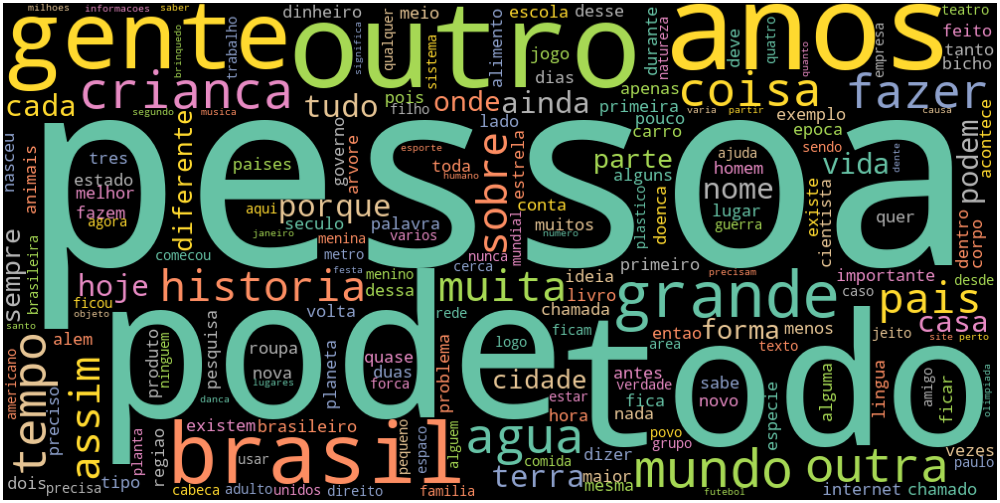

In [160]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 1_Ensino_Fundamental_I
wordcloud_fundamental1 = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    stopwords=stopwords_pt_br
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_fundamental1)

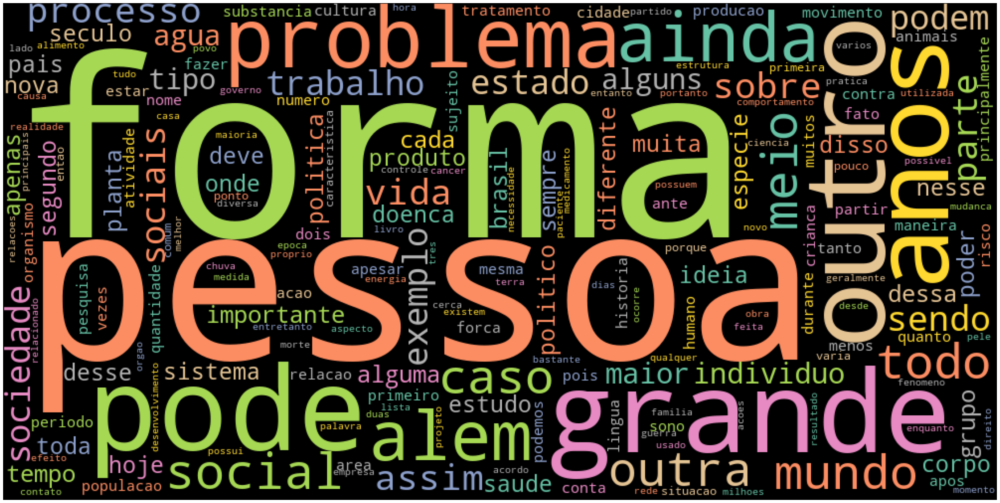

In [161]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 2_Ensino_Fundamental_II
wordcloud_fundamental2 = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    stopwords=stopwords_pt_br
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_fundamental2)

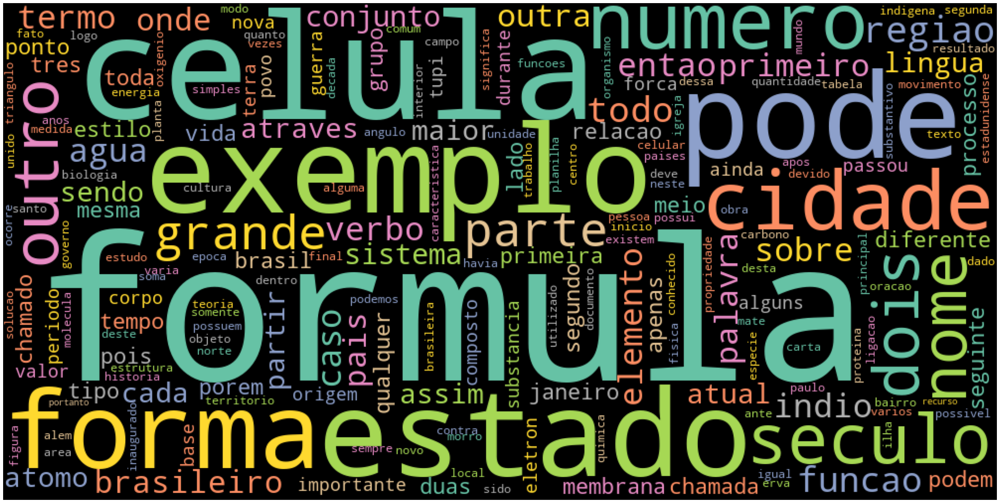

In [162]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 3_Ensino_Medio
wordcloud_medio = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    stopwords=stopwords_pt_br
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_medio)

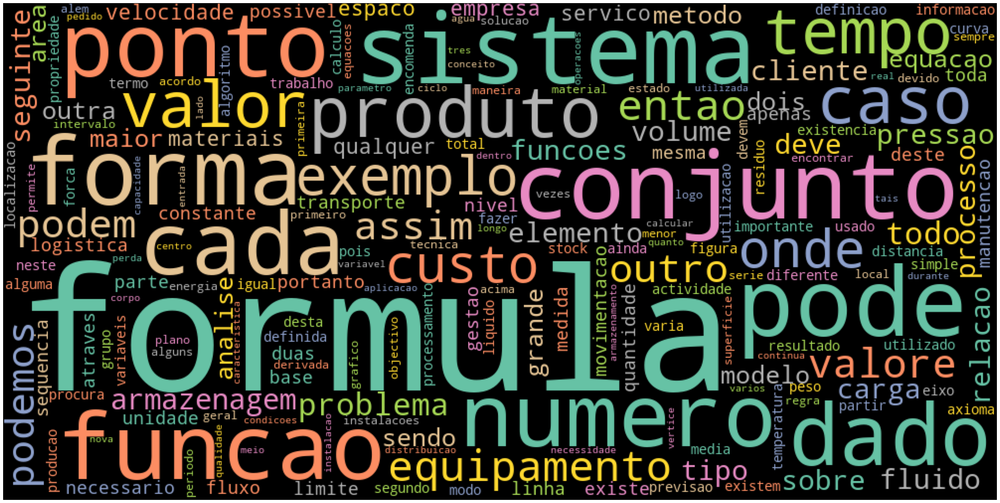

In [163]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 4_Ensino_Superior
wordcloud_superior = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    stopwords=stopwords_pt_br
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_superior)

In [164]:
termos_irrelevantes = [
    'abaixo',
    'acima',
    'acordo',
    'ainda',
    'alem',
    'alguem',
    'algum',
    'alguma',
    'algumas',
    'alguns',
    'anterior',
    'antes',
    'apenas',
    'aquela',
    'aquelas',
    'aquele',
    'aqueles',
    'aqui',
    'aquilo',
    'assim',
    'atraves',
    'atual',
    'atualmente',
    'baixa',
    'baixo',
    'bem',
    'cada',
    'caso',
    'cima',
    'cinco',
    'coisa',
    'coisas',
    'conta',
    'dado',
    'define',
    'definem',
    'definicao',
    'definida',
    'definidas',
    'definido',
    'definidos'
    'definir',
    'depois',
    'desde',
    'deste',
    'destes',
    'desta',
    'destas',
    'desse',
    'desses',
    'dessa',
    'dessas',
    'deve',
    'devem',
    'dez',
    'diagrama',
    'disso',
    'dois',
    'duas',
    'durante',
    'ela',
    'elas',
    'ele',
    'eles',
    'enquanto',
    'entao',
    'entretanto',
    'este',
    'estes',
    'esta',
    'estas',
    'estao',
    'esse',
    'esses',
    'essa',
    'essas',
    'eu',
    'esta',
    'estando',
    'estao',
    'estar',
    'estava',
    'estavam',
    'exemplo',
    'explicacao',
    'fato',
    'faz',
    'fazem',
    'fazer',
    'feito',
    'fica',
    'ficam',
    'ficado',
    'ficando',
    'ficar',
    'figura',
    'forma',
    'gente',
    'geral',
    'geralmente',
    'grande',
    'grandes',
    'hoje',
    'imagem',
    'isto',
    'isso',
    'lado',
    'logo',
    'mal',
    'meio',
    'mesma',
    'mesmas',
    'mesmo',
    'mesmos',
    'muita',
    'muitas',
    'muito',
    'muitos',
    'mundo',
    'nada',
    'nao',
    'necessaria',
    'necessariamente',
    'necessarias',
    'necessario',
    'necessarios',
    'nessa',
    'nessas',
    'nesse',
    'nesses',
    'nesta',
    'nestas',
    'neste',
    'nestes',
    'nos',
    'nove',
    'nunca',
    'oito',
    'outra',
    'outras',
    'onde',
    'outro',
    'outros',
    'parte',
    'partir',
    'pequena',
    'pequenas',
    'pequeno',
    'pequenos',
    'permite',
    'permitem',
    'permitindo',
    'permitir',
    'pessoa',
    'pessoas',
    'pode',
    'podem',
    'podemos',
    'podendo',
    'pois',
    'por',
    'porem',
    'porque',
    'pouca',
    'poucas',
    'pouco',
    'poucos',
    'primeira',
    'primeiras',
    'primeiro',
    'primeiros',
    'qualquer',
    'quase',
    'quando',
    'quanto',
    'quatro',
    'que',
    'sao',
    'seguinte',
    'segundo',
    'seis',
    'sempre',
    'sendo',
    'ser',
    'sera',
    'serao',
    'serem',
    'serie',
    'sete',
    'sido',
    'sim',
    'somente',
    'sobre',
    'tabela',
    'tais',
    'talvez',
    'tambem',
    'tanto',
    'tal',
    'ter',
    'tem',
    'tendo',
    'tido',
    'toda',
    'todas',
    'todo',
    'todos',
    'tudo',
    'tres',
    'tu',
    'um',
    'uma',
    'umas',
    'uns',
    'usa',
    'usam',
    'usando',
    'usar',
    'utiliza',
    'utilizam',
    'utilizando',
    'utilizar',
    'vai',
    'varias',
    'varios',
    'vez',
    'vezes',
    'voce',
    'voces',
    'vos',
    'vossa',
    'vossas',
    'vou'
 ]

In [165]:
df_textos_escolares['qtd_palavras_processadas'] = df_textos_escolares['data'].str.split().apply(lambda lista: set(lista) - set(stopwords_pt_br + termos_irrelevantes)).str.len()

In [166]:
df_textos_escolares['qtd_palavras_processadas'].describe()

count    2076.000000
mean      128.587187
std        35.136616
min        38.000000
25%       105.000000
50%       124.000000
75%       146.000000
max       331.000000
Name: qtd_palavras_processadas, dtype: float64

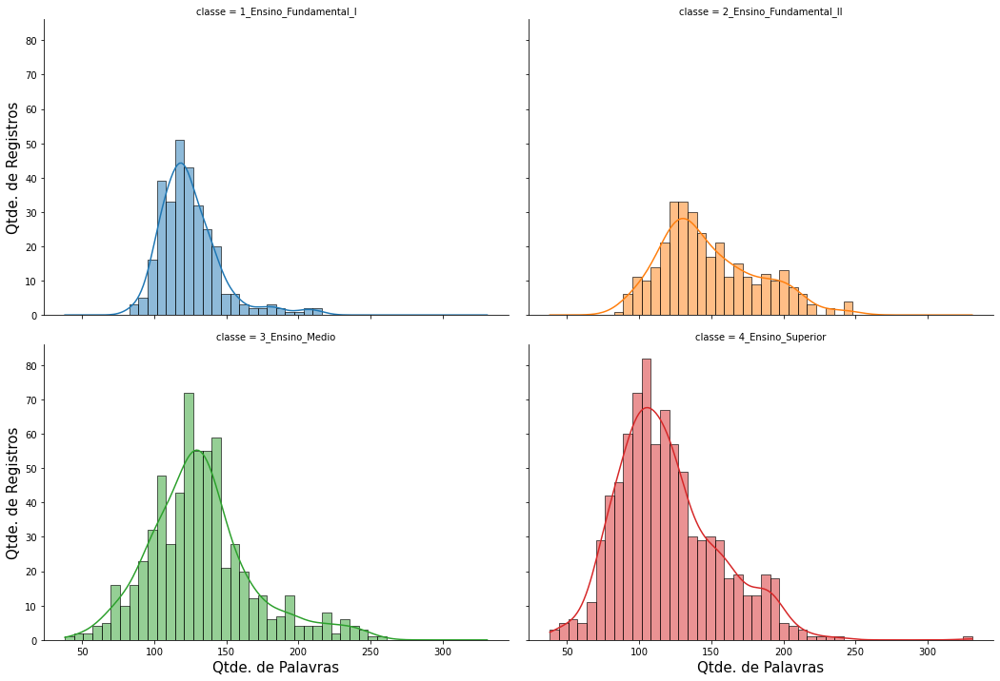

In [167]:
# Apresentando a distribuição de palavras por documento entre classes após do descarte de palavras vazias
ax = sns.displot(data=df_textos_escolares, x='qtd_palavras_processadas', hue='classe', col='classe', col_wrap=2, multiple="stack", kde=True, legend=False)
ax.fig.set_figwidth(15)
ax.fig.set_figheight(10)

ax.set_xlabels('Qtde. de Palavras', size=15)
ax.set_ylabels('Qtde. de Registros', size=15)
plt.show()

In [168]:
dict_wordclouds = dict()
for dict_wordcloud in [wordcloud_fundamental1.words_, wordcloud_fundamental2.words_, wordcloud_medio.words_, wordcloud_superior.words_]:
    dict_wordclouds.update(dict_wordcloud)
    
dict_wordclouds

{'pessoa': 0.125764192139738,
 'pode': 0.12720403022670027,
 'todo': 0.05816349896954431,
 'anos': 0.09344978165938865,
 'outro': 0.06354476757499428,
 'gente': 0.6435331230283912,
 'brasil': 0.16943231441048034,
 'grande': 0.04305014884359973,
 'mundo': 0.125764192139738,
 'crianca': 0.25825825825825827,
 'agua': 0.01969315319441264,
 'outra': 0.04293565376688802,
 'coisa': 0.4921135646687697,
 'tempo': 0.07923059308449737,
 'fazer': 0.022670025188916875,
 'historia': 0.11353711790393013,
 'pais': 0.21921397379912663,
 'muita': 0.29429429429429427,
 'sobre': 0.052324250057247536,
 'assim': 0.06205633157774216,
 'porque': 0.1981981981981982,
 'tudo': 0.15015015015015015,
 'terra': 0.14148471615720523,
 'ainda': 0.02862376917792535,
 'hoje': 0.29429429429429427,
 'casa': 0.16516516516516516,
 'cada': 0.1060224410350355,
 'nome': 0.30305676855895197,
 'podem': 0.06125486604076025,
 'vida': 0.14497816593886462,
 'onde': 0.073620334325624,
 'parte': 0.03801236546828486,
 'sempre': 0.020494

In [169]:
X_classes_gen = (x for x in X_classes)

X_classes_gen

<generator object <genexpr> at 0x7fee42027970>

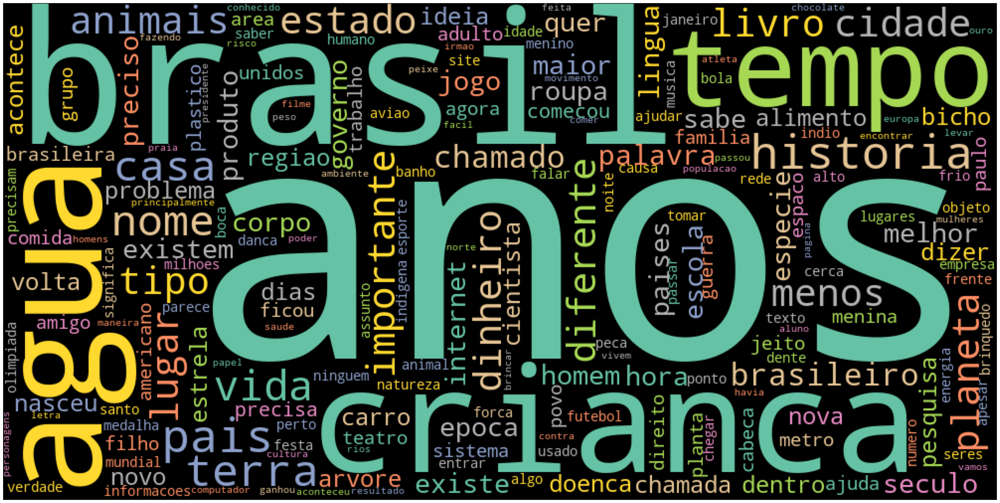

In [170]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 1_Ensino_Fundamental_I
wordcloud_fundamental1 = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    # stopwords=stopwords_pt_br
    stopwords=stopwords_pt_br + termos_irrelevantes
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_fundamental1)

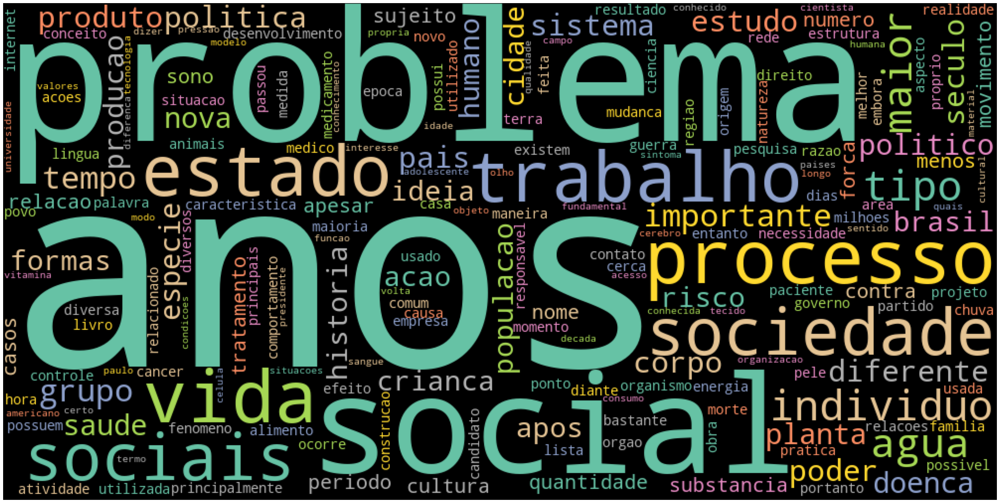

In [171]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 2_Ensino_Fundamental_II
wordcloud_fundamental2 = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    # stopwords=stopwords_pt_br
    stopwords=stopwords_pt_br + termos_irrelevantes
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_fundamental2)

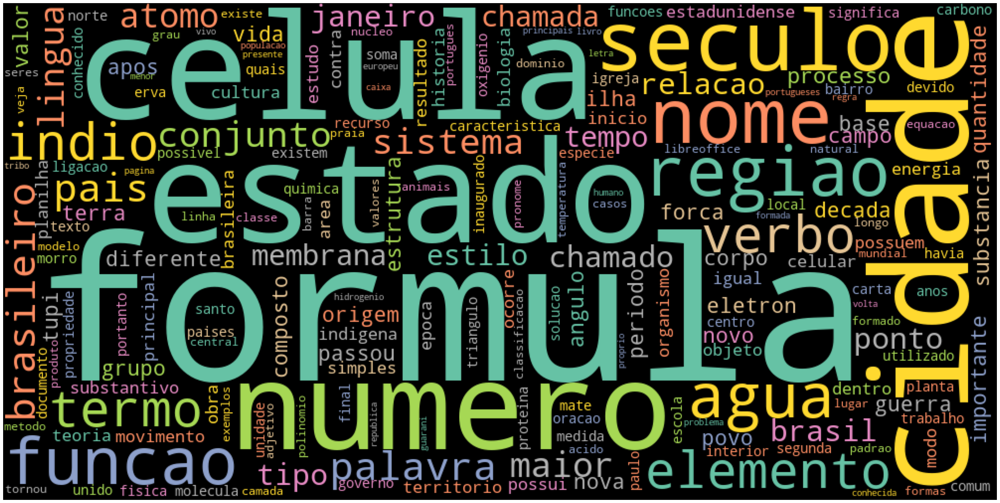

In [172]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 3_Ensino_Medio
wordcloud_medio = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    # stopwords=stopwords_pt_br
    stopwords=stopwords_pt_br + termos_irrelevantes
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_medio)

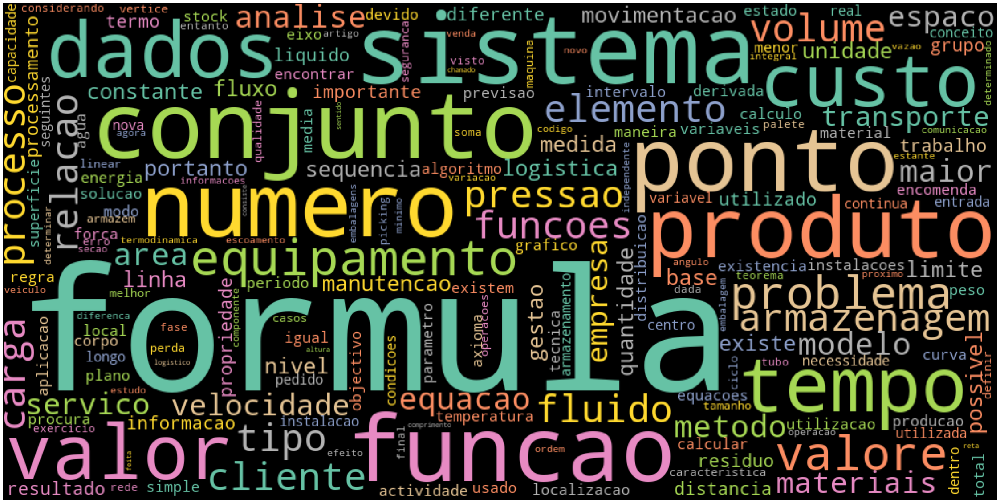

In [173]:
# Apresentando uma nuvem de palavras com os textos limpos no grau 4_Ensino_Superior
wordcloud_superior = WordCloud(
    width=1000,
    height=500,
    random_state=SEED,
    background_color='black',
    colormap='Set2',
    collocations=False,
    # stopwords=stopwords_pt_br
    stopwords=stopwords_pt_br + termos_irrelevantes
).generate(next(X_classes_gen).sum())

plot_cloud(wordcloud_superior)

### Amostragens

In [174]:
# Obtendo as variáveis preditoras e resposta do dataset
X, y = df_textos_escolares['data'].values, df_textos_escolares['target'].values

In [175]:
# Definindo os valor dos parâmetros de amostragem
# top_k_features = 10 # primeiras k características
top_k_features = 15 # primeiras k características

In [176]:
# Definindo os valor dos parâmetros de amostragem
params_holdout_cv = {
    'test_size': 0.2,
    'folds_size': 10,
    'bins': 2
}

In [177]:
# Separando os dados em conjunto de treinamento e teste (80-20) com estratificação por classes
X_train_hcv, X_test_hcv, y_train_hcv, y_test_hcv = train_test_split(
    X,
    y,
    test_size=params_holdout_cv['test_size'],
    stratify=y,
    shuffle=True,
    random_state=SEED
)

In [178]:
# Construindo o objeto de validação cruzada com divisão em 5 diferentes grupos
kfold = KFold(
    n_splits=params_holdout_cv['folds_size'],
    shuffle=True,
    random_state=SEED
)

### Pré-Processamento

In [179]:
# Construindo o pipeline de pré-processamento do dataset para a entrada sistema nebuloso (fuzzy)
pre_proc_fuzzy = Pipeline([
    # ('stopper', FunctionTransformer(lambda x: [' '.join([word for word in doc.split() if word not in stopwords_pt_br + termos_irrelevantes]) for doc in x])),
    # ('stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split()]) for doc in x])),('stopper_stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split() if word not in (set(stopwords_pt_br) | set(termos_irrelevantes))]) for doc in x])),
    ('stopper_stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split() if word not in (set(stopwords_pt_br) | set(termos_irrelevantes))]) for doc in x])),
    ('vectorizer', CountVectorizer()), # função vetorizadora de termos e frequências
    ('scorer', SelectKBest(chi2, k=top_k_features)), # função de seleção das melhores K características (termos) presentes no dataset a partir do teste estatístico qui-quadrado 
    ('tfidf', TfidfTransformer(use_idf=True)), # função de obtenção dos pesos a partir da técnica de TF-IDF
    ('to_dense', FunctionTransformer(lambda x: x.todense(), accept_sparse=True)) # função de conversão de uma matriz esparsa pra uma densa
])

In [180]:
# Aplicando as transformações sobre os dados de treinamento dos conteúdos limpos
X_train_transf_hcv = pre_proc_fuzzy.fit_transform(X_train_hcv, y_train_hcv)

# Criando um dataframe com os dados resultantes
df_train_transf_hcv = pd.DataFrame(X_train_transf_hcv)
df_train_transf_hcv['y'] = y_train_hcv

df_train_transf_hcv = df_train_transf_hcv.T.reset_index(drop=True).T

df_train_transf_hcv.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,0.0,0.0,0.000000,0.0,1.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,2.0
1,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.000000,0.0,0.0,0.724584,0.0,0.0,0.0,0.000000,0.689187,0.0,0.0,0.0,0.0,3.0
3,0.0,0.0,0.997695,0.0,0.0,0.000000,0.0,0.0,0.0,0.067853,0.000000,0.0,0.0,0.0,0.0,2.0
4,0.0,0.0,0.000000,0.0,0.0,0.000000,1.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,3.0


In [181]:
# Aplicando as transformações sobre os dados de teste dos conteúdos limpos
X_test_transf_hcv = pre_proc_fuzzy.transform(X_test_hcv)

# Criando um dataframe com os dados resultantes
df_test_transf_hcv = pd.DataFrame(X_test_transf_hcv)
df_test_transf_hcv['y'] = y_test_hcv

df_test_transf_hcv = df_test_transf_hcv.T.reset_index(drop=True).T

df_test_transf_hcv.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.551371,0.0,0.83426,0.0,2.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,1.0,0.00000,0.0,2.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.297727,0.0,0.0,0.0,0.352873,0.887040,0.0,0.00000,0.0,3.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.512419,0.858735,0.0,0.00000,0.0,3.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.0,2.0


In [182]:
# Apresentando uma amostra dos termos e pesos obtidos com a etapa de vetorização e seleção das k melhores características, respectivamente
try:
    features_vect_hcv = pre_proc_fuzzy.named_steps['vectorizer'].get_feature_names_out()
except:
    features_vect_hcv = pre_proc_fuzzy.named_steps['vectorizer'].get_feature_names()
scores_vect_hcv = pre_proc_fuzzy.named_steps['scorer'].scores_
initial = 0
final = len(features_vect_hcv)
limit = 20
superior_limit = limit
inferior_limit = final - limit
for i, (feature, score) in enumerate(zip(features_vect_hcv[initial:superior_limit], scores_vect_hcv[0:superior_limit])):
    print(f'[{i}] {feature}: {score}')
print('...')
for i, (feature, score) in enumerate(zip(features_vect_hcv[inferior_limit:final], scores_vect_hcv[inferior_limit:final])):
    id = len(features_vect_hcv) - 20 + i
    print(f'[{id}] {feature}: {score}')

[0] aalst: 2.3067729083665336
[1] aapt: 2.3067729083665336
[2] aatp: 2.3067729083665336
[3] abac: 17.92436974789916
[4] abacat: 5.974789915966386
[5] abacax: 7.131240114801667
[6] abad: 2.3067729083665336
[7] abaf: 1.5151515151515151
[8] abaix: 2.3067729083665336
[9] abaj: 2.3067729083665336
[10] abal: 2.646624233511976
[11] abandon: 24.242772384456984
[12] abaporu: 3.1407814121664606
[13] abar: 2.3067729083665336
[14] abarc: 4.613545816733067
[15] abarr: 3.0303030303030303
[16] abarrot: 5.384615384615384
[17] abas: 6.858596383695984
[18] abast: 6.615078148942689
[19] abastec: 22.851473404281776
...
[19015] zoogeograf: 2.3067729083665336
[19016] zookeep: 7.575757575757576
[19017] zookeerp: 1.5151515151515151
[19018] zoolog: 23.37703232767477
[19019] zoom: 4.613545816733067
[19020] zootropi: 5.974789915966386
[19021] zorn: 1.5151515151515151
[19022] zost: 5.384615384615384
[19023] zuhr: 2.3067729083665336
[19024] zulk: 5.384615384615384
[19025] zulu: 2.3067729083665336
[19026] zum: 4.61

In [183]:
# Apresentando os índices dos melhores termos selecionados
cols_hcv = pre_proc_fuzzy.named_steps['scorer'].get_support(indices=True)
cols_hcv

array([  975,  1332,  3198,  4125,  4594,  4750,  4772,  6539,  7721,
        7911, 10833, 14404, 16537, 16632, 18307])

In [184]:
# Apresentando os melhores termos selecionados
scores_kbest_hcv = [scores_vect_hcv[i] for i, score in enumerate(pre_proc_fuzzy.named_steps['scorer'].scores_) if i in cols_hcv]
scores_kbest_hcv

[548.9582311295397,
 657.1042315724275,
 728.6577221233163,
 751.7229388145204,
 618.0762586902018,
 634.7141444331294,
 739.3776312664854,
 636.8419092473173,
 8403.991683999528,
 606.4919955659232,
 838.925068946613,
 630.2172999860506,
 646.3055736855399,
 652.1783653273158,
 761.91229195906]

In [185]:
# Apresentando os melhores termos selecionados
features_kbest_hcv = [features_vect_hcv[i] for i, _ in enumerate(features_vect_hcv) if i in cols_hcv]
features_kbest_hcv

['anos',
 'armazenag',
 'celul',
 'conjunt',
 'crianc',
 'cust',
 'dad',
 'equip',
 'formul',
 'funca',
 'logist',
 'produt',
 'sistem',
 'social',
 'valor']

In [186]:
# Construindo um dicionário com os ídices e partições selecionadas
dict_features_kbest_hcv = {
    'Index': cols_hcv,
    'Partition': [0] * len(cols_hcv)
}

In [187]:
# Construindo um dataframe com as informações das características selecionadas
df_features_kbest_hcv = pd.DataFrame(dict_features_kbest_hcv)
df_features_kbest_hcv['Name'] = df_features_kbest_hcv.apply(lambda x: features_vect_hcv[x['Index']], axis=1)
df_features_kbest_hcv['Score'] = df_features_kbest_hcv.apply(lambda x: scores_vect_hcv[x['Index']], axis=1)

df_features_kbest_hcv

,Index,Partition,Name,Score
0,975,0,anos,548.958231
1,1332,0,armazenag,657.104232
2,3198,0,celul,728.657722
3,4125,0,conjunt,751.722939
4,4594,0,crianc,618.076259
5,4750,0,cust,634.714144
6,4772,0,dad,739.377631
7,6539,0,equip,636.841909
8,7721,0,formul,8403.991684
9,7911,0,funca,606.491996


### Obtenção das Regras Fuzzy

In [188]:
# Construindo o pipeline de transformações e obtenção das regras nebulosas (fuzzy) a partir de uma árvore de decisão
especialista = Pipeline([
    # ('stopper', FunctionTransformer(lambda x: [' '.join([word for word in doc.split() if word not in stopwords_pt_br + termos_irrelevantes]) for doc in x])),
    # ('stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split()]) for doc in x])),
    ('stopper_stemmer', FunctionTransformer(lambda x: [' '.join([portuguese_stemmer.stem(word) for word in doc.split() if word not in (set(stopwords_pt_br) | set(termos_irrelevantes))]) for doc in x])),
    ('vectorizer', CountVectorizer()), # função vetorizadora de termos e frequências
    ('tfidf', TfidfTransformer(use_idf=True)), # função de obtenção dos pesos a partir da técnica de TF-IDF
    ('to_dense', FunctionTransformer(lambda x: x.todense(), accept_sparse=True)), # função de conversão de uma matriz esparsa pra uma densa
    ('discretizer', KBinsDiscretizer(encode='ordinal', strategy='uniform')), # função de discretização de valores com base nas opções baixo (0) e alto (1)
    ('classify', DecisionTreeClassifier(random_state=SEED, max_depth=6)) # função de classificação com a criação de uma árvore de decisão para a obtenção das regras
])

In [189]:
warnings.filterwarnings("ignore")

In [190]:
# Criando uma função geradora de uma pseudo-função para as regras nebulosas (fuzzy)
# Código adaptado de: https://mljar.com/blog/extract-rules-decision-tree/
def tree_to_fuzzy_rule_low_high(tree, feature_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]
    feature_names = [f.replace(" ", "_") for f in feature_names]
    # print("def show_rules({}):".format(", ".join(feature_names)))
    print("def show_rules_low_high({}):".format(", ".join(feature_names)))
    
    def recurse(node, depth):
        indent = "    " * depth
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            if tree_.threshold[node] == 0.5:
                threshold = 'low'
            # elif tree_.threshold[node] == 1.0 or tree_.threshold[node] == 1.5:
            #     threshold = 'medium'
            else:
                threshold = 'high'
            # print("{}[{}]if {} <= {}:".format(indent, node, name, threshold))
            print("{}[{}] if {} == {}:".format(indent, node, name, threshold))
            recurse(tree_.children_left[node], depth + 1)

            if tree_.threshold[node] == 0.5:
                # threshold = 'medium'
                threshold = 'high'
            # elif tree_.threshold[node] == 1.0 or tree_.threshold[node] == 1.5:
            #     threshold = 'high'
            else:
                # threshold = 'high'
                threshold = 'low'

            # print("{}[{}]elif {} >= {}:".format(indent, node, name, threshold))
            print("{}[{}] elif {} == {}:".format(indent, node, name, threshold))
            recurse(tree_.children_right[node], depth + 1)
        else:
            class_label = tree_.value[node].argmax()
            print("{}[{}] return {}".format(indent, node, target_map[class_label]))

    recurse(0, 1)

In [191]:
# Código adaptado de: https://www.geeksforgeeks.org/given-a-binary-tree-print-all-root-to-leaf-paths/
# Criando uma função geradora de cada caminho da árvore recursivamente
def set_matrix_paths_rec(matrix_paths, root, i, path, pathLen):
    # Base condition - if binary tree is empty return
    if root is None:
        return
 
    # if length of list is gre
    if(len(path) > pathLen):
        path[pathLen] = i
    else:
        path.append(i)
 
    # increment pathLen by 1
    pathLen = pathLen + 1
 
    if root[i]['left_index'] == -1 and root[i]['right_index'] == -1:
        # leaf node then print the list
        matrix_paths.append(path[:pathLen])
    
    else:
        # try for left subtree
        j = root[i]['left_index']
        if j == -1:
            set_matrix_paths_rec(matrix_paths, None, -1, path, pathLen)
        else:
            set_matrix_paths_rec(matrix_paths, root, j, path, pathLen)
        
        # try for right subtree
        j = root[i]['right_index'] 
        if j == -1:
            set_matrix_paths_rec(matrix_paths, None, -1, path, pathLen)
        else:
            set_matrix_paths_rec(matrix_paths, root, j, path, pathLen)

# Criando uma função geradora de todos os caminhos possíveis da árvore
def get_matrix_paths(root):
    # list to store path
    matrix_paths = []
    path = []
    set_matrix_paths_rec(matrix_paths, root, 0, path, 0)

    return matrix_paths

In [192]:
fuzzy_values = np.linspace(0, 1, params_holdout_cv['bins'] + 1)

fuzzy_values

array([0. , 0.5, 1. ])

In [193]:
if params_holdout_cv['bins'] == 2:
    fuzzy_linguistic_names = ['low', 'high']
elif params_holdout_cv['bins'] == 3:
    fuzzy_linguistic_names = ['low', 'medium', 'high']
else:
    fuzzy_linguistic_names = []

fuzzy_linguistic_names

['low', 'high']

In [194]:
dict_fuzzy_values = {}
for name, value in zip(fuzzy_linguistic_names, fuzzy_values[1:]):
    dict_fuzzy_values[value] = name

dict_fuzzy_values

{0.5: 'low', 1.0: 'high'}

In [195]:
especialista.named_steps['vectorizer'].vocabulary = features_kbest_hcv

In [196]:
especialista.named_steps['discretizer'].n_bins = params_holdout_cv['bins']

In [197]:
# Aplicando as transformações e classificação sobre os dados treinamento
especialista.fit(X_train_hcv, y_train_hcv)

Pipeline(steps=[('stopper_stemmer',
                 FunctionTransformer(func=<function <lambda> at 0x7fee54602790>)),
                ('vectorizer',
                 CountVectorizer(vocabulary=['anos', 'armazenag', 'celul',
                                             'conjunt', 'crianc', 'cust', 'dad',
                                             'equip', 'formul', 'funca',
                                             'logist', 'produt', 'sistem',
                                             'social', 'valor'])),
                ('tfidf', TfidfTransformer()),
                ('to_dense',
                 FunctionTransformer(accept_sparse=True,
                                     func=<function <lambda> at 0x7fee54602af0>)),
                ('discretizer',
                 KBinsDiscretizer(encode='ordinal', n_bins=2,
                                  strategy='uniform')),
                ('classify',
                 DecisionTreeClassifier(max_depth=6, random_state=42))])

In [198]:
especialista.named_steps['classify'].max_depth

6

In [199]:
# Aplicando a predição sobre os dados de treinamento
y_pred_train_hcv = especialista.predict(X_train_hcv)

# Apresentando as métricas obtidas
print(f'Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_train_hcv, y_pred_train_hcv)}')
print(f'Matriz de confusão:\n{confusion_matrix(y_train_hcv, y_pred_train_hcv)}')
print(f'Relatório da Classificação:\n{classification_report(y_train_hcv, y_pred_train_hcv)}')

Acurácia Balanceada entre Classes: 0.4772047458829741
Matriz de confusão:
[[144   2   8  84]
 [ 83  50  16 111]
 [ 69  11  59 363]
 [  3   0   1 656]]
Relatório da Classificação:
              precision    recall  f1-score   support

           0       0.48      0.61      0.54       238
           1       0.79      0.19      0.31       260
           2       0.70      0.12      0.20       502
           3       0.54      0.99      0.70       660

    accuracy                           0.55      1660
   macro avg       0.63      0.48      0.44      1660
weighted avg       0.62      0.55      0.46      1660



In [200]:
# Aplicando a predição sobre os dados de teste
y_pred_test_hcv = especialista.predict(X_test_hcv)

# Apresentando as métricas obtidas
print(f'Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_test_hcv, y_pred_test_hcv)}')
print(f'Matriz de confusão:\n{confusion_matrix(y_test_hcv, y_pred_test_hcv)}')
print(f'Relatório da Classificação:\n{classification_report(y_test_hcv, y_pred_test_hcv)}')

Acurácia Balanceada entre Classes: 0.4527923639675733
Matriz de confusão:
[[ 26   1   2  30]
 [ 20  13   4  28]
 [  8   4  23  91]
 [  2   0   0 164]]
Relatório da Classificação:
              precision    recall  f1-score   support

           0       0.46      0.44      0.45        59
           1       0.72      0.20      0.31        65
           2       0.79      0.18      0.30       126
           3       0.52      0.99      0.68       166

    accuracy                           0.54       416
   macro avg       0.63      0.45      0.44       416
weighted avg       0.63      0.54      0.48       416



In [201]:
# Apresentando o classificador utilizado
estimator_hcv = especialista.named_steps['classify']
estimator_hcv

DecisionTreeClassifier(max_depth=6, random_state=42)

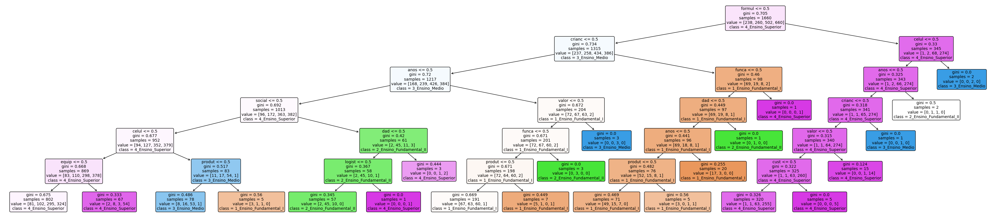

In [202]:
# Apresentando a árvore de decisão obtida
fig, axes = plt.subplots(figsize=(45, 10), dpi=100)
plot_tree(
    estimator_hcv,
    feature_names=features_kbest_hcv,
    class_names=list(target_map.values()),
    filled=True,
    rounded=True,
    fontsize=10
)
plt.show()

In [203]:
dot_data = export_graphviz(
    estimator_hcv,
    feature_names=features_kbest_hcv,
    class_names=list(target_map.values()),
    filled=True,
    rounded=True,
    out_file=None,
    max_depth=3
)
graph = graphviz.Source(dot_data, format='png')
graph.render("arvore_decisao_regras_fuzzy_resumida")

'arvore_decisao_regras_fuzzy_resumida.png'

In [204]:
dot_data = export_graphviz(
    estimator_hcv,
    feature_names=features_kbest_hcv,
    class_names=list(target_map.values()),
    filled=True,
    rounded=True,
    out_file=None
)
graph = graphviz.Source(dot_data, format='png')
graph.render("arvore_decisao_regras_fuzzy_completa")

'arvore_decisao_regras_fuzzy_completa.png'

In [205]:
et_hcv = estimator_hcv.tree_

fuzzy_tree_hcv = [
    {
        'node_index': i,
        'feature_index': f,
        'feature_name': features_kbest_hcv[f] if f != _tree.TREE_UNDEFINED else 'undefined',
        'weight_value': t,
        'weight_name': dict_fuzzy_values[t] if t != _tree.TREE_UNDEFINED else 'undefined',
        'class_index': v.argmax(),
        'class_name': target_map[v.argmax()],
        'left_index': cl,
        'right_index': cr
    }
    for i, (f, t, v, cl, cr)
    in enumerate(zip(et_hcv.feature, et_hcv.threshold, et_hcv.value, et_hcv.children_left, et_hcv.children_right))
]

In [206]:
df_fuzzy_tree_hcv = pd.DataFrame(fuzzy_tree_hcv)

df_fuzzy_tree_hcv

,node_index,feature_index,feature_name,weight_value,weight_name,class_index,class_name,left_index,right_index
0,0,8,formul,0.5,low,3,4_Ensino_Superior,1,32
1,1,4,crianc,0.5,low,2,3_Ensino_Medio,2,23
2,2,0,anos,0.5,low,2,3_Ensino_Medio,3,16
3,3,13,social,0.5,low,3,4_Ensino_Superior,4,11
4,4,2,celul,0.5,low,3,4_Ensino_Superior,5,8
5,5,7,equip,0.5,low,3,4_Ensino_Superior,6,7
6,6,-2,undefined,-2.0,undefined,3,4_Ensino_Superior,-1,-1
7,7,-2,undefined,-2.0,undefined,3,4_Ensino_Superior,-1,-1
8,8,11,produt,0.5,low,2,3_Ensino_Medio,9,10
9,9,-2,undefined,-2.0,undefined,2,3_Ensino_Medio,-1,-1


In [207]:
# Apresentando a função com as regras nebulosas
tree_to_fuzzy_rule_low_high(estimator_hcv, features_kbest_hcv)

def show_rules_low_high(anos, armazenag, celul, conjunt, crianc, cust, dad, equip, formul, funca, logist, produt, sistem, social, valor):
    [0] if formul == low:
        [1] if crianc == low:
            [2] if anos == low:
                [3] if social == low:
                    [4] if celul == low:
                        [5] if equip == low:
                            [6] return 4_Ensino_Superior
                        [5] elif equip == high:
                            [7] return 4_Ensino_Superior
                    [4] elif celul == high:
                        [8] if produt == low:
                            [9] return 3_Ensino_Medio
                        [8] elif produt == high:
                            [10] return 1_Ensino_Fundamental_I
                [3] elif social == high:
                    [11] if dad == low:
                        [12] if logist == low:
                            [13] return 2_Ensino_Fundamental_II
                        [12] elif logist

In [208]:
rules_indexes_hcv = []
rules_indexes_hcv = get_matrix_paths(fuzzy_tree_hcv)

rules_indexes_hcv

[[0, 1, 2, 3, 4, 5, 6],
 [0, 1, 2, 3, 4, 5, 7],
 [0, 1, 2, 3, 4, 8, 9],
 [0, 1, 2, 3, 4, 8, 10],
 [0, 1, 2, 3, 11, 12, 13],
 [0, 1, 2, 3, 11, 12, 14],
 [0, 1, 2, 3, 11, 15],
 [0, 1, 2, 16, 17, 18, 19],
 [0, 1, 2, 16, 17, 18, 20],
 [0, 1, 2, 16, 17, 21],
 [0, 1, 2, 16, 22],
 [0, 1, 23, 24, 25, 26, 27],
 [0, 1, 23, 24, 25, 26, 28],
 [0, 1, 23, 24, 25, 29],
 [0, 1, 23, 24, 30],
 [0, 1, 23, 31],
 [0, 32, 33, 34, 35, 36, 37],
 [0, 32, 33, 34, 35, 36, 38],
 [0, 32, 33, 34, 35, 39],
 [0, 32, 33, 34, 40],
 [0, 32, 33, 41],
 [0, 32, 42]]

In [209]:
# Apresentando os termos por ordem descendente de importância, geradas a partir da função SelectKBest
dict_importancia_hcv = {}
for variavel, importancia in zip(features_kbest_hcv, especialista.named_steps['classify'].feature_importances_):
    dict_importancia_hcv[variavel] = importancia

df_importancia_hcv = pd.DataFrame(dict_importancia_hcv.items(), columns=['term', 'importance']).sort_values(by='importance', ascending=False)
df_importancia_hcv

,term,importance
8,formul,0.345227
4,crianc,0.168397
0,anos,0.156112
13,social,0.113601
2,celul,0.089683
7,equip,0.063008
11,produt,0.017471
6,dad,0.015671
9,funca,0.013273
14,valor,0.009960


### Conjuntos de Pertinência (Antecedentes e Consequente)

In [210]:
print('Variáveis Linguísticas:')
for i, feature in enumerate(features_kbest_hcv):
    print(f'{i + 1}: {feature}')

Variáveis Linguísticas:
1: anos
2: armazenag
3: celul
4: conjunt
5: crianc
6: cust
7: dad
8: equip
9: formul
10: funca
11: logist
12: produt
13: sistem
14: social
15: valor


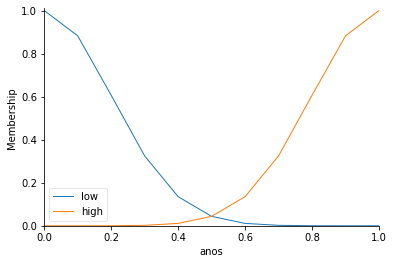

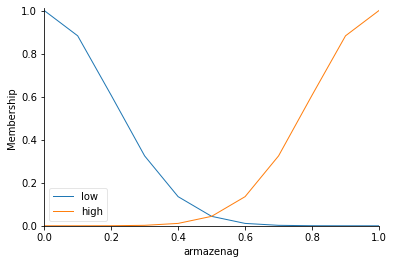

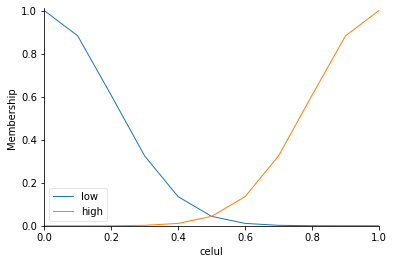

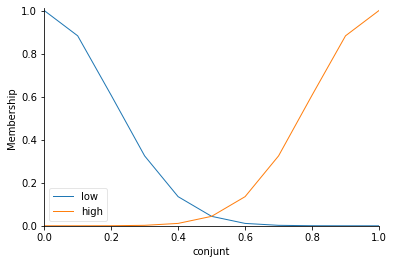

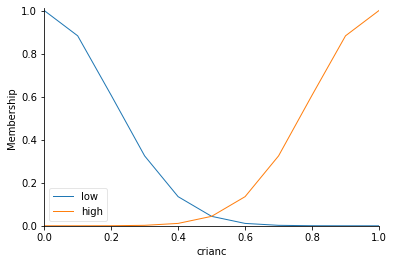

...

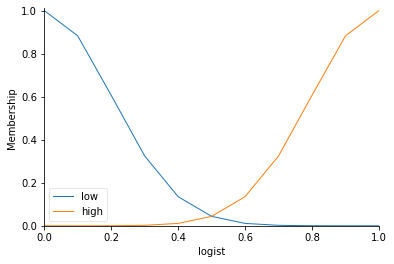

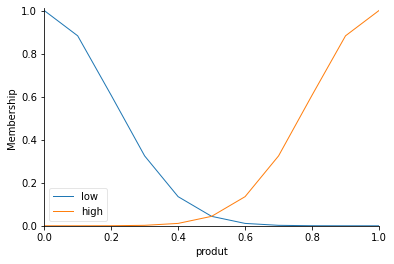

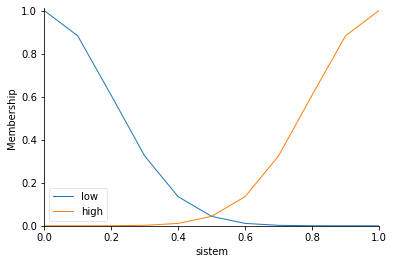

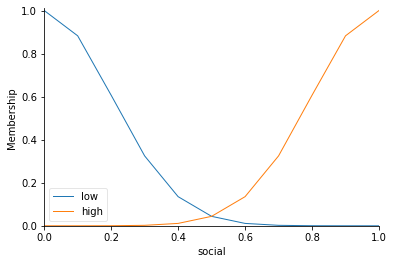

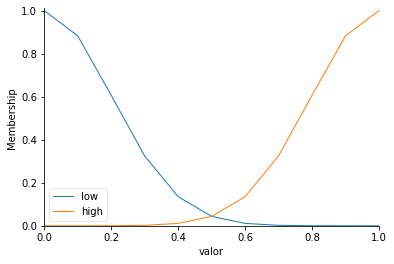

In [211]:
# Criando os conjuntos e funções de pertinência dos antecedentes com base nos termos selecionados
variaveis_linguisticas_hcv = []
x_var_hcv = np.arange(0, 1.000001, 0.1)

for feature in features_kbest_hcv:
    # Definindo os limites da função de pertinência
    variavel_hcv = ctrl.Antecedent(x_var_hcv, feature)
    
    # Utilizando a função gaussiana nos antecedentes
    n = len(fuzzy_linguistic_names) - 1
    for i, linguistic_name in enumerate(fuzzy_linguistic_names):
        variavel_hcv[linguistic_name] = fuzz.gaussmf(variavel_hcv.universe, i/n, 0.2)
    
    # Apresentando os gráficos das funções obtidas
    variavel_hcv.view()
    variaveis_linguisticas_hcv.append(variavel_hcv)

In [212]:
# Apresentando as variáveis linguísticas utilizadas
variaveis_linguisticas_hcv

[Antecedent: anos,
 Antecedent: armazenag,
 Antecedent: celul,
 Antecedent: conjunt,
 Antecedent: crianc,
 Antecedent: cust,
 Antecedent: dad,
 Antecedent: equip,
 Antecedent: formul,
 Antecedent: funca,
 Antecedent: logist,
 Antecedent: produt,
 Antecedent: sistem,
 Antecedent: social,
 Antecedent: valor]

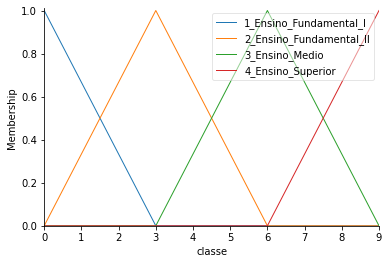

In [213]:
# Criando os conjuntos e funções de pertinência do consequente com base nas classes selecionadas
# Definindo os limites da função de pertinência
x_class_hcv = np.arange(0, 10, 1)
variavel_hcv = ctrl.Consequent(x_class_hcv, 'classe')

# Utilizando a função triangular no consequente
variavel_hcv.automf(names=list(encoder.classes_))

# Apresentando o gráfico da função obtida
variavel_hcv.view()
variaveis_linguisticas_hcv.append(variavel_hcv)

### Regras Fuzzy

In [214]:
# Criando as regras nebulosas simplificadas, com base na árvore de decisão criada anteriormente
rules_hcv = []

for rule_indexes_hcv in rules_indexes_hcv:
    i = 0
    node_index = rule_indexes_hcv[0]

    feature_index = fuzzy_tree_hcv[node_index]['feature_index']
    right_index = fuzzy_tree_hcv[node_index]['right_index']
    weight_name = fuzzy_tree_hcv[node_index]['weight_name']

    if right_index == rule_indexes_hcv[i + 1]:
        weight_name = fuzzy_linguistic_names[fuzzy_linguistic_names.index(weight_name) + 1]
    
    # ifs = variaveis_linguisticas_hcv[feature_index][weight_name]
    ifs = ''
    
    for i, node_index in enumerate(rule_indexes_hcv[:-1]):
        feature_index = fuzzy_tree_hcv[node_index]['feature_index']
        right_index = fuzzy_tree_hcv[node_index]['right_index']
        weight_name = fuzzy_tree_hcv[node_index]['weight_name']
        
        if right_index == rule_indexes_hcv[i + 1]:
            weight_name = fuzzy_linguistic_names[fuzzy_linguistic_names.index(weight_name) + 1]
        
        if ifs == '':
            ifs = variaveis_linguisticas_hcv[feature_index][weight_name]
        else:
            ifs = ifs & variaveis_linguisticas_hcv[feature_index][weight_name]
        # ifs = ifs & variaveis_linguisticas_hcv[feature_index][weight_name]

    then = variaveis_linguisticas_hcv[-1][fuzzy_tree_hcv[rule_indexes_hcv[-1]]['class_name']]

    rules_hcv.append(ctrl.Rule(ifs, then))
    # print(ifs, then)

In [215]:
rules_hcv

[IF ((((formul[low] AND crianc[low]) AND anos[low]) AND social[low]) AND celul[low]) AND equip[low] THEN classe[4_Ensino_Superior]
 	AND aggregation function : fmin
 	OR aggregation function  : fmax,
 IF ((((formul[low] AND crianc[low]) AND anos[low]) AND social[low]) AND celul[low]) AND equip[high] THEN classe[4_Ensino_Superior]
 	AND aggregation function : fmin
 	OR aggregation function  : fmax,
 IF ((((formul[low] AND crianc[low]) AND anos[low]) AND social[low]) AND celul[high]) AND produt[low] THEN classe[3_Ensino_Medio]
 	AND aggregation function : fmin
 	OR aggregation function  : fmax,
 IF ((((formul[low] AND crianc[low]) AND anos[low]) AND social[low]) AND celul[high]) AND produt[high] THEN classe[1_Ensino_Fundamental_I]
 	AND aggregation function : fmin
 	OR aggregation function  : fmax,
 IF ((((formul[low] AND crianc[low]) AND anos[low]) AND social[high]) AND dad[low]) AND logist[low] THEN classe[2_Ensino_Fundamental_II]
 	AND aggregation function : fmin
 	OR aggregation func

In [216]:
# Aplicando as regras nebulosas no sistema fuzzy
complexidade_textual_ctrl_hcv = ctrl.ControlSystem(rules_hcv)
complexidade_textual_simulador_hcv = ctrl.ControlSystemSimulation(complexidade_textual_ctrl_hcv)

### Predição

In [217]:
# Selecionando um exemplo do dataset para a realização de uma predição
index_exemplo = df_test_transf_hcv.sample(random_state=SEED).index
exemplo_X_teste_hcv = df_test_transf_hcv.iloc[index_exemplo]

exemplo_X_teste_hcv

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
152,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.546089,0.615426,0.0,0.0,0.0,0.0,0.568365,3.0


In [218]:
exemplo_y_teste_hcv = int(y_test_hcv[index_exemplo])

exemplo_y_teste_hcv

3

In [219]:
# Inserindo as entradas no sistema fuzzy
for i, feature in enumerate(features_kbest_hcv):
    try:
        complexidade_textual_simulador_hcv.input[feature] = exemplo_X_teste_hcv[i]
    except:
        pass

# Computando o resultado
complexidade_textual_simulador_hcv.compute()

# Convertendo o resultado defuzzyficado na respectiva classe
resultado_hcv = complexidade_textual_simulador_hcv.output['classe']


pertencimento_classes = []
for classe in encoder.classes_:
    pertencimento_classes.append(fuzz.interp_membership(x_class_hcv, variavel_hcv[classe].mf, resultado_hcv))

class_pred_hcv = encoder.classes_[np.argmax(pertencimento_classes)]

# # Apresentando a comparação entre o valor real e o previsto a partir do sistema fuzzy
print(f'Valor Deffuzyficado: {resultado_hcv}')
print(f'Real: {encoder.classes_[exemplo_y_teste_hcv]}')
print(f'Previsto: {class_pred_hcv}')

Valor Deffuzyficado: 7.563162677272616
Real: 4_Ensino_Superior
Previsto: 4_Ensino_Superior


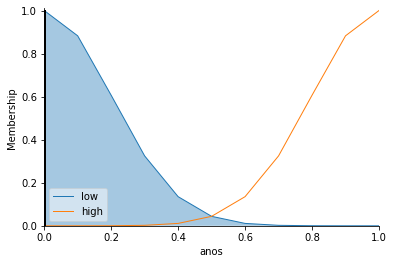

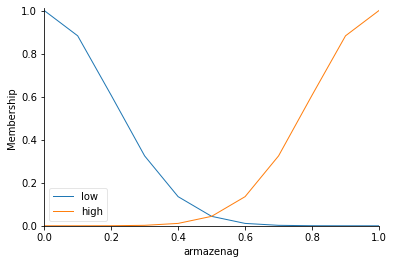

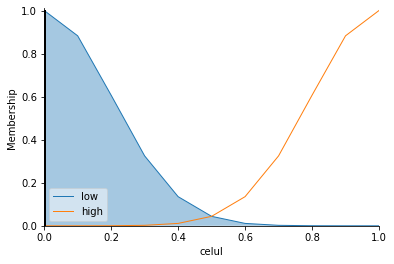

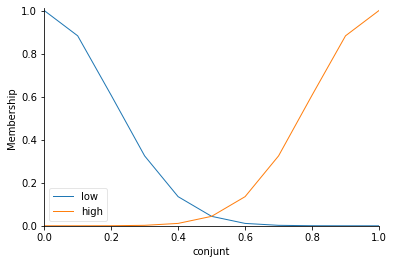

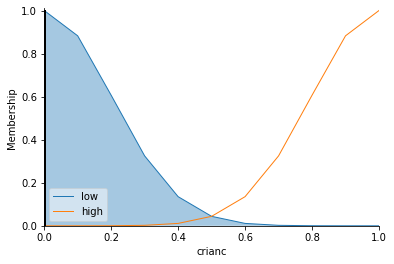

...

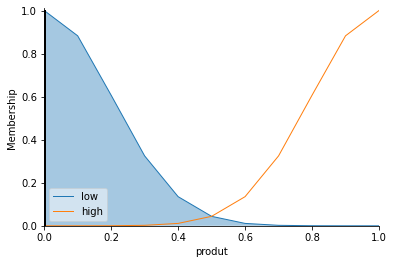

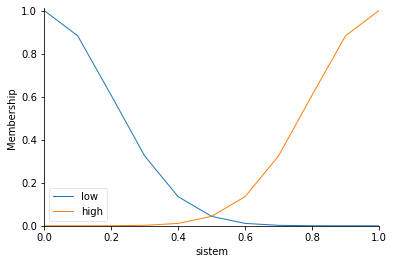

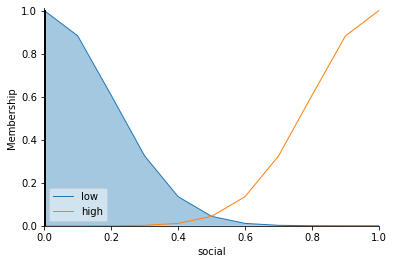

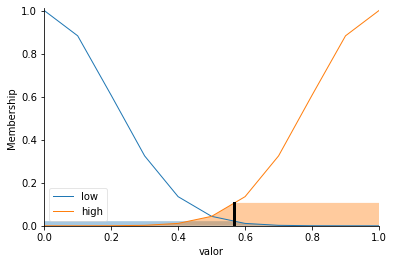

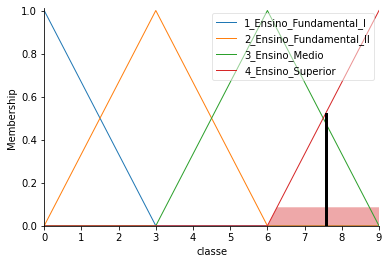

In [220]:
# Apresentando os gráficos de processamento da lógica fuzzy até o resultado
for variavel in variaveis_linguisticas_hcv:
    variavel.view(sim=complexidade_textual_simulador_hcv)

In [221]:
# Aplicando as predições para todos conjunto de validação cruzada
y_pred_folds_hcv = []
for _, fold_validation in kfold.split(df_train_transf_hcv):
    y_pred_fold_hcv = []
    for i in fold_validation:
        exemplo_treino = df_train_transf_hcv.iloc[i]

        # Inserindo as entradas no sistema fuzzy
        for i, feature in enumerate(features_kbest_hcv):
            try:
                complexidade_textual_simulador_hcv.input[feature] = exemplo_treino[i]
            except:
                pass

        # Computando o resultado
        complexidade_textual_simulador_hcv.compute()

        # Convertendo o resultado defuzzyficado na respectiva classe
        resultado = complexidade_textual_simulador_hcv.output['classe']
        
        pertencimento_classes = []
        for classe in encoder.classes_:
            pertencimento_classes.append(fuzz.interp_membership(x_class_hcv, variavel_hcv[classe].mf, resultado))
        
        y_pred_fold_hcv.append(np.argmax(pertencimento_classes))
    
    y_pred_folds_hcv.append(y_pred_fold_hcv)

In [222]:
# Aplicando as predições para todos os dados de treino
y_pred_fuzzy_train_hcv = []
for i in range(df_train_transf_hcv.shape[0]):
    exemplo_treino = df_train_transf_hcv.iloc[i]

    # Inserindo as entradas no sistema fuzzy
    for i, feature in enumerate(features_kbest_hcv):
        try:
            complexidade_textual_simulador_hcv.input[feature] = exemplo_treino[i]
        except:
            pass

    # Computando o resultado
    complexidade_textual_simulador_hcv.compute()

    # Convertendo o resultado defuzzyficado na respectiva classe
    resultado = complexidade_textual_simulador_hcv.output['classe']

    pertencimento_classes = []
    for classe in encoder.classes_:
        pertencimento_classes.append(fuzz.interp_membership(x_class_hcv, variavel_hcv[classe].mf, resultado))

    y_pred_fuzzy_train_hcv.append(np.argmax(pertencimento_classes))

In [223]:
# Aplicando as predições para todos os dados de teste
y_pred_fuzzy_test_hcv = []
for i in range(df_test_transf_hcv.shape[0]):
    exemplo_teste = df_test_transf_hcv.iloc[i]

    # Inserindo as entradas no sistema fuzzy
    for i, feature in enumerate(features_kbest_hcv):
        try:
            complexidade_textual_simulador_hcv.input[feature] = exemplo_teste[i]
        except:
            pass

    # Computando o resultado
    complexidade_textual_simulador_hcv.compute()

    # Convertendo o resultado defuzzyficado na respectiva classe
    resultado = complexidade_textual_simulador_hcv.output['classe']

    pertencimento_classes = []
    for classe in encoder.classes_:
        pertencimento_classes.append(fuzz.interp_membership(x_class_hcv, variavel_hcv[classe].mf, resultado))

    y_pred_fuzzy_test_hcv.append(np.argmax(pertencimento_classes))

### Resultados

In [224]:
# Apresentando a acurácia balanceada por classes para os dados de validação
y_balanced_accuracy_scores_hcv = []
for i, (_, fold_validation) in enumerate(kfold.split(df_train_transf_hcv)):
    y_balanced_accuracy_score_hcv = balanced_accuracy_score(y_train_hcv[fold_validation], y_pred_folds_hcv[i])
    print(f'[Conjunto de Validação #{i + 1}] Acurácia Balanceada entre Classes: {y_balanced_accuracy_score_hcv}')
    y_balanced_accuracy_scores_hcv.append(y_balanced_accuracy_score_hcv)

[Conjunto de Validação #1] Acurácia Balanceada entre Classes: 0.5263778298204528
[Conjunto de Validação #2] Acurácia Balanceada entre Classes: 0.494101950680898
[Conjunto de Validação #3] Acurácia Balanceada entre Classes: 0.503485387112544
[Conjunto de Validação #4] Acurácia Balanceada entre Classes: 0.46822620940267995
[Conjunto de Validação #5] Acurácia Balanceada entre Classes: 0.5199553967159601
[Conjunto de Validação #6] Acurácia Balanceada entre Classes: 0.49738476626348477
[Conjunto de Validação #7] Acurácia Balanceada entre Classes: 0.48343263045095786
[Conjunto de Validação #8] Acurácia Balanceada entre Classes: 0.4300115207373272
[Conjunto de Validação #9] Acurácia Balanceada entre Classes: 0.44329836829836833
[Conjunto de Validação #10] Acurácia Balanceada entre Classes: 0.47798945548158933


In [225]:
df_classifier_fuzzy_hcv = pd.DataFrame(y_balanced_accuracy_scores_hcv, columns=['Fuzzy']).T

df_classifier_fuzzy_hcv

,0,1,2,3,4,5,6,7,8,9
Fuzzy,0.526378,0.494102,0.503485,0.468226,0.519955,0.497385,0.483433,0.430012,0.443298,0.477989


In [226]:
# Apresentando as melhores médias das métricas obtidas por classificador
df_classifier_fuzzy_hcv.mean(axis=1).sort_values(ascending=False)

Fuzzy    0.484426
dtype: float64

In [227]:
# Apresentando a acurácia balanceada por classes para os dados de treinamento
print(f'[Conjunto de Treinamento] Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_train_hcv, y_pred_fuzzy_train_hcv)}')

[Conjunto de Treinamento] Acurácia Balanceada entre Classes: 0.47877041812183596


In [228]:
# Apresentando a acurácia balanceada por classes para os dados de teste
print(f'[Conjunto de Teste] Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_test_hcv, y_pred_fuzzy_test_hcv)}')

[Conjunto de Teste] Acurácia Balanceada entre Classes: 0.4642708600590978


In [229]:
# Obtendo a matriz de confusão
cf_matrix_fuzzy_hcv = confusion_matrix(y_test_hcv, y_pred_test_hcv)

# Criando um dataframe com a matriz de confusão
df_cf_matrix_fuzzy_hcv = pd.DataFrame(cf_matrix_fuzzy_hcv)

# Renomeando os índices e colunas do dataframe com o nome dos rótulos
df_cf_matrix_fuzzy_hcv = df_cf_matrix_fuzzy_hcv.rename(target_map).T.rename(target_map).T

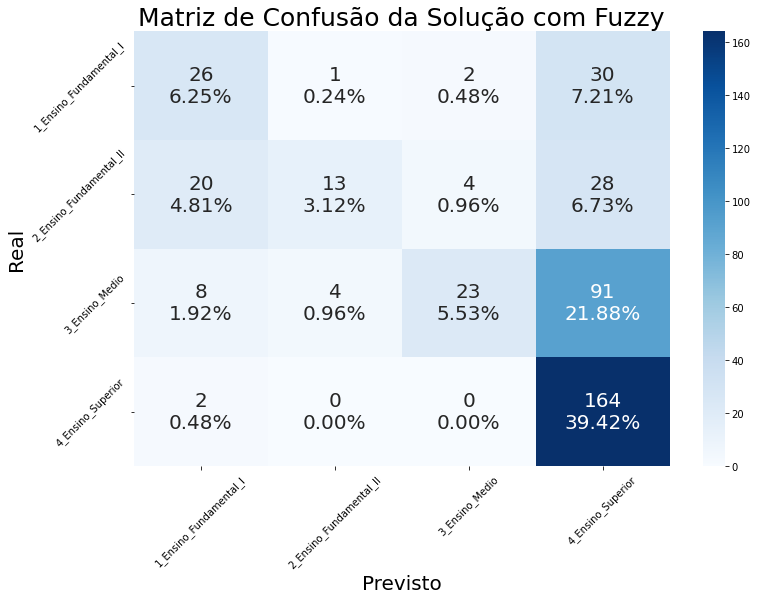

In [230]:
# Apresentando a matriz de confusão
num_classes = len(encoder.classes_)
group_counts = ['{0:0.0f}'.format(value) for value in cf_matrix_fuzzy_hcv.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix_fuzzy_hcv.flatten() / np.sum(cf_matrix_fuzzy_hcv)]
labels = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts, group_percentages)]
labels = np.asarray(labels).reshape(num_classes, num_classes)

plt.figure(figsize=(12,8))
ax = sns.heatmap(df_cf_matrix_fuzzy_hcv, annot=labels, fmt='', cmap='Blues', annot_kws={"size": 20})
ax.set_title("Matriz de Confusão da Solução com Fuzzy", fontsize=25)
ax.set_xlabel('Previsto', fontsize=20)
ax.set_ylabel('Real', fontsize=20)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_yticklabels(ax.get_yticklabels(), rotation=45)

plt.plot()
plt.savefig('matriz_confusao_fuzzy.png')

In [231]:
# Apresentando um relatório completo da classificação executada
print(classification_report(y_test_hcv, y_pred_fuzzy_test_hcv))

              precision    recall  f1-score   support

           0       0.47      0.41      0.44        59
           1       0.70      0.25      0.36        65
           2       0.72      0.22      0.34       126
           3       0.54      0.98      0.70       166

    accuracy                           0.56       416
   macro avg       0.61      0.46      0.46       416
weighted avg       0.61      0.56      0.50       416



## Comparativo Baselines

In [232]:
SEED = 42

In [233]:
num_classes = len(encoder.classes_)

num_classes

4

In [234]:
(_, fold_validation) = next(kfold.split(df_train_transf_hcv))
train_size = fold_validation.shape[0]

train_size

166

In [235]:
test_size = y_test_hcv.shape[0]

test_size

416

In [236]:
freq_classes = pd.value_counts(y_train_hcv)

freq_classes

3    660
2    502
1    260
0    238
dtype: int64

### Aleatório

In [237]:
# Apresentando a acurácia balanceada por classes para os dados de validação
y_balanced_accuracy_scores_hcv = []
for i, (_, fold_validation) in enumerate(kfold.split(df_train_transf_hcv)):
    np.random.seed(SEED)
    y_pred_fold_hcv = np.random.choice(num_classes, train_size)
    y_balanced_accuracy_score_hcv = balanced_accuracy_score(y_train_hcv[fold_validation], y_pred_fold_hcv)
    print(f'[Conjunto de Validação #{i + 1}] Acurácia Balanceada entre Classes: {y_balanced_accuracy_score_hcv}')
    y_balanced_accuracy_scores_hcv.append(y_balanced_accuracy_score_hcv)

[Conjunto de Validação #1] Acurácia Balanceada entre Classes: 0.16248731459797033
[Conjunto de Validação #2] Acurácia Balanceada entre Classes: 0.25922279474911053
[Conjunto de Validação #3] Acurácia Balanceada entre Classes: 0.2287069515126529
[Conjunto de Validação #4] Acurácia Balanceada entre Classes: 0.23162616397910518
[Conjunto de Validação #5] Acurácia Balanceada entre Classes: 0.2478194340870397
[Conjunto de Validação #6] Acurácia Balanceada entre Classes: 0.25202727315182366
[Conjunto de Validação #7] Acurácia Balanceada entre Classes: 0.24678077973306367
[Conjunto de Validação #8] Acurácia Balanceada entre Classes: 0.22424635176651303
[Conjunto de Validação #9] Acurácia Balanceada entre Classes: 0.24884421134421134
[Conjunto de Validação #10] Acurácia Balanceada entre Classes: 0.2656092894043409


In [238]:
df_classifier_random_hcv = pd.DataFrame(y_balanced_accuracy_scores_hcv, columns=['Random']).T

df_classifier_random_hcv

,0,1,2,3,4,5,6,7,8,9
Random,0.162487,0.259223,0.228707,0.231626,0.247819,0.252027,0.246781,0.224246,0.248844,0.265609


In [239]:
np.random.seed(SEED)
y_pred_random_test_hcv = np.random.choice(num_classes, test_size)

In [240]:
# Apresentando a acurácia balanceada por classes para os dados de teste
print(f'[Conjunto de Teste] Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_test_hcv, y_pred_random_test_hcv)}')

[Conjunto de Teste] Acurácia Balanceada entre Classes: 0.2636738547908652


In [241]:
# Obtendo a matriz de confusão
cf_matrix_random_hcv = confusion_matrix(y_test_hcv, y_pred_random_test_hcv)

# Criando um dataframe com a matriz de confusão
df_cf_matrix_random_hcv = pd.DataFrame(cf_matrix_random_hcv)

# Renomeando os índices e colunas do dataframe com o nome dos rótulos
df_cf_matrix_random_hcv = df_cf_matrix_random_hcv.rename(target_map).T.rename(target_map).T

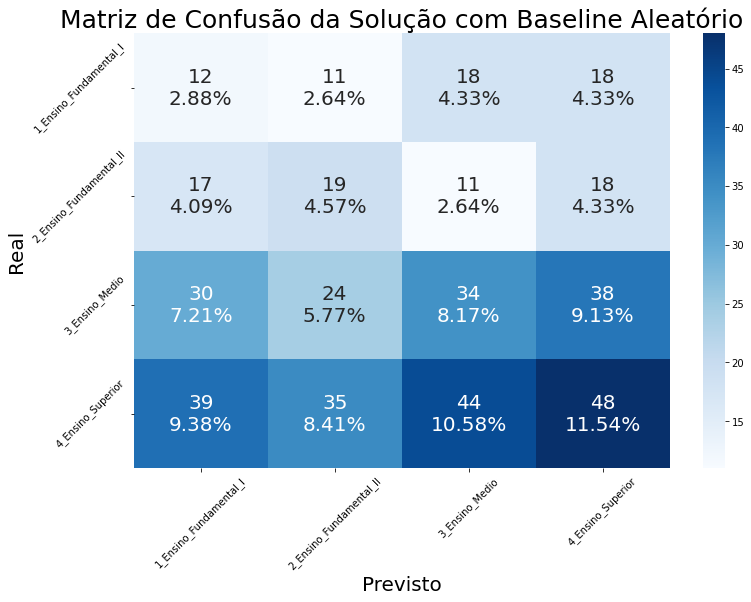

In [242]:
# Apresentando a matriz de confusão
num_classes = len(encoder.classes_)
group_counts = ['{0:0.0f}'.format(value) for value in cf_matrix_random_hcv.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix_random_hcv.flatten() / np.sum(cf_matrix_random_hcv)]
labels = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts, group_percentages)]
labels = np.asarray(labels).reshape(num_classes, num_classes)

plt.figure(figsize=(12,8))
ax = sns.heatmap(df_cf_matrix_random_hcv, annot=labels, fmt='', cmap='Blues', annot_kws={"size": 20})
ax.set_title("Matriz de Confusão da Solução com Baseline Aleatório", fontsize=25)
ax.set_xlabel('Previsto', fontsize=20)
ax.set_ylabel('Real', fontsize=20)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_yticklabels(ax.get_yticklabels(), rotation=45)

plt.plot()
plt.savefig('matriz_confusao_aleatorio.png')

In [243]:
# Apresentando um relatório completo da classificação executada
print(classification_report(y_test_hcv, y_pred_random_test_hcv))

              precision    recall  f1-score   support

           0       0.12      0.20      0.15        59
           1       0.21      0.29      0.25        65
           2       0.32      0.27      0.29       126
           3       0.39      0.29      0.33       166

    accuracy                           0.27       416
   macro avg       0.26      0.26      0.26       416
weighted avg       0.30      0.27      0.28       416



### Majoritário

In [244]:
major = freq_classes.index[0]

In [245]:
# Apresentando a acurácia balanceada por classes para os dados de validação
y_balanced_accuracy_scores_hcv = []
for i, (_, fold_validation) in enumerate(kfold.split(df_train_transf_hcv)):
    y_pred_fold_hcv = np.repeat(major, train_size)
    y_balanced_accuracy_score_hcv = balanced_accuracy_score(y_train_hcv[fold_validation], y_pred_fold_hcv)
    print(f'[Conjunto de Validação #{i + 1}] Acurácia Balanceada entre Classes: {y_balanced_accuracy_score_hcv}')
    y_balanced_accuracy_scores_hcv.append(y_balanced_accuracy_score_hcv)

[Conjunto de Validação #1] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #2] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #3] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #4] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #5] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #6] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #7] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #8] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #9] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #10] Acurácia Balanceada entre Classes: 0.25


In [246]:
df_classifier_major_hcv = pd.DataFrame(y_balanced_accuracy_scores_hcv, columns=['Major']).T

df_classifier_major_hcv

,0,1,2,3,4,5,6,7,8,9
Major,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25


In [247]:
y_pred_major_test_hcv = np.repeat(major, test_size)

In [248]:
# Apresentando a acurácia balanceada por classes para os dados de teste
print(f'[Conjunto de Teste] Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_test_hcv, y_pred_major_test_hcv)}')

[Conjunto de Teste] Acurácia Balanceada entre Classes: 0.25


In [249]:
# Obtendo a matriz de confusão
cf_matrix_major_hcv = confusion_matrix(y_test_hcv, y_pred_major_test_hcv)

# Criando um dataframe com a matriz de confusão
df_cf_matrix_major_hcv = pd.DataFrame(cf_matrix_major_hcv)

# Renomeando os índices e colunas do dataframe com o nome dos rótulos
df_cf_matrix_major_hcv = df_cf_matrix_major_hcv.rename(target_map).T.rename(target_map).T

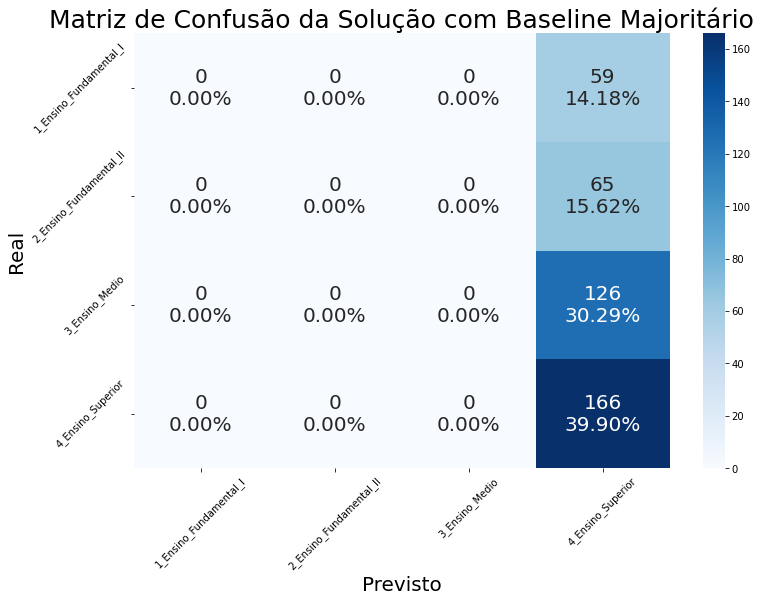

In [250]:
# Apresentando a matriz de confusão
num_classes = len(encoder.classes_)
group_counts = ['{0:0.0f}'.format(value) for value in cf_matrix_major_hcv.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix_major_hcv.flatten() / np.sum(cf_matrix_major_hcv)]
labels = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts, group_percentages)]
labels = np.asarray(labels).reshape(num_classes, num_classes)

plt.figure(figsize=(12,8))
ax = sns.heatmap(df_cf_matrix_major_hcv, annot=labels, fmt='', cmap='Blues', annot_kws={"size": 20})
ax.set_title("Matriz de Confusão da Solução com Baseline Majoritário", fontsize=25)
ax.set_xlabel('Previsto', fontsize=20)
ax.set_ylabel('Real', fontsize=20)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_yticklabels(ax.get_yticklabels(), rotation=45)

plt.plot()
plt.savefig('matriz_confusao_majoritario.png')

In [251]:
# Apresentando um relatório completo da classificação executada
print(classification_report(y_test_hcv, y_pred_major_test_hcv))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        59
           1       0.00      0.00      0.00        65
           2       0.00      0.00      0.00       126
           3       0.40      1.00      0.57       166

    accuracy                           0.40       416
   macro avg       0.10      0.25      0.14       416
weighted avg       0.16      0.40      0.23       416



### Minoritário

In [252]:
minor = freq_classes.index[-1]

In [253]:
# Apresentando a acurácia balanceada por classes para os dados de validação
y_balanced_accuracy_scores_hcv = []
for i, (_, fold_validation) in enumerate(kfold.split(df_train_transf_hcv)):
    y_pred_fold_hcv = np.repeat(minor, train_size)
    y_balanced_accuracy_score_hcv = balanced_accuracy_score(y_train_hcv[fold_validation], y_pred_fold_hcv)
    print(f'[Conjunto de Validação #{i + 1}] Acurácia Balanceada entre Classes: {y_balanced_accuracy_score_hcv}')
    y_balanced_accuracy_scores_hcv.append(y_balanced_accuracy_score_hcv)

[Conjunto de Validação #1] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #2] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #3] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #4] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #5] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #6] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #7] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #8] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #9] Acurácia Balanceada entre Classes: 0.25
[Conjunto de Validação #10] Acurácia Balanceada entre Classes: 0.25


In [254]:
df_classifier_minor_hcv = pd.DataFrame(y_balanced_accuracy_scores_hcv, columns=['Minor']).T

df_classifier_minor_hcv

,0,1,2,3,4,5,6,7,8,9
Minor,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25


In [255]:
y_pred_minor_test_hcv = np.repeat(minor, test_size)

In [256]:
# Apresentando a acurácia balanceada por classes para os dados de teste
print(f'[Conjunto de Teste] Acurácia Balanceada entre Classes: {balanced_accuracy_score(y_test_hcv, y_pred_minor_test_hcv)}')

[Conjunto de Teste] Acurácia Balanceada entre Classes: 0.25


In [257]:
# Obtendo a matriz de confusão
cf_matrix_minor_hcv = confusion_matrix(y_test_hcv, y_pred_minor_test_hcv)

# Criando um dataframe com a matriz de confusão
df_cf_matrix_minor_hcv = pd.DataFrame(cf_matrix_minor_hcv)

# Renomeando os índices e colunas do dataframe com o nome dos rótulos
df_cf_matrix_minor_hcv = df_cf_matrix_minor_hcv.rename(target_map).T.rename(target_map).T

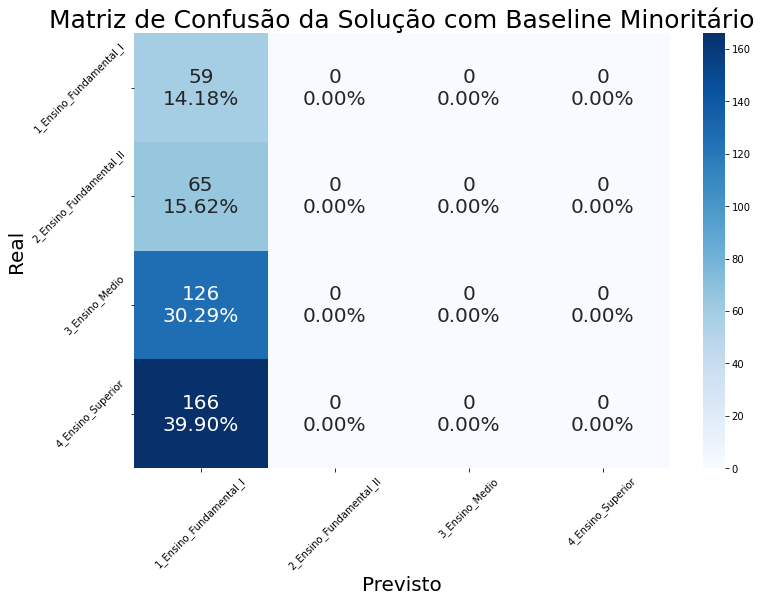

In [258]:
# Apresentando a matriz de confusão
num_classes = len(encoder.classes_)
group_counts = ['{0:0.0f}'.format(value) for value in cf_matrix_minor_hcv.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix_minor_hcv.flatten() / np.sum(cf_matrix_minor_hcv)]
labels = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts, group_percentages)]
labels = np.asarray(labels).reshape(num_classes, num_classes)

plt.figure(figsize=(12,8))
ax = sns.heatmap(df_cf_matrix_minor_hcv, annot=labels, fmt='', cmap='Blues', annot_kws={"size": 20})
ax.set_title("Matriz de Confusão da Solução com Baseline Minoritário", fontsize=25)
ax.set_xlabel('Previsto', fontsize=20)
ax.set_ylabel('Real', fontsize=20)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_yticklabels(ax.get_yticklabels(), rotation=45)

plt.plot()
plt.savefig('matriz_confusao_minoritario.png')

In [259]:
# Apresentando um relatório completo da classificação executada
print(classification_report(y_test_hcv, y_pred_minor_test_hcv))

              precision    recall  f1-score   support

           0       0.14      1.00      0.25        59
           1       0.00      0.00      0.00        65
           2       0.00      0.00      0.00       126
           3       0.00      0.00      0.00       166

    accuracy                           0.14       416
   macro avg       0.04      0.25      0.06       416
weighted avg       0.02      0.14      0.04       416



## Comparativo das Soluções Implementadas (AM x Fuzzy x Baselines)

<p align="center">
  <img src="Imagens/diagrama_comparativo_solucoes.png" />
</p>

In [260]:
# Importando bibliotecas de manipulação e visualização de dados
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import precision_score, recall_score, f1_score

# Importando bibliotecas de estatísticas
from scipy.stats import wilcoxon

### Desempenho Geral dos Modelos

In [261]:
# Consolidando num dataframe os resultados obtidos pelos classificadores
df_all_classifiers_hcv = pd.concat([
    df_classifiers_ml_hcv,
    df_classifier_fuzzy_hcv,
    df_classifier_random_hcv,
    df_classifier_major_hcv,
    df_classifier_minor_hcv
])

df_all_classifiers_hcv

,0,1,2,3,4,5,6,7,8,9
K-NN,0.835961,0.803055,0.831177,0.767229,0.863188,0.884293,0.864250,0.800883,0.784324,0.786813
Reg. Log.,0.877628,0.884395,0.847470,0.824406,0.856744,0.889973,0.921322,0.864151,0.822329,0.872813
SGD,0.878776,0.862922,0.898339,0.876699,0.917957,0.922956,0.959677,0.891945,0.897077,0.899941
NB. Bern.,0.768393,0.784431,0.693673,0.823110,0.804646,0.795708,0.828958,0.813916,0.786228,0.769078
NB. Multi.,0.647381,0.665072,0.593294,0.612081,0.700250,0.597289,0.609416,0.638345,0.552516,0.636979
SVM,0.877262,0.864259,0.878811,0.839112,0.866359,0.908233,0.927677,0.877424,0.861733,0.874608
DT,0.675352,0.669814,0.710522,0.701089,0.637267,0.704116,0.762915,0.655890,0.666735,0.708155
RF,0.747271,0.834812,0.765348,0.750911,0.790485,0.756906,0.802540,0.776690,0.769940,0.759989
MLP,0.866140,0.880723,0.906404,0.852189,0.914436,0.957853,0.955547,0.913282,0.906041,0.881585
Fuzzy,0.526378,0.494102,0.503485,0.468226,0.519955,0.497385,0.483433,0.430012,0.443298,0.477989


In [262]:
all_classifiers_desc_hcv = df_all_classifiers_hcv.index

all_classifiers_desc_hcv

Index(['K-NN', 'Reg. Log.', 'SGD', 'NB. Bern.', 'NB. Multi.', 'SVM', 'DT',
       'RF', 'MLP', 'Fuzzy', 'Random', 'Major', 'Minor'],
      dtype='object')

In [263]:
df_all_classifiers_hcv.mean(axis=1)

K-NN          0.822117
Reg. Log.     0.866123
SGD           0.900629
NB. Bern.     0.786814
NB. Multi.    0.625262
SVM           0.877548
DT            0.689185
RF            0.775489
MLP           0.903420
Fuzzy         0.484426
Random        0.236737
Major         0.250000
Minor         0.250000
dtype: float64

In [264]:
df_all_classifiers_best_hcv = df_all_classifiers_hcv.reindex(df_all_classifiers_hcv.mean(axis=1).sort_values(ascending=False).index)

df_all_classifiers_best_hcv

,0,1,2,3,4,5,6,7,8,9
MLP,0.866140,0.880723,0.906404,0.852189,0.914436,0.957853,0.955547,0.913282,0.906041,0.881585
SGD,0.878776,0.862922,0.898339,0.876699,0.917957,0.922956,0.959677,0.891945,0.897077,0.899941
SVM,0.877262,0.864259,0.878811,0.839112,0.866359,0.908233,0.927677,0.877424,0.861733,0.874608
Reg. Log.,0.877628,0.884395,0.847470,0.824406,0.856744,0.889973,0.921322,0.864151,0.822329,0.872813
K-NN,0.835961,0.803055,0.831177,0.767229,0.863188,0.884293,0.864250,0.800883,0.784324,0.786813
NB. Bern.,0.768393,0.784431,0.693673,0.823110,0.804646,0.795708,0.828958,0.813916,0.786228,0.769078
RF,0.747271,0.834812,0.765348,0.750911,0.790485,0.756906,0.802540,0.776690,0.769940,0.759989
DT,0.675352,0.669814,0.710522,0.701089,0.637267,0.704116,0.762915,0.655890,0.666735,0.708155
NB. Multi.,0.647381,0.665072,0.593294,0.612081,0.700250,0.597289,0.609416,0.638345,0.552516,0.636979
Fuzzy,0.526378,0.494102,0.503485,0.468226,0.519955,0.497385,0.483433,0.430012,0.443298,0.477989


In [265]:
df_all_classifiers_hcv_format = df_all_classifiers_best_hcv.copy()
df_all_classifiers_hcv_format.columns.name = 'cv'
df_all_classifiers_hcv_format['Mean'] = df_all_classifiers_hcv_format.mean(axis=1)
df_all_classifiers_hcv_format.applymap(lambda n: '{:,.2%}'.format(n).replace('.', ','))

cv,0,1,2,3,4,5,6,7,8,9,Mean
MLP,"86,61%","88,07%","90,64%","85,22%","91,44%","95,79%","95,55%","91,33%","90,60%","88,16%","90,34%"
SGD,"87,88%","86,29%","89,83%","87,67%","91,80%","92,30%","95,97%","89,19%","89,71%","89,99%","90,06%"
SVM,"87,73%","86,43%","87,88%","83,91%","86,64%","90,82%","92,77%","87,74%","86,17%","87,46%","87,75%"
Reg. Log.,"87,76%","88,44%","84,75%","82,44%","85,67%","89,00%","92,13%","86,42%","82,23%","87,28%","86,61%"
K-NN,"83,60%","80,31%","83,12%","76,72%","86,32%","88,43%","86,43%","80,09%","78,43%","78,68%","82,21%"
NB. Bern.,"76,84%","78,44%","69,37%","82,31%","80,46%","79,57%","82,90%","81,39%","78,62%","76,91%","78,68%"
RF,"74,73%","83,48%","76,53%","75,09%","79,05%","75,69%","80,25%","77,67%","76,99%","76,00%","77,55%"
DT,"67,54%","66,98%","71,05%","70,11%","63,73%","70,41%","76,29%","65,59%","66,67%","70,82%","68,92%"
NB. Multi.,"64,74%","66,51%","59,33%","61,21%","70,03%","59,73%","60,94%","63,83%","55,25%","63,70%","62,53%"
Fuzzy,"52,64%","49,41%","50,35%","46,82%","52,00%","49,74%","48,34%","43,00%","44,33%","47,80%","48,44%"


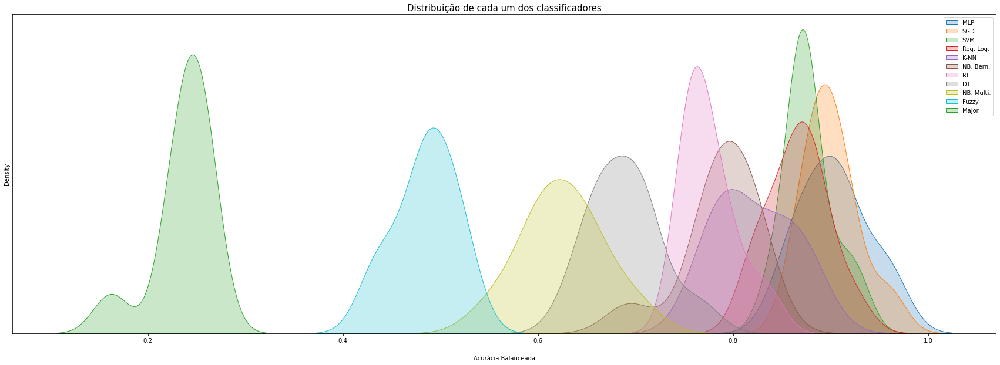

In [266]:
# Apresentando o resultado da acurácia balanceada dos modelos conforme as médias obtidas em gaussianas
plt.figure(figsize=(30, 10))

for mean in df_all_classifiers_best_hcv.values:
    sns.distplot(mean, hist=False, kde_kws={"shade": True})

plt.title("Distribuição de cada um dos classificadores", fontsize=15)
plt.legend(df_all_classifiers_best_hcv.index)
plt.xlabel("Acurácia Balanceada", labelpad=20)
plt.yticks([])

plt.show()

In [267]:
# Criando uma lista com os classificadores avaliados
all_best_classifiers_desc_hcv = list(df_all_classifiers_best_hcv.index)

all_best_classifiers_desc_hcv

['MLP',
 'SGD',
 'SVM',
 'Reg. Log.',
 'K-NN',
 'NB. Bern.',
 'RF',
 'DT',
 'NB. Multi.',
 'Fuzzy',
 'Major',
 'Minor',
 'Random']

In [268]:
# Apresentando as melhores médias das métricas obtidas por classificador
all_classifiers_mean_ranking = df_all_classifiers_best_hcv.mean(axis=1).sort_values(ascending=False)

all_classifiers_mean_ranking

MLP           0.903420
SGD           0.900629
SVM           0.877548
Reg. Log.     0.866123
K-NN          0.822117
NB. Bern.     0.786814
RF            0.775489
DT            0.689185
NB. Multi.    0.625262
Fuzzy         0.484426
Major         0.250000
Minor         0.250000
Random        0.236737
dtype: float64

In [269]:
# Estruturando os classificadores em colunas de técnicas e desempenhos
df_all_classifiers_despivot_hcv = df_all_classifiers_best_hcv.T.melt(var_name=['Algoritmo'], value_name='Acurácia Balanceada')

df_all_classifiers_despivot_hcv.head()

,Algoritmo,Acurácia Balanceada
0,MLP,0.866140
1,MLP,0.880723
2,MLP,0.906404
3,MLP,0.852189
4,MLP,0.914436


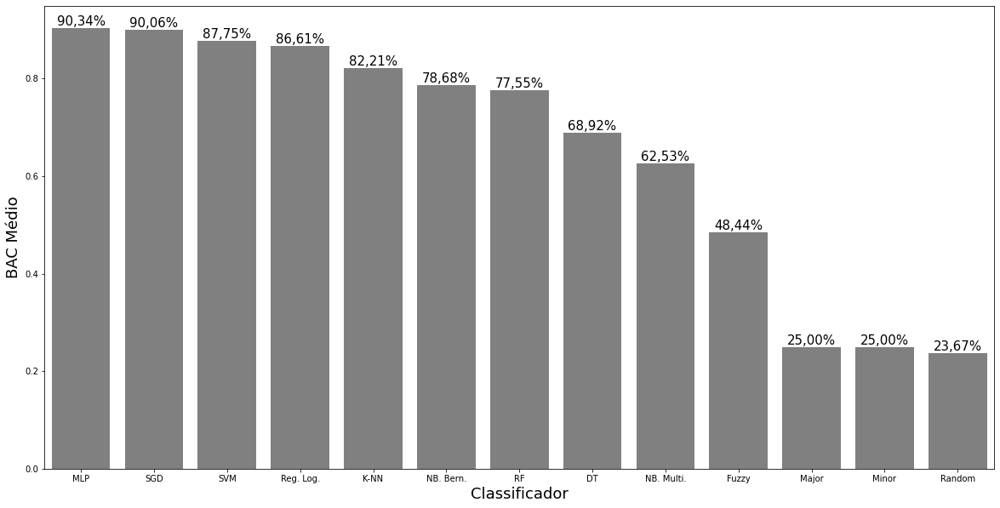

In [270]:
# Apresentando o resultado da acurácia balanceada dos modelos conforme as médias obtidas em boxplots
plt.figure(figsize=(20, 10))

labels = ['{:,.2%}'.format(x).replace('.', ',') for x in all_classifiers_mean_ranking]

ax = sns.barplot(x="Algoritmo", y="Acurácia Balanceada", data=df_all_classifiers_despivot_hcv, order=all_best_classifiers_desc_hcv, estimator=np.mean, ci=0, color='grey')
# ax.bar_label(ax.containers[0], size=15)
ax.bar_label(ax.containers[0], labels=labels, size=15)

plt.ylabel('BAC Médio', size=18)
plt.xlabel('Classificador', size=18)
plt.show()

In [271]:
# Salvando os desempenhos dos classificadores num arquivo CSV
df_all_classifiers_despivot_hcv.rename(columns={'Algoritmo': 'algoritmo', 'Acurácia Balanceada': 'acuracia_balanceada'}).to_csv('classifiers_cv.csv', index=False)

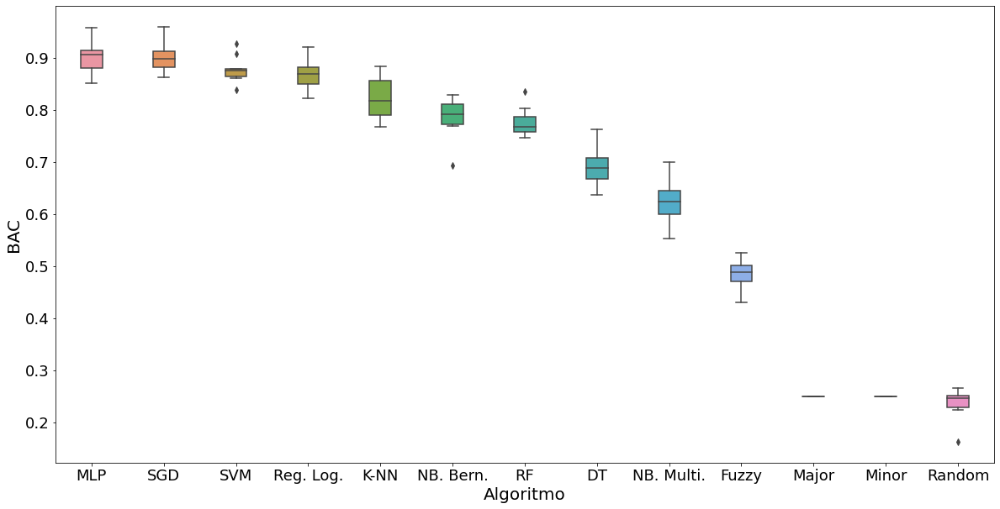

In [272]:
# Apresentando o resultado da acurácia balanceada dos modelos conforme as médias obtidas em boxplots
plt.figure(figsize=(20, 10))

ax = sns.boxplot(x="Algoritmo", y="Acurácia Balanceada", data=df_all_classifiers_despivot_hcv, width=0.3)

ax.set_xticklabels(df_all_classifiers_despivot_hcv['Algoritmo'].value_counts().index, size=18)
ax.set_yticklabels(ax.get_yticks().astype(float).round(1), size=18)

plt.xlabel('Algoritmo', size=20)
plt.ylabel('BAC', size=20)
plt.show()

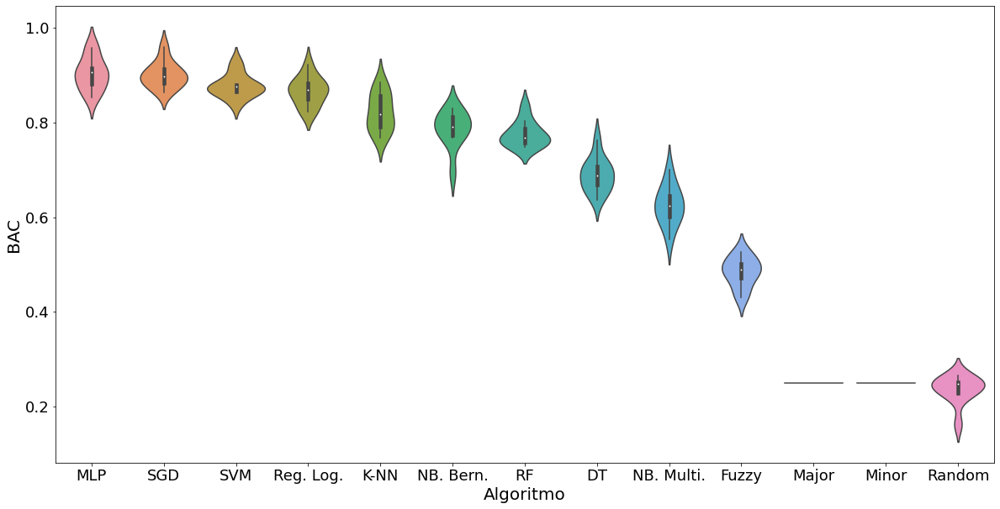

In [273]:
# Apresentando o resultado da acurácia balanceada dos modelos conforme as médias obtidas em gráficos de violino
plt.figure(figsize=(20, 10))

ax = sns.violinplot(x="Algoritmo", y="Acurácia Balanceada", data=df_all_classifiers_despivot_hcv, width=0.8)

# ax.bar_label(ax.containers[0], labels=labels, size=25)

ax.set_xticklabels(df_all_classifiers_despivot_hcv['Algoritmo'].value_counts().index, size=18)
ax.set_yticklabels(ax.get_yticks().astype(float).round(1), size=18)

plt.xlabel('Algoritmo', size=20)
plt.ylabel('BAC', size=20)
plt.show()

### Testes Estatísticos

In [274]:
# Avaliando uma possível equivalência entre distribuições dos classificadores através do teste estatística de Wilcoxon
# Adaptado de: https://machinelearningmastery.com/nonparametric-statistical-significance-tests-in-python/

n = df_all_classifiers_hcv.shape[0] # número de classificadores
classifiers_values = df_all_classifiers_hcv.values # resultados obtidos durante a validação cruzada
alpha = 0.05 # grau de significância: 5%

p_values_classifiers_hcv = []
same_distribution_classifiers_hcv = []

for i in range(n):
    p_values_classifier_i = []
    same_distribution_classifier_i = []
    for j in range(n):
        # compare samples
        if i == j or (np.std(classifiers_values[i]) == 0 or np.std(classifiers_values[j]) == 0):
            # Caso os classificadores sejam os mesmos ou um deles tenho desvio padrão igual a zero, é forçado um p-valor maior que a significância para indicar a equivalência entre os mesmos
            p = alpha + 0.01
        else:
            stat, p = wilcoxon(classifiers_values[i], classifiers_values[j])
            # print('Statistics=%.3f, p=%.3f' % (stat, p))
        
        p_values_classifier_i.append(p)
        
        # Interpretando os resultados do teste
        if p > alpha:
            # print('Mesma distribuição (falah ao rejeitar o H0)')
            same_distribution_classifier_i.append(1)
        else:
            # print('Distribuição diferente (rejeitar o H0)')
            same_distribution_classifier_i.append(0)
        
    p_values_classifiers_hcv.append(p_values_classifier_i)
    same_distribution_classifiers_hcv.append(same_distribution_classifier_i)

In [275]:
# Criando uma tabela cruzada entre p-valores obtidos
df_all_classifiers_p_values_hcv = pd.DataFrame(p_values_classifiers_hcv, columns=all_classifiers_desc_hcv, index=all_classifiers_desc_hcv)

df_all_classifiers_p_values_hcv

,K-NN,Reg. Log.,SGD,NB. Bern.,NB. Multi.,SVM,DT,RF,MLP,Fuzzy,Random,Major,Minor
K-NN,0.060000,0.005859,0.001953,0.064453,0.001953,0.001953,0.001953,0.019531,0.001953,0.001953,0.001953,0.06,0.06
Reg. Log.,0.005859,0.060000,0.005859,0.001953,0.001953,0.064453,0.001953,0.001953,0.013672,0.001953,0.001953,0.06,0.06
SGD,0.001953,0.005859,0.060000,0.001953,0.001953,0.003906,0.001953,0.001953,0.769531,0.001953,0.001953,0.06,0.06
NB. Bern.,0.064453,0.001953,0.001953,0.060000,0.001953,0.001953,0.003906,0.322266,0.001953,0.001953,0.001953,0.06,0.06
NB. Multi.,0.001953,0.001953,0.001953,0.001953,0.060000,0.001953,0.013672,0.001953,0.001953,0.001953,0.001953,0.06,0.06
SVM,0.001953,0.064453,0.003906,0.001953,0.001953,0.060000,0.001953,0.001953,0.005859,0.001953,0.001953,0.06,0.06
DT,0.001953,0.001953,0.001953,0.003906,0.013672,0.001953,0.060000,0.001953,0.001953,0.001953,0.001953,0.06,0.06
RF,0.019531,0.001953,0.001953,0.322266,0.001953,0.001953,0.001953,0.060000,0.001953,0.001953,0.001953,0.06,0.06
MLP,0.001953,0.013672,0.769531,0.001953,0.001953,0.005859,0.001953,0.001953,0.060000,0.001953,0.001953,0.06,0.06
Fuzzy,0.001953,0.001953,0.001953,0.001953,0.001953,0.001953,0.001953,0.001953,0.001953,0.060000,0.001953,0.06,0.06


In [276]:
df_all_classifiers_same_distribution_hcv = pd.DataFrame(same_distribution_classifiers_hcv, columns=all_classifiers_desc_hcv, index=all_classifiers_desc_hcv)

df_all_classifiers_same_distribution_hcv

,K-NN,Reg. Log.,SGD,NB. Bern.,NB. Multi.,SVM,DT,RF,MLP,Fuzzy,Random,Major,Minor
K-NN,1,0,0,1,0,0,0,0,0,0,0,1,1
Reg. Log.,0,1,0,0,0,1,0,0,0,0,0,1,1
SGD,0,0,1,0,0,0,0,0,1,0,0,1,1
NB. Bern.,1,0,0,1,0,0,0,1,0,0,0,1,1
NB. Multi.,0,0,0,0,1,0,0,0,0,0,0,1,1
SVM,0,1,0,0,0,1,0,0,0,0,0,1,1
DT,0,0,0,0,0,0,1,0,0,0,0,1,1
RF,0,0,0,1,0,0,0,1,0,0,0,1,1
MLP,0,0,1,0,0,0,0,0,1,0,0,1,1
Fuzzy,0,0,0,0,0,0,0,0,0,1,0,1,1


In [277]:
columns_p_values = df_all_classifiers_p_values_hcv.columns

for index, column in enumerate(columns_p_values):
    if (df_all_classifiers_p_values_hcv[column] != df_all_classifiers_p_values_hcv[column][0]).sum() == 0:
        df_all_classifiers_p_values_hcv.drop(column, axis=0, inplace=True)
        df_all_classifiers_p_values_hcv.drop(column, axis=1, inplace=True)
        df_all_classifiers_same_distribution_hcv.drop(column, axis=0, inplace=True)
        df_all_classifiers_same_distribution_hcv.drop(column, axis=1, inplace=True)

df_all_classifiers_p_values_hcv

,K-NN,Reg. Log.,SGD,NB. Bern.,NB. Multi.,SVM,DT,RF,MLP,Fuzzy,Random
K-NN,0.060000,0.005859,0.001953,0.064453,0.001953,0.001953,0.001953,0.019531,0.001953,0.001953,0.001953
Reg. Log.,0.005859,0.060000,0.005859,0.001953,0.001953,0.064453,0.001953,0.001953,0.013672,0.001953,0.001953
SGD,0.001953,0.005859,0.060000,0.001953,0.001953,0.003906,0.001953,0.001953,0.769531,0.001953,0.001953
NB. Bern.,0.064453,0.001953,0.001953,0.060000,0.001953,0.001953,0.003906,0.322266,0.001953,0.001953,0.001953
NB. Multi.,0.001953,0.001953,0.001953,0.001953,0.060000,0.001953,0.013672,0.001953,0.001953,0.001953,0.001953
SVM,0.001953,0.064453,0.003906,0.001953,0.001953,0.060000,0.001953,0.001953,0.005859,0.001953,0.001953
DT,0.001953,0.001953,0.001953,0.003906,0.013672,0.001953,0.060000,0.001953,0.001953,0.001953,0.001953
RF,0.019531,0.001953,0.001953,0.322266,0.001953,0.001953,0.001953,0.060000,0.001953,0.001953,0.001953
MLP,0.001953,0.013672,0.769531,0.001953,0.001953,0.005859,0.001953,0.001953,0.060000,0.001953,0.001953
Fuzzy,0.001953,0.001953,0.001953,0.001953,0.001953,0.001953,0.001953,0.001953,0.001953,0.060000,0.001953


In [278]:
same_distribution_classifiers_hcv = df_all_classifiers_best_hcv.values

same_distribution_classifiers_hcv

array([[0.86613973, 0.88072322, 0.90640368, 0.85218885, 0.91443627,
        0.95785271, 0.95554681, 0.91328245, 0.90604118, 0.88158518],
       [0.87877635, 0.86292173, 0.89833917, 0.87669865, 0.91795739,
        0.92295568, 0.95967742, 0.89194508, 0.89707653, 0.89994084],
       [0.8772619 , 0.86425899, 0.87881092, 0.83911159, 0.86635934,
        0.90823316, 0.92767679, 0.87742416, 0.86173271, 0.87460751],
       [0.87762783, 0.88439455, 0.84746975, 0.82440571, 0.85674396,
        0.88997322, 0.92132179, 0.86415131, 0.82232906, 0.87281325],
       [0.83596116, 0.80305484, 0.83117654, 0.76722878, 0.86318752,
        0.88429334, 0.86425028, 0.80088326, 0.78432401, 0.78681291],
       [0.76839286, 0.78443136, 0.69367342, 0.82311019, 0.80464606,
        0.79570806, 0.82895834, 0.81391609, 0.78622766, 0.76907835],
       [0.74727069, 0.83481168, 0.76534759, 0.75091131, 0.79048522,
        0.75690577, 0.8025404 , 0.77668971, 0.76993978, 0.75998869],
       [0.67535226, 0.66981352, 0.7105219

In [279]:
# Filtrando apenas o triângulo superior da tabela de p-valores
df_all_classifiers_p_values_diag_hcv = df_all_classifiers_p_values_hcv.where(np.triu(np.ones(df_all_classifiers_p_values_hcv.shape), k=1).astype(np.bool))

df_all_classifiers_p_values_diag_hcv

,K-NN,Reg. Log.,SGD,NB. Bern.,NB. Multi.,SVM,DT,RF,MLP,Fuzzy,Random
K-NN,NaN,0.005859,0.001953,0.064453,0.001953,0.001953,0.001953,0.019531,0.001953,0.001953,0.001953
Reg. Log.,NaN,NaN,0.005859,0.001953,0.001953,0.064453,0.001953,0.001953,0.013672,0.001953,0.001953
SGD,NaN,NaN,NaN,0.001953,0.001953,0.003906,0.001953,0.001953,0.769531,0.001953,0.001953
NB. Bern.,NaN,NaN,NaN,NaN,0.001953,0.001953,0.003906,0.322266,0.001953,0.001953,0.001953
NB. Multi.,NaN,NaN,NaN,NaN,NaN,0.001953,0.013672,0.001953,0.001953,0.001953,0.001953
SVM,NaN,NaN,NaN,NaN,NaN,NaN,0.001953,0.001953,0.005859,0.001953,0.001953
DT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.001953,0.001953,0.001953,0.001953
RF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.001953,0.001953,0.001953
MLP,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.001953,0.001953
Fuzzy,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.001953


In [280]:
# Filtrando apenas o triângulo superior da tabela de interpretação
df_all_classifiers_same_distribution_diag_hcv = df_all_classifiers_same_distribution_hcv.where(np.triu(np.ones(df_all_classifiers_same_distribution_hcv.shape), k=1).astype(np.bool))

df_all_classifiers_same_distribution_diag_hcv

,K-NN,Reg. Log.,SGD,NB. Bern.,NB. Multi.,SVM,DT,RF,MLP,Fuzzy,Random
K-NN,NaN,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Reg. Log.,NaN,NaN,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
SGD,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
NB. Bern.,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,0.0,0.0,0.0
NB. Multi.,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0
SVM,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0
DT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0
RF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0
MLP,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
Fuzzy,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0


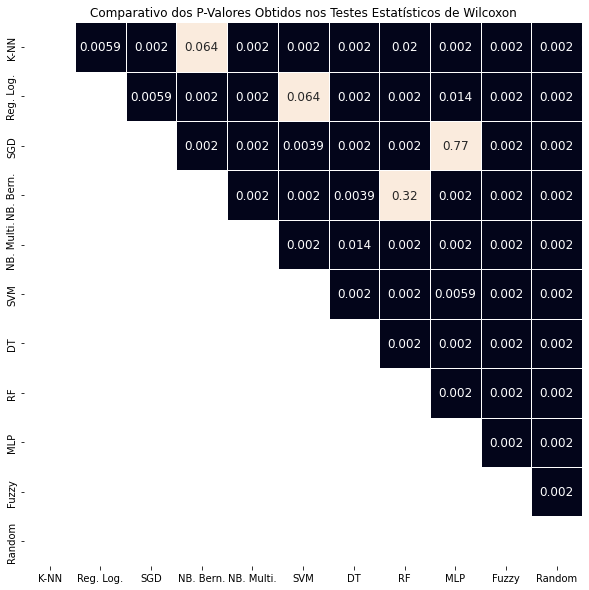

In [281]:
# Apresentando uma matriz de testes de Wilcoxon entre os classificadores
fig, ax = plt.subplots(1, 1, figsize=(10,10))
sns.heatmap(df_all_classifiers_same_distribution_diag_hcv, annot=df_all_classifiers_p_values_diag_hcv, linewidths=.5, cbar=False, annot_kws={"size": 12}, ax=ax)

ax.set_title('Comparativo dos P-Valores Obtidos nos Testes Estatísticos de Wilcoxon')
fig.savefig('classificadores_p-valores.png')

In [282]:
# Apresentando um relatório completo da classificação executada
classifiers_y_preds_hcv = [
    ('mlp', y_pred_mlp_test_hcv),
    ('sgd', y_pred_sgd_test_hcv),
    ('knn', y_pred_knn_test_hcv),
    ('fuzzy', y_pred_fuzzy_test_hcv),
    ('random', y_pred_random_test_hcv),
    ('major', y_pred_major_test_hcv),
    ('minor', y_pred_minor_test_hcv)
]

### Métricas do Relatório de Classificação

In [283]:
dict_predictions_precision_hcv ={}

for classifier, y_pred_test_classifier in classifiers_y_preds_hcv:
    dict_predictions_precision_hcv[classifier] = precision_score(y_test_hcv, y_pred_test_classifier, average=None)

df_predictions_precision_hcv = pd.DataFrame(dict_predictions_precision_hcv)

df_predictions_precision_hcv.columns.name = 'classifiers'
df_predictions_precision_hcv.index = classes
df_predictions_precision_hcv = df_predictions_precision_hcv.applymap(lambda n: '{:,.2%}'.format(n).replace('.', ','))
df_predictions_precision_hcv

classifiers,mlp,sgd,knn,fuzzy,random,major,minor
1_Ensino_Fundamental_I,"65,67%","58,18%","64,15%","47,06%","12,24%","0,00%","14,18%"
2_Ensino_Fundamental_II,"70,00%","49,30%","50,00%","69,57%","21,35%","0,00%","0,00%"
3_Ensino_Medio,"73,17%","75,22%","63,91%","71,79%","31,78%","0,00%","0,00%"
4_Ensino_Superior,"86,36%","83,62%","79,12%","53,80%","39,34%","39,90%","0,00%"


In [284]:
dict_predictions_recall_hcv ={}

for classifier, y_pred_test_classifier in classifiers_y_preds_hcv:
    dict_predictions_recall_hcv[classifier] = recall_score(y_test_hcv, y_pred_test_classifier, average=None)

df_predictions_recall_hcv = pd.DataFrame(dict_predictions_recall_hcv)

df_predictions_recall_hcv.columns.name = 'classifiers'
df_predictions_recall_hcv.index = classes
df_predictions_recall_hcv = df_predictions_recall_hcv.applymap(lambda n: '{:,.2%}'.format(n).replace('.', ',')) 
df_predictions_recall_hcv

classifiers,mlp,sgd,knn,fuzzy,random,major,minor
1_Ensino_Fundamental_I,"74,58%","54,24%","57,63%","40,68%","20,34%","0,00%","100,00%"
2_Ensino_Fundamental_II,"53,85%","53,85%","36,92%","24,62%","29,23%","0,00%","0,00%"
3_Ensino_Medio,"71,43%","67,46%","67,46%","22,22%","26,98%","0,00%","0,00%"
4_Ensino_Superior,"91,57%","89,16%","86,75%","98,19%","28,92%","100,00%","0,00%"


In [285]:
dict_predictions_f1_hcv ={}

for classifier, y_pred_test_classifier in classifiers_y_preds_hcv:
    dict_predictions_f1_hcv[classifier] = f1_score(y_test_hcv, y_pred_test_classifier, average=None)

df_predictions_f1_hcv = pd.DataFrame(dict_predictions_f1_hcv)

df_predictions_f1_hcv.columns.name = 'classifiers'
df_predictions_f1_hcv.index = classes
df_predictions_f1_hcv = df_predictions_f1_hcv.applymap(lambda n: '{:,.2%}'.format(n).replace('.', ',')) 
df_predictions_f1_hcv

classifiers,mlp,sgd,knn,fuzzy,random,major,minor
1_Ensino_Fundamental_I,"69,84%","56,14%","60,71%","43,64%","15,29%","0,00%","24,84%"
2_Ensino_Fundamental_II,"60,87%","51,47%","42,48%","36,36%","24,68%","0,00%","0,00%"
3_Ensino_Medio,"72,29%","71,13%","65,64%","33,94%","29,18%","0,00%","0,00%"
4_Ensino_Superior,"88,89%","86,30%","82,76%","69,51%","33,33%","57,04%","0,00%"


### Matrizes de Confusão

#### MLP x Fuzzy

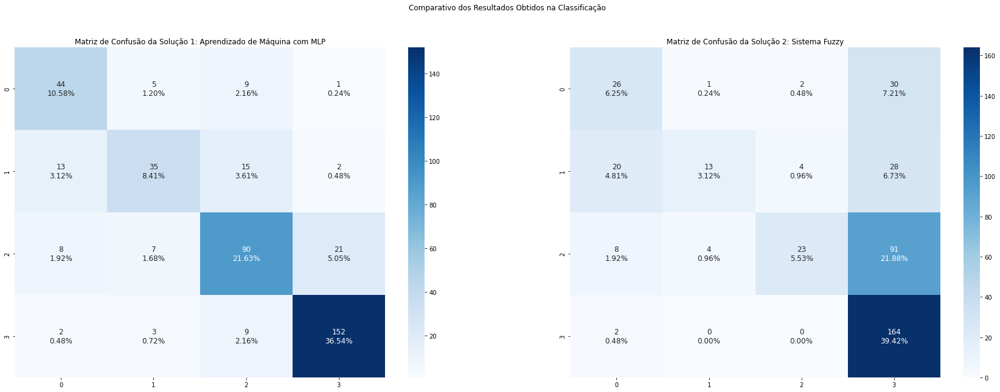

In [286]:
# Apresentando a matriz de confusão
num_classes = len(encoder.classes_)
group_counts_clf = ['{0:0.0f}'.format(value) for value in cf_matrix_clf_mlp_hcv.flatten()]
group_percentages_clf = ['{0:.2%}'.format(value) for value in cf_matrix_clf_mlp_hcv.flatten() / np.sum(cf_matrix_clf_mlp_hcv)]
labels_clf = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts_clf, group_percentages_clf)]
labels_clf = np.asarray(labels_clf).reshape(num_classes, num_classes)

group_counts_fuzzy = ['{0:0.0f}'.format(value) for value in cf_matrix_fuzzy_hcv.flatten()]
group_percentages_fuzzy = ['{0:.2%}'.format(value) for value in cf_matrix_fuzzy_hcv.flatten() / np.sum(cf_matrix_fuzzy_hcv)]
labels_fuzzy = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts_fuzzy, group_percentages_fuzzy)]
labels_fuzzy = np.asarray(labels_fuzzy).reshape(num_classes, num_classes)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(30,10))
sns.heatmap(cf_matrix_clf_mlp_hcv, annot=labels_clf, fmt='', cmap='Blues', annot_kws={"size": 12}, ax=ax1)
sns.heatmap(cf_matrix_fuzzy_hcv, annot=labels_fuzzy, fmt='', cmap='Blues', annot_kws={"size": 12}, ax=ax2)

fig.suptitle('Comparativo dos Resultados Obtidos na Classificação')
ax1.set_title('Matriz de Confusão da Solução 1: Aprendizado de Máquina com MLP')
ax2.set_title('Matriz de Confusão da Solução 2: Sistema Fuzzy')
fig.savefig('comparativo_solucoes_mlp_fuzzy.png')

#### K-NN x Fuzzy

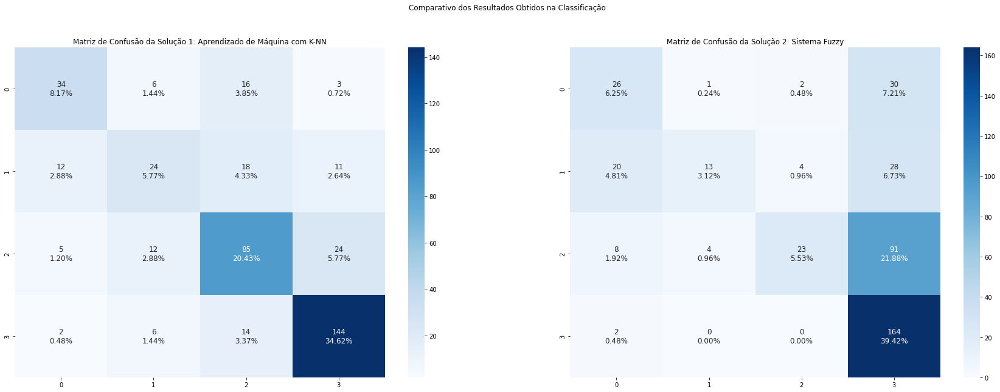

In [287]:
# Apresentando a matriz de confusão
num_classes = len(encoder.classes_)
group_counts_clf = ['{0:0.0f}'.format(value) for value in cf_matrix_clf_knn_hcv.flatten()]
group_percentages_clf = ['{0:.2%}'.format(value) for value in cf_matrix_clf_knn_hcv.flatten() / np.sum(cf_matrix_clf_knn_hcv)]
labels_clf = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts_clf, group_percentages_clf)]
labels_clf = np.asarray(labels_clf).reshape(num_classes, num_classes)

group_counts_fuzzy = ['{0:0.0f}'.format(value) for value in cf_matrix_fuzzy_hcv.flatten()]
group_percentages_fuzzy = ['{0:.2%}'.format(value) for value in cf_matrix_fuzzy_hcv.flatten() / np.sum(cf_matrix_fuzzy_hcv)]
labels_fuzzy = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts_fuzzy, group_percentages_fuzzy)]
labels_fuzzy = np.asarray(labels_fuzzy).reshape(num_classes, num_classes)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(30,10))
sns.heatmap(cf_matrix_clf_knn_hcv, annot=labels_clf, fmt='', cmap='Blues', annot_kws={"size": 12}, ax=ax1)
sns.heatmap(cf_matrix_fuzzy_hcv, annot=labels_fuzzy, fmt='', cmap='Blues', annot_kws={"size": 12}, ax=ax2)

fig.suptitle('Comparativo dos Resultados Obtidos na Classificação')
ax1.set_title('Matriz de Confusão da Solução 1: Aprendizado de Máquina com K-NN')
ax2.set_title('Matriz de Confusão da Solução 2: Sistema Fuzzy')
fig.savefig('comparativo_solucoes_knn_fuzzy.png')

#### SGD x Fuzzy

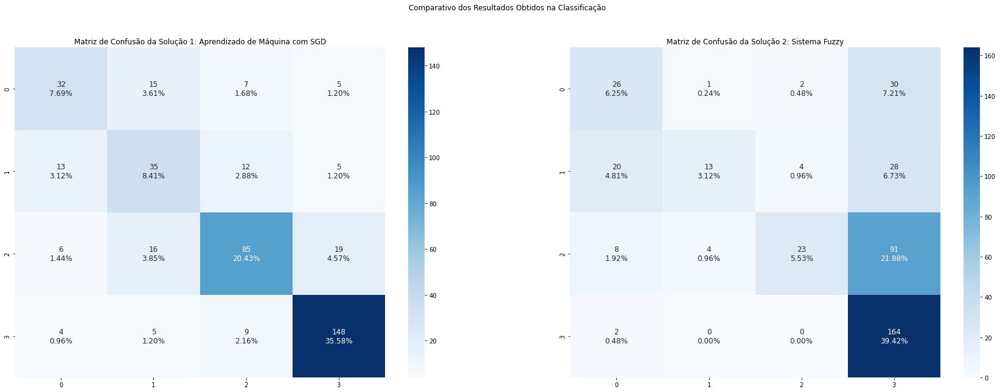

In [288]:
# Apresentando a matriz de confusão
num_classes = len(encoder.classes_)
group_counts_clf = ['{0:0.0f}'.format(value) for value in cf_matrix_clf_sgd_hcv.flatten()]
group_percentages_clf = ['{0:.2%}'.format(value) for value in cf_matrix_clf_sgd_hcv.flatten() / np.sum(cf_matrix_clf_sgd_hcv)]
labels_clf = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts_clf, group_percentages_clf)]
labels_clf = np.asarray(labels_clf).reshape(num_classes, num_classes)

group_counts_fuzzy = ['{0:0.0f}'.format(value) for value in cf_matrix_fuzzy_hcv.flatten()]
group_percentages_fuzzy = ['{0:.2%}'.format(value) for value in cf_matrix_fuzzy_hcv.flatten() / np.sum(cf_matrix_fuzzy_hcv)]
labels_fuzzy = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts_fuzzy, group_percentages_fuzzy)]
labels_fuzzy = np.asarray(labels_fuzzy).reshape(num_classes, num_classes)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(30,10))
sns.heatmap(cf_matrix_clf_sgd_hcv, annot=labels_clf, fmt='', cmap='Blues', annot_kws={"size": 12}, ax=ax1)
sns.heatmap(cf_matrix_fuzzy_hcv, annot=labels_fuzzy, fmt='', cmap='Blues', annot_kws={"size": 12}, ax=ax2)

fig.suptitle('Comparativo dos Resultados Obtidos na Classificação')
ax1.set_title('Matriz de Confusão da Solução 1: Aprendizado de Máquina com SGD')
ax2.set_title('Matriz de Confusão da Solução 2: Sistema Fuzzy')
fig.savefig('comparativo_solucoes_sgd_fuzzy.png')

MLP x K-NN x SGD x Fuzzy

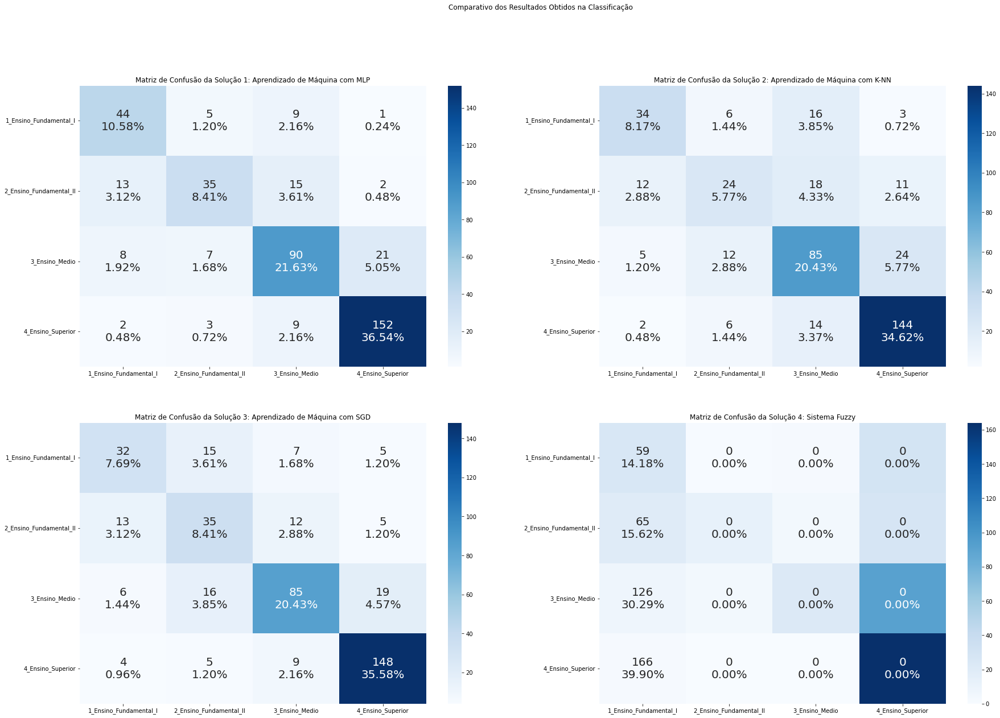

In [289]:
# Apresentando a matriz de confusão
num_classes = len(encoder.classes_)

group_counts_clf_mlp = ['{0:0.0f}'.format(value) for value in cf_matrix_clf_mlp_hcv.flatten()]
group_percentages_clf_mlp = ['{0:.2%}'.format(value) for value in cf_matrix_clf_mlp_hcv.flatten() / np.sum(cf_matrix_clf_mlp_hcv)]
labels_clf_mlp = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts_clf_mlp, group_percentages_clf_mlp)]
labels_clf_mlp = np.asarray(labels_clf_mlp).reshape(num_classes, num_classes)

group_counts_clf_knn = ['{0:0.0f}'.format(value) for value in cf_matrix_clf_knn_hcv.flatten()]
group_percentages_clf_knn = ['{0:.2%}'.format(value) for value in cf_matrix_clf_knn_hcv.flatten() / np.sum(cf_matrix_clf_knn_hcv)]
labels_clf_knn = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts_clf_knn, group_percentages_clf_knn)]
labels_clf_knn = np.asarray(labels_clf_knn).reshape(num_classes, num_classes)

group_counts_clf_sgd = ['{0:0.0f}'.format(value) for value in cf_matrix_clf_sgd_hcv.flatten()]
group_percentages_clf_sgd = ['{0:.2%}'.format(value) for value in cf_matrix_clf_sgd_hcv.flatten() / np.sum(cf_matrix_clf_sgd_hcv)]
labels_clf_sgd = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts_clf_sgd, group_percentages_clf_sgd)]
labels_clf_sgd = np.asarray(labels_clf_sgd).reshape(num_classes, num_classes)

group_counts_fuzzy = ['{0:0.0f}'.format(value) for value in cf_matrix_fuzzy_hcv.flatten()]
group_percentages_fuzzy = ['{0:.2%}'.format(value) for value in cf_matrix_fuzzy_hcv.flatten() / np.sum(cf_matrix_fuzzy_hcv)]
labels_fuzzy = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts,group_percentages)]
labels_fuzzy = np.asarray(labels_fuzzy).reshape(num_classes, num_classes)

fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(30, 20))
sns.heatmap(df_cf_matrix_clf_mlp_hcv, annot=labels_clf_mlp, fmt='', cmap='Blues', annot_kws={"size": 20}, ax=ax1)
sns.heatmap(df_cf_matrix_clf_knn_hcv, annot=labels_clf_knn, fmt='', cmap='Blues', annot_kws={"size": 20}, ax=ax2)
sns.heatmap(df_cf_matrix_clf_sgd_hcv, annot=labels_clf_sgd, fmt='', cmap='Blues', annot_kws={"size": 20}, ax=ax3)
sns.heatmap(df_cf_matrix_fuzzy_hcv, annot=labels_fuzzy, fmt='', cmap='Blues', annot_kws={"size": 20}, ax=ax4)

fig.suptitle('Comparativo dos Resultados Obtidos na Classificação')
ax1.set_title('Matriz de Confusão da Solução 1: Aprendizado de Máquina com MLP')
ax2.set_title('Matriz de Confusão da Solução 2: Aprendizado de Máquina com K-NN')
ax3.set_title('Matriz de Confusão da Solução 3: Aprendizado de Máquina com SGD')
ax4.set_title('Matriz de Confusão da Solução 4: Sistema Fuzzy')
fig.savefig('comparativo_solucoes_todas.png')

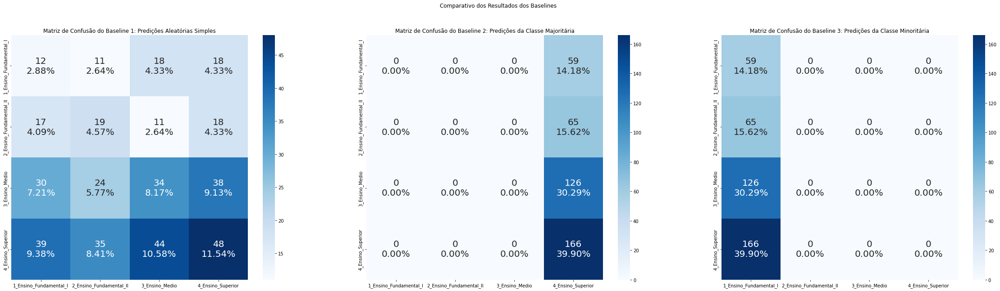

In [290]:
# Apresentando a matriz de confusão
num_classes = len(encoder.classes_)

group_counts_random = ['{0:0.0f}'.format(value) for value in cf_matrix_random_hcv.flatten()]
group_percentages_random = ['{0:.2%}'.format(value) for value in cf_matrix_random_hcv.flatten() / np.sum(cf_matrix_random_hcv)]
labels_random = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts_random, group_percentages_random)]
labels_random = np.asarray(labels_random).reshape(num_classes, num_classes)

group_counts_major = ['{0:0.0f}'.format(value) for value in cf_matrix_major_hcv.flatten()]
group_percentages_major = ['{0:.2%}'.format(value) for value in cf_matrix_major_hcv.flatten() / np.sum(cf_matrix_major_hcv)]
labels_major = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts_major, group_percentages_major)]
labels_major = np.asarray(labels_major).reshape(num_classes, num_classes)

group_counts_minor = ['{0:0.0f}'.format(value) for value in cf_matrix_minor_hcv.flatten()]
group_percentages_minor = ['{0:.2%}'.format(value) for value in cf_matrix_minor_hcv.flatten() / np.sum(cf_matrix_minor_hcv)]
labels_minor = [f'{v1}\n{v2}' for v1, v2 in zip(group_counts_minor, group_percentages_minor)]
labels_minor = np.asarray(labels_minor).reshape(num_classes, num_classes)

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(40, 10))
sns.heatmap(df_cf_matrix_random_hcv, annot=labels_random, fmt='', cmap='Blues', annot_kws={"size": 20}, ax=ax1)
sns.heatmap(df_cf_matrix_major_hcv, annot=labels_major, fmt='', cmap='Blues', annot_kws={"size": 20}, ax=ax2)
sns.heatmap(df_cf_matrix_minor_hcv, annot=labels_minor, fmt='', cmap='Blues', annot_kws={"size": 20}, ax=ax3)

fig.suptitle('Comparativo dos Resultados dos Baselines')
ax1.set_title('Matriz de Confusão do Baseline 1: Predições Aleatórias Simples')
ax2.set_title('Matriz de Confusão do Baseline 2: Predições da Classe Majoritária')
ax3.set_title('Matriz de Confusão do Baseline 3: Predições da Classe Minoritária')
fig.savefig('comparativo_solucoes_baselines.png')

## Referências

- FABIEN, Mael. A Guide to Hyperparameter Optimization (HPO): Parameters and Model Optimization. Disponível em: https://maelfabien.github.io/machinelearning/Explorium4/. Último acesso em: 15/09/2021. Github, 2019.

- GOULARTE, Fábio B. Método fuzzy para a sumarização automática de texto com base em um modelo extrativo (FSumm): Universidade Federal de Santa Catarina (UFSC). Florianópolis, SC: UFSC, 2015.

- KAGGLE. 7 topic data for text classification. Disponível em: https://www.kaggle.com/deepak711/4-subject-data-text-classification. Último acesso em: 15/09/2021.

- MATPLOLIB. Visualization with Python. Disponível em: https://matplotlib.org/. Último acesso em: 15/09/2021.

- NUMPY. The fundamental package for scientific computing with Python. Disponível em: https://numpy.org/. Último acesso em: 15/09/2021.

- PANDAS. Data Manipulation in Python. Disponível em: https://pandas.pydata.org/. Último acesso em: 15/09/2021.

- PTONSKI, Piotr. Extract Rules from Decision Tree in 3 Ways with Scikit-Learn and Python. Disponível em: https://mljar.com/blog/extract-rules-decision-tree/. Último acesso em: 15/09/2021.

- RASCHKA, Sebastian; MIRJALILI, Vahid. Python Machine Learning, 2ª Edição. PacktPub, 2017.

- SCACCIA, Kevin. Validação Cruzada Aninhada com Scikit-learn: Produzindo Estimativas mais Robustas da Capacidade de Generalização de um Modelo
. Disponível em: https://dataml.com.br/validacao-cruzada-aninhada-com-scikit-learn/. Último acesso em: 15/09/2021. DataML, 2020.

- SCIKIT-FUZZY. Collection of Fuzzy Logic Algorithms. Disponível em: https://pythonhosted.org/scikit-fuzzy/overview.html. Último acesso em: 15/09/2021.

- SCIKIT-LEARN. Machine Learning in Python. Disponível em: https://scikit-learn.org/stable/index.html. Último acesso em: 15/09/2021.

- SEABORN. statistical data visualization. Disponível em: https://seaborn.pydata.org/. Último acesso em: 15/09/2021.

- WHORTON, Casey. Pipeline For Text Data Pre-processing. Disponível em: https://towardsdatascience.com/pipeline-for-text-data-pre-processing-a9887b4e2db3. Último acesso em: 15/09/2021.

- YADAV, Dinesh. NLP: Building Text Cleanup and PreProcessing Pipeline. Disponível em: https://towardsdatascience.com/nlp-building-text-cleanup-and-preprocessing-pipeline-eba4095245a0. Último acesso em: 15/09/2021.